In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import math
import pandas as pd
#import uproot
import uproot3
from scipy import optimize as op
import scipy.integrate as integrate

In [2]:
#Gain access to functions used to change some of the aspects regarding arrays and the things in them
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Bin\ Conversions.ipynb

#Gain Access to functions used to work with momentum binning
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Momentum\ Bins.ipynb

#Gain Access to functions used to work with Fitting Functions
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Fitting\ Functions.ipynb

#Gain Access to functions used for TH2s 
#uproot or uproo4
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions-uproot3.ipynb
#uproot3
#%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH1\ Functions-uproot3.ipynb

#Gain Access to functions for taking discrete derivatives of lists of data
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Derivatives.ipynb

*Bin Conversions*
Available Functions:
Note: All functions return new arrays rather than altering the previous array
	New_Merged_Size(array_,merge_size_) returns what the size of the new merged array will be
	Merge_Bin_Edges(edges_,merge_size) merges the bin edges 
	Merge_Bins(array_,merge_size_) adds together every <merge_size_> values in an array
	Merge_Vals(yarray_,merge_size_) adds together every <merge_size_> ybin together in an array
	Merge_Bins(xarray_,merge_size_) averages every <merge_size_> xbins together in an array
	Count_Non_Zero(array_) counts the number of nonzero values in an array
	Count_Zero(array_) counts the number of zeros in an array
	Remove_Zeros(array_) remove zeros from an array
	Remove_Zeros_Y(yarray_) removes zero values from yarray
	Remove_Zeros_X(xarray_,yarray_) removes xbins where the corresponding y value was zero
	Count_InBounds(yarray_,low_,high_) counts the number of values that fall between bounds (or equal to)
	Count_OutBounds(yarray_,low_,high_) co

In [3]:
date="05-29-2024"
dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/"+date
#dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/"+date+"/cc"
#dir="/Users/cmc/analysis_phd/root_files/local_runs/e16/target"
#root_file=dir+"/analysis_full_e16_geo_fid.root"


species="ele"
detector="ec"
cut="pid"

root_file=dir+"/sim_e16_clas6_fid_geo_"+detector+"_"+species+"_"+date+".root"
file=uproot3.open(root_file)

sector_names = ["sec1","sec2","sec3","sec4","sec5","sec6","all"]
side = ["left","coinc","right","All"]
num_cc_seg = 18
num_cc_side = 3
num_sc_pad = 48
#0-> pid | 1->event selection all



In [4]:
layer1="Geometric Distributions"
layer2="Geo Fid "+species
layer3=layer2+" "+detector
layer4=[layer3+" "+sector_names[sec] for sec in range(7)]
layer5=[layer4[sec]+" "+cut for sec in range(7)]

    

In [5]:
hist_idx_len = len(file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[0]+"/"+layer5[0]].keys())

hist = [[file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[sec]+"/"+layer5[sec]][file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[sec]+"/"+layer5[sec]].keys()[2*hist_idx]] for hist_idx in range(round(hist_idx_len/2))] for sec in range(7)]


cut_hist_len = round(hist_idx_len/4)

In [6]:
def x_idx(xarray_, xval_):
    for i in range(len(xarray_)):
        if xarray_[i] <= xval_:
            if xarray_[i+1] >= xval_:
                return i
    return -1

def y_idx(yarray_, yval_):
    for i in range(len(yarray_)):
        if yarray_[i] <= yval_:
            if yarray_[i+1] >= yval_:
                return i
    return -1

In [7]:
#For cut only
def side_idx(hist_idx_):
    if hist_idx_ < num_cc_seg*3:
        if hist_idx_ < num_cc_seg:
            return 0
        elif hist_idx < num_cc_seg*2:
            return 1
        else:
            return 2
    elif hist_idx_ <= num_cc_seg*3+3:
        return hist_idx_ - (num_cc_seg*3)

def seg_idx(hist_idx_):
    if hist_idx_ < num_cc_seg*3:
        if hist_idx_ < num_cc_seg:
            return hist_idx_
        elif hist_idx < num_cc_seg*2:
            return hist_idx_ - num_cc_seg
        else:
            return hist_idx_ - num_cc_seg*2
    elif hist_idx_ <= num_cc_seg*3+3:
        return _num_cc_seg
    
def pad_idx(hist_idx_):
    if hist_idx_ <= _num_sc_pad:
        return hist_idx_ 
    else:
        return -1
    
def cc_hist_idx(side_, seg_):
    if side_ == 3:
        if seg_ == num_cc_seg:
            return cut_hist_len-1
        else:
            return -1
    else:
        if seg_ == num_cc_seg:
            return num_cc_seg*3 + side_
        else:
            return num_cc_seg*side_ + seg_


In [33]:
#Look at Overall Distributions
xdim_len = len(Center_Xbins(hist[0][0]))
ydim_len = len(Center_Ybins(hist[0][0]))

x_merge = 2
y_merge = 2


xvals = Merge_Bins(Center_Xbins(hist[0][0]),x_merge)
yvals = Merge_Bins(Center_Ybins(hist[0][0]),y_merge)
zvals_xy = [[Merge_Z(XY_Values(hist[sec][hist_idx]),x_merge,y_merge) for hist_idx in range(cut_hist_len)] for sec in range(7)]
zvals_yx = [[Merge_Z(YX_Values(hist[sec][hist_idx]),y_merge,x_merge) for hist_idx in range(cut_hist_len)] for sec in range(7)]



In [34]:
xdim = len(xvals)
ydim = len(yvals)

xres = xvals[1]-xvals[0]
yres = yvals[1]-yvals[0]

def shift_idx(x_shift_):
    return round(x_shift_/xres)

In [35]:
dumb1_x= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y= np.zeros((7,cut_hist_len,xdim*ydim))
dense1 = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y= np.zeros((7,cut_hist_len,xdim*ydim))
dense2 = np.zeros((7,cut_hist_len,xdim*ydim))
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for hist_idx in range(cut_hist_len):
                dumb1_x[sec][hist_idx][i+j*xdim]+=xvals[i]
                dumb1_y[sec][hist_idx][i+j*xdim]+=yvals[j]
                dense1[sec][hist_idx][i+j*xdim]+=zvals_xy[sec][hist_idx][i][j]
                dumb2_x[sec][hist_idx][j+i*ydim]+=yvals[j]
                dumb2_y[sec][hist_idx][j+i*ydim]+=xvals[i]
                dense2[sec][hist_idx][j+i*ydim]+=zvals_yx[sec][hist_idx][j][i]


In [36]:
def Linear(x_, a_, b_):
    return a_ + b_*x_

def super_gaus_cut_bound(frac_,side_,a_,m_,s_,p_):
    if side_ == 0:
        return 0.5*(2*m_ - 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
    elif side_ ==1:
        return 0.5*(2*m_ + 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
    else:
        return -99.9
    

def Sup_Gaus_Cutoff(x_,frac_,a_,m_,s_,p_):
    if x < super_gaus_cut_bound(frac_,0,a_,m_,s_,p_):
        return 0.
    elif x > super_gaus_cut_bound(frac_,1,a_,m_,s_,p_):
        return 0.
    else:
        return Super_Gaus(x_,a_,m_,s_,p_)
    
def Sup_Gaus_Cutoff_Array(x_,frac_,a_,m_,s_,p_):
    output = np.zeros(len(x_))
    for i in range(len(x_)):
        output[i] = Sup_Gaus_Cutoff(x_[i],frac_,a_,m_,s_,p_)
    return output

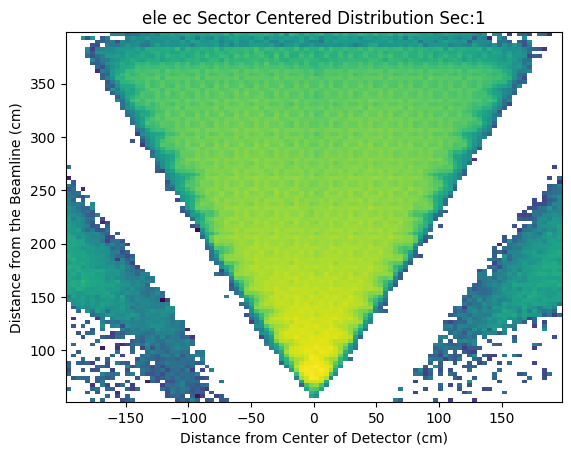

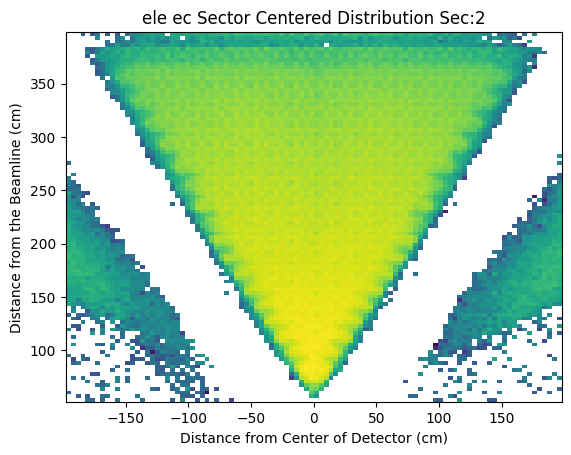

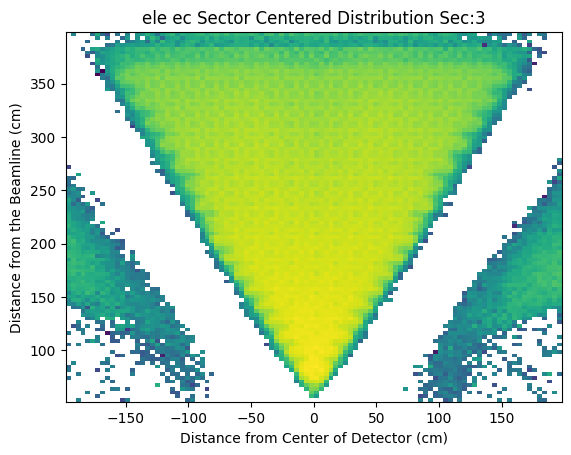

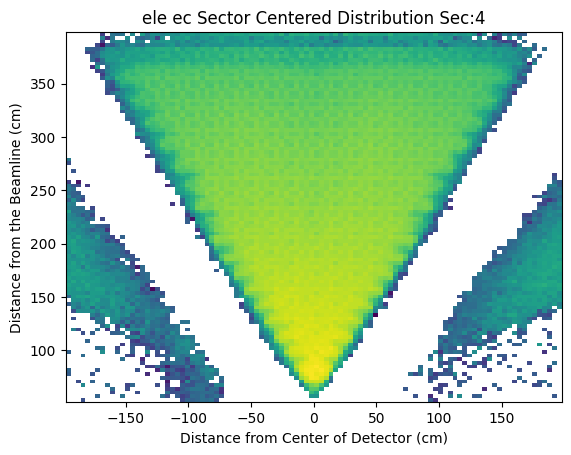

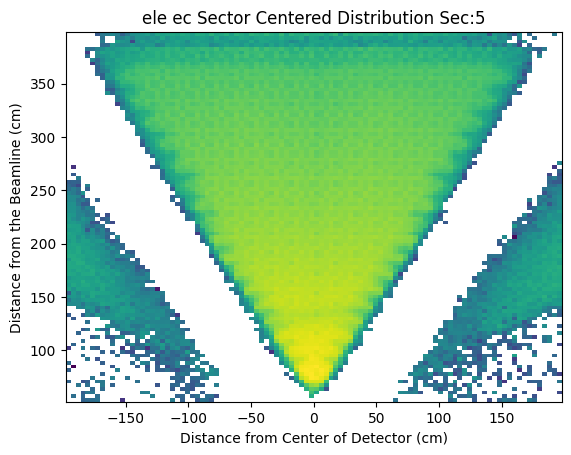

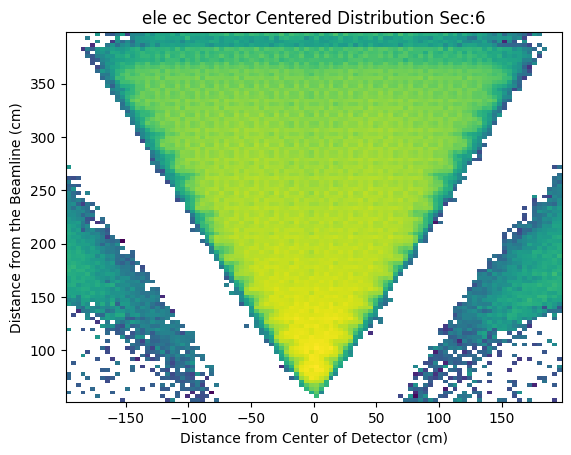

In [37]:
for sec in range(6):
    plt.hist2d(dumb1_x[sec][cut_hist_len-1], dumb1_y[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    plt.title(species+" "+detector+" Sector Centered Distribution Sec:{}".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

In [38]:
print(yvals[27])
print(yvals[140])

146.25


IndexError: index 140 is out of bounds for axis 0 with size 100

In [39]:
idx1 = 29
idx2=89
fit_len = idx2-idx1
yidx = [idx1+i for i in range(fit_len)]

xrange = [[-50-i*(yvals[idx2]-yvals[idx1])/(fit_len),50+i*(yvals[idx2]-yvals[idx1])/(fit_len)] for i in range(fit_len)]

#x_points = np.zeros()

right_rot = [3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2)]
left_rot = [3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2)]



[144.15841349  -0.162102    28.25820166   5.49182722]


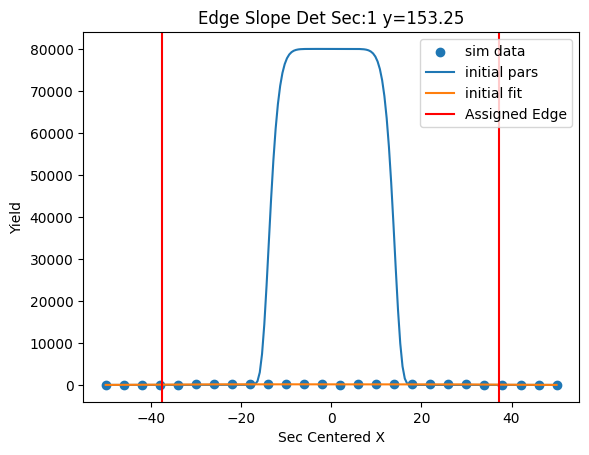

[164.70689081   0.27294374  35.08038643   4.52884802]


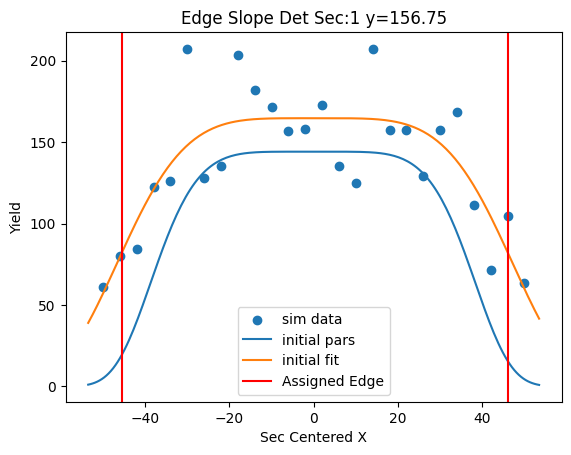

[ 1.16082769e+02 -8.00858487e-02  3.44572407e+01  9.24192885e+00]


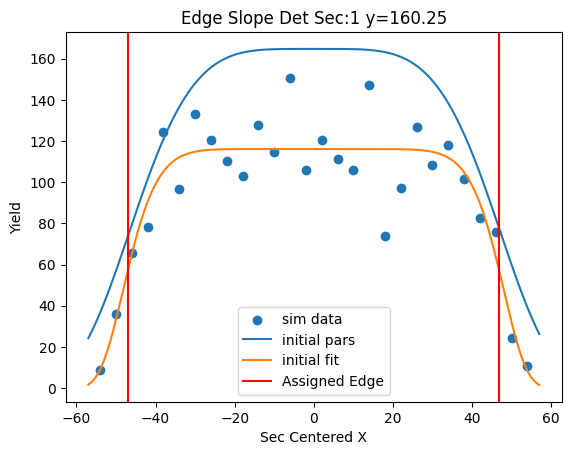

[119.1961287   -0.57686526  33.91237864  10.93574449]


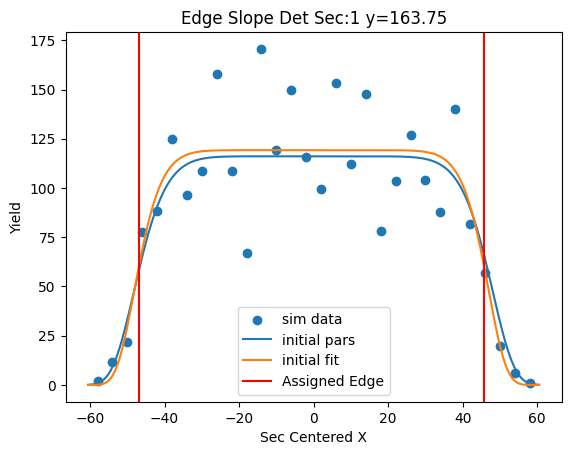

[121.90192818  -0.67364895  34.19520739   6.82433645]


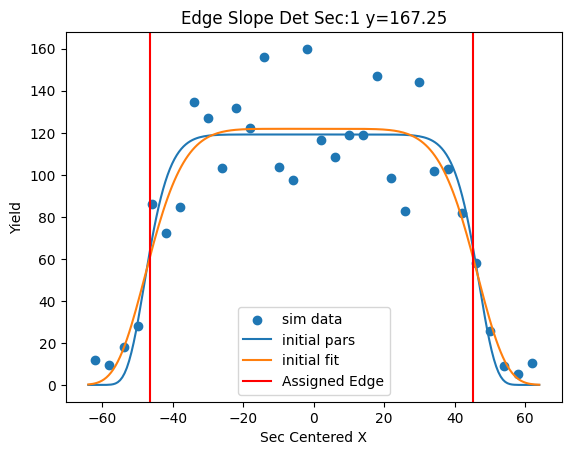

[101.52931098  -1.8188329   39.48317758   4.62180397]


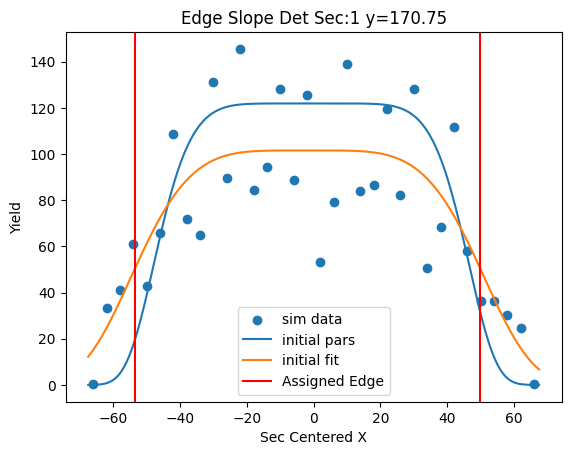

[89.12330579 -0.90258556 41.2728012  10.33625699]


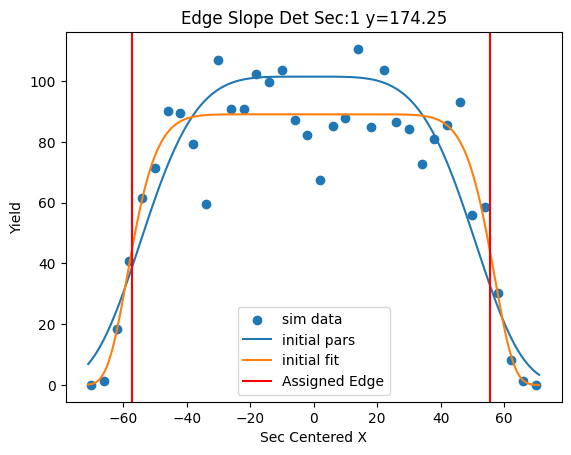

[101.92940003  -0.55089826  40.88959813  10.40532767]


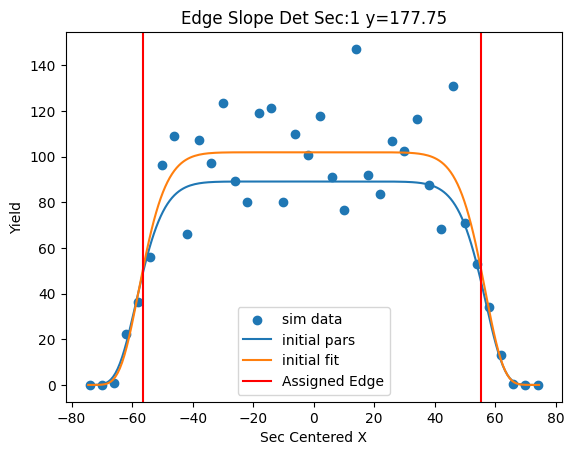

[77.43106815 -0.78813409 40.00225315  9.42217903]


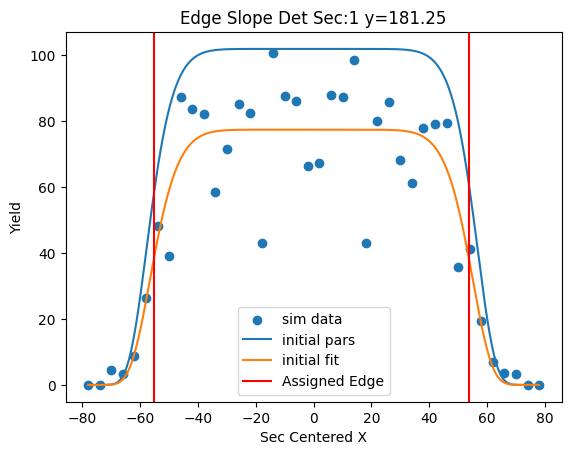

[89.72761825 -0.8485219  44.33763333  5.64100929]


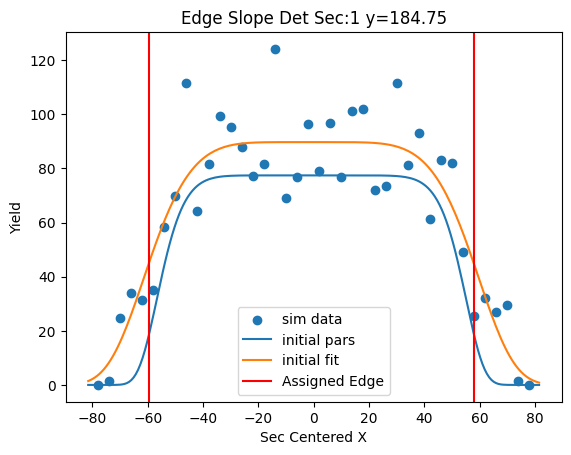

[66.43427881 -0.68344836 47.05948535  8.13494707]


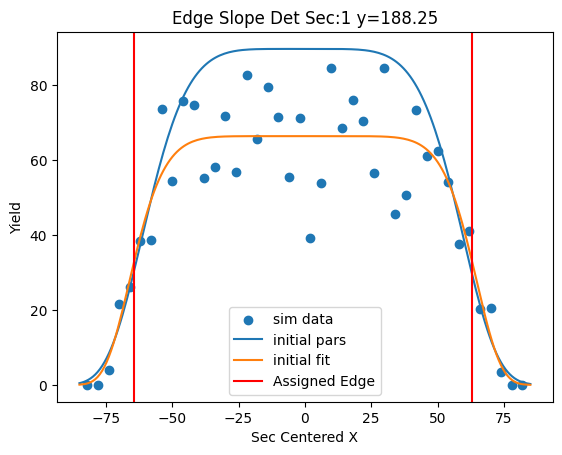

[66.01222172 -0.5231948  44.78060856 15.50626006]


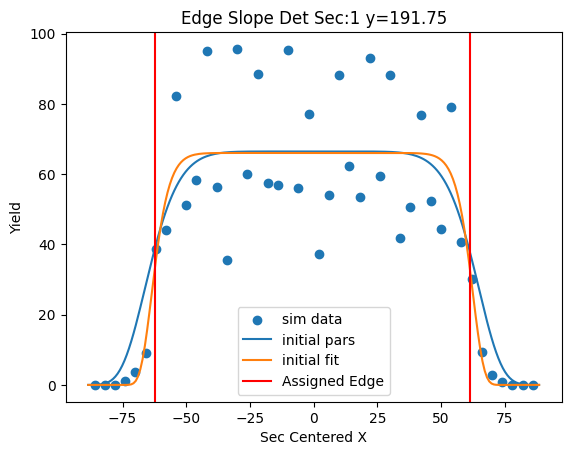

[70.3725208  -0.29817777 44.30604846 11.47123348]


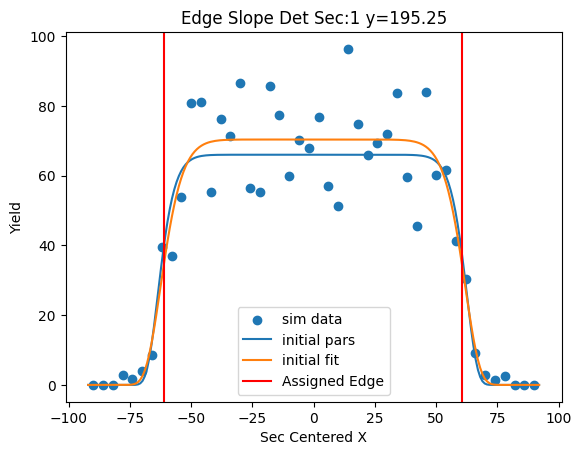

[57.01390967 -0.98488553 47.37220582  7.69601387]


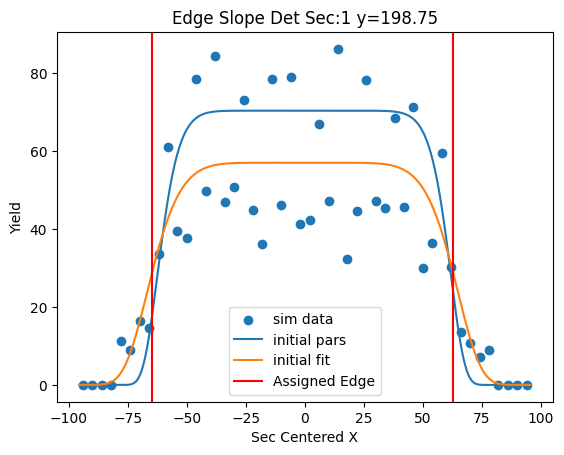

[51.01950436 -0.70484478 53.12420274  6.56148852]


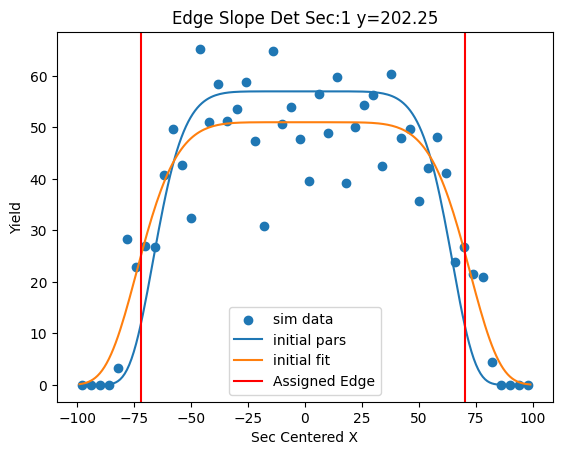

[62.86904628 -0.4096027  54.44431493  9.12919503]


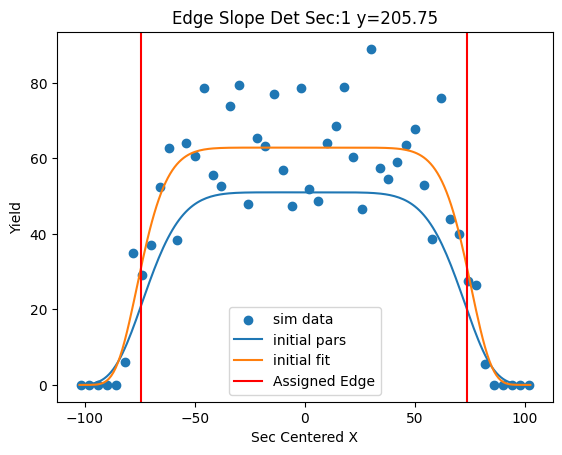

[43.44343961 -0.5169807  51.1219914  10.8712184 ]


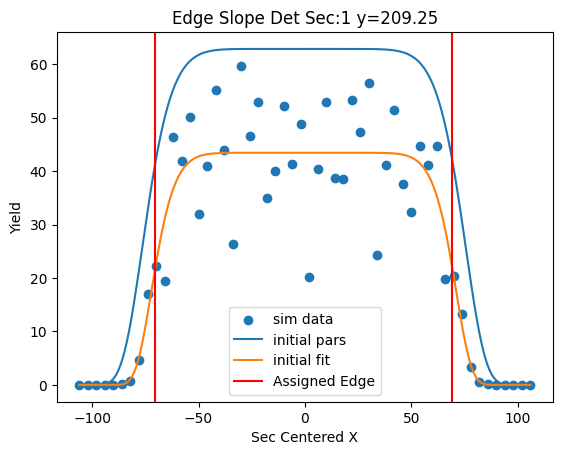

[52.34262801  0.13377284 53.55641517  9.79557676]


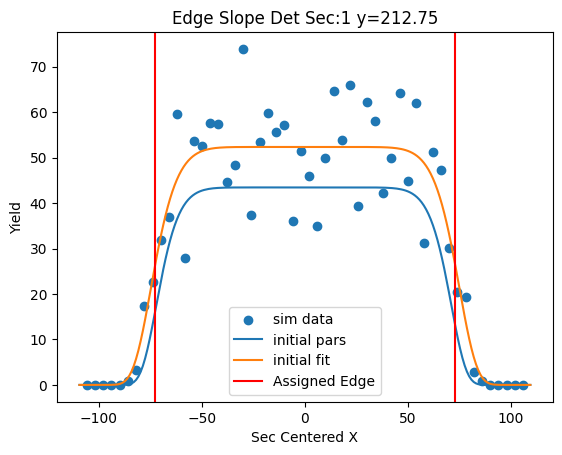

[41.36156326 -0.15144139 54.61979544 12.91972005]


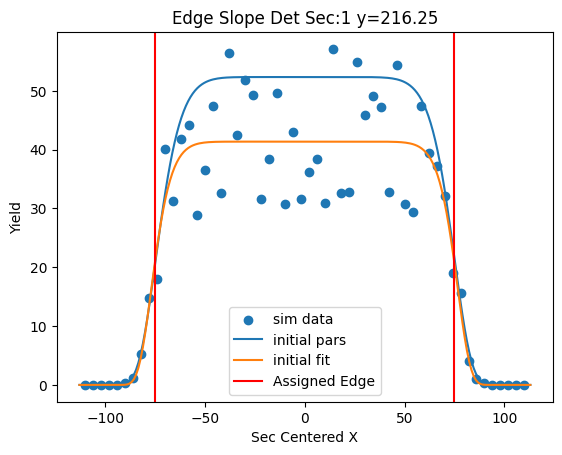

[40.83972836 -0.17714702 55.03489003 12.42425661]


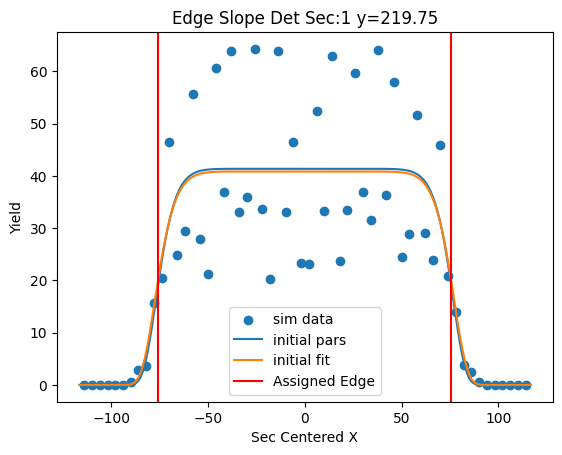

[43.36073443  0.34407285 55.85615285 10.41236635]


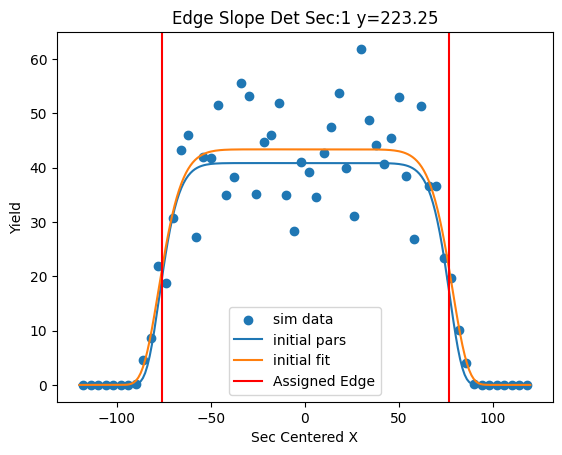

[35.06771295  0.12491006 53.62386147 10.48562207]


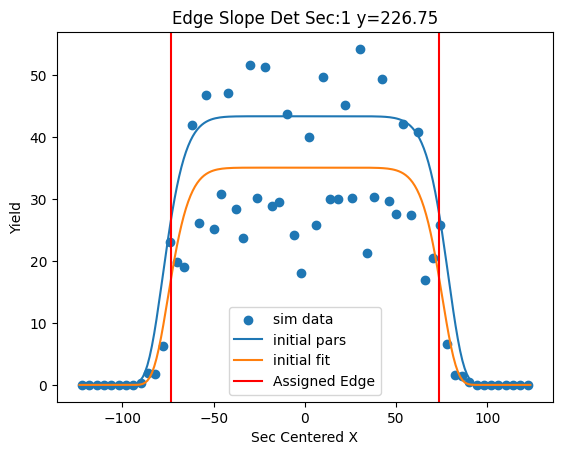

[32.03452755  0.6313271  54.59791183 11.36220864]


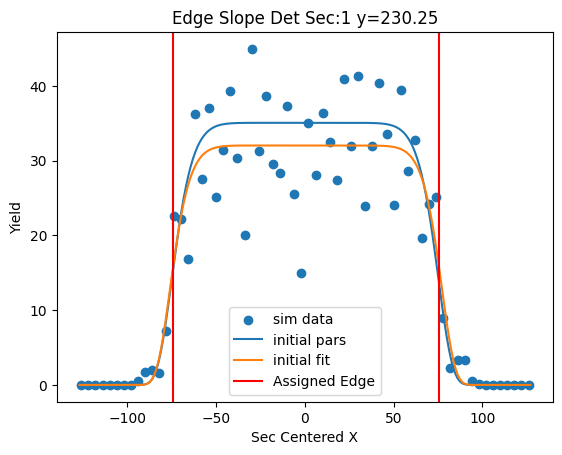

[41.33090218  1.67595177 58.43469076  7.99754421]


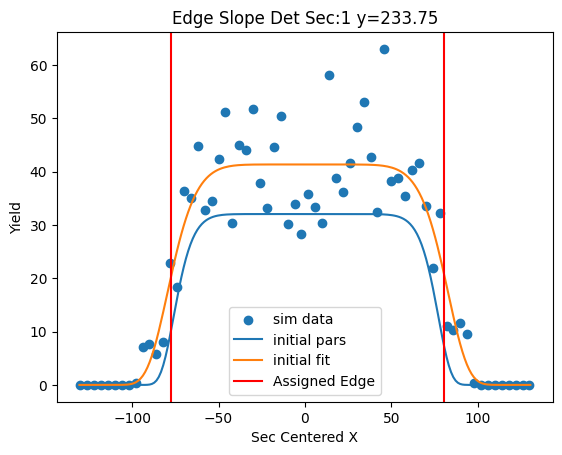

[26.41001932  0.90083214 62.51489569  8.27704827]


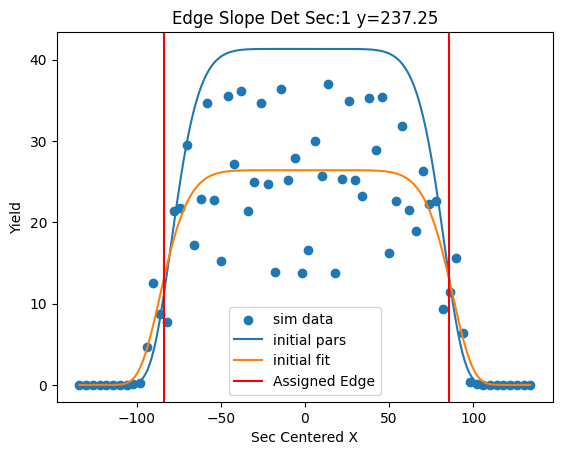

[30.15016832  0.80077402 62.02359822 11.44979309]


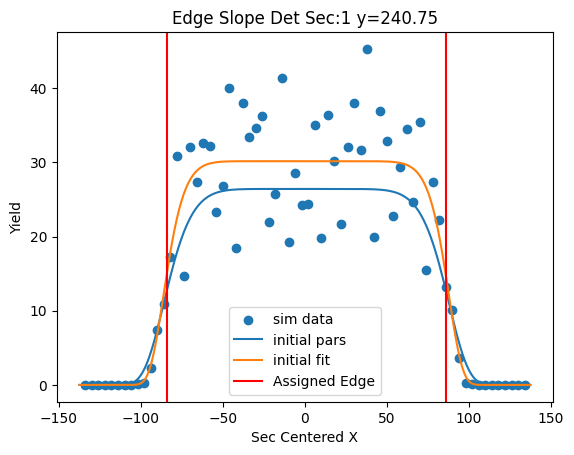

[27.31107144  0.52643075 61.18057105 13.32554982]


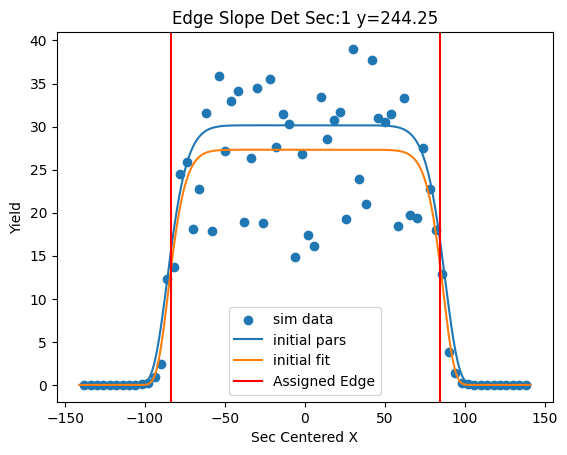

[26.84726618  0.10213762 63.63862319  9.3769802 ]


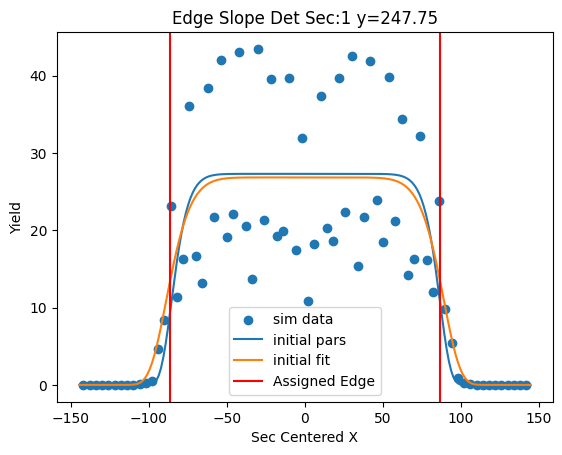

[26.92354027  0.86505703 65.31666777 11.64540494]


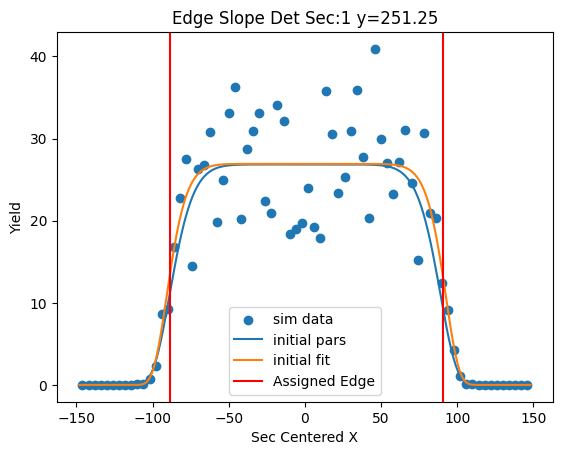

[20.85002229  0.20657386 65.7906007   9.6178216 ]


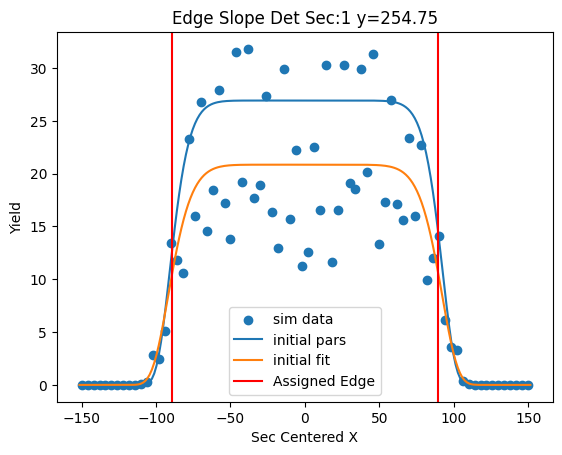

[20.27886068  0.41858924 66.49168506 10.54111666]


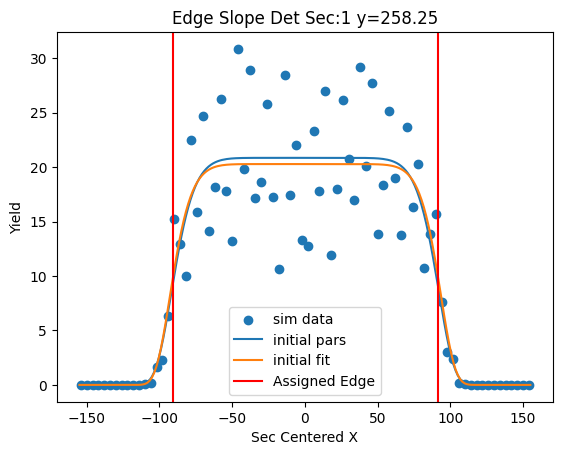

[27.37386103  0.50351543 64.65776803 12.81502922]


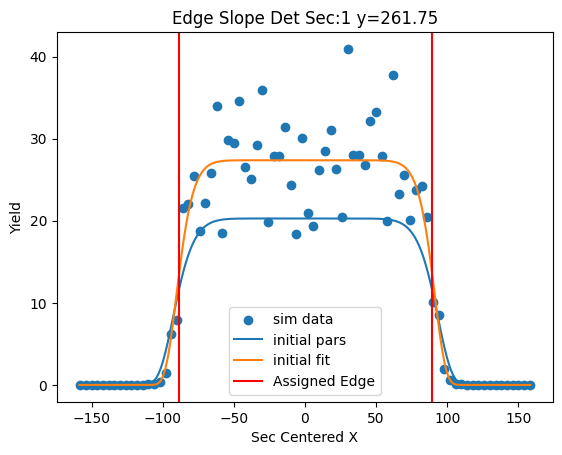

[17.59973238 -0.28494688 63.90763564 12.16328598]


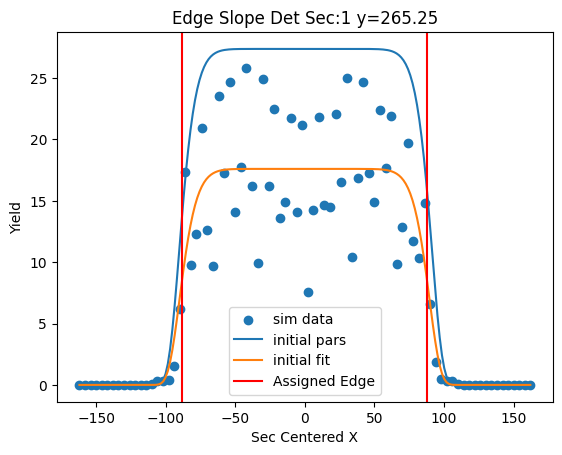

[19.50601656  0.24915954 66.09378776 11.72032132]


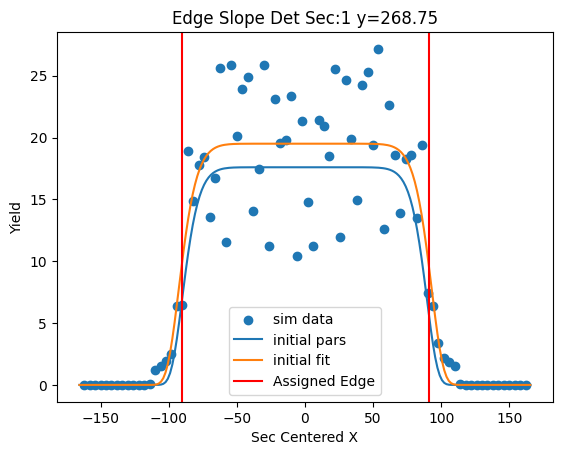

[18.48161268  0.52089018 69.74639501  7.93364546]


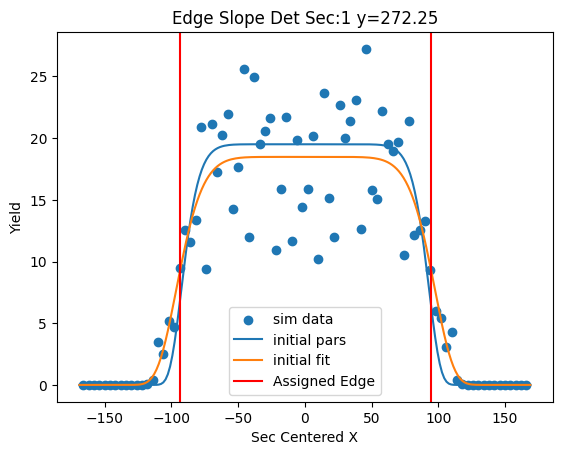

[14.71551182 -0.30983487 72.56258684  7.47055478]


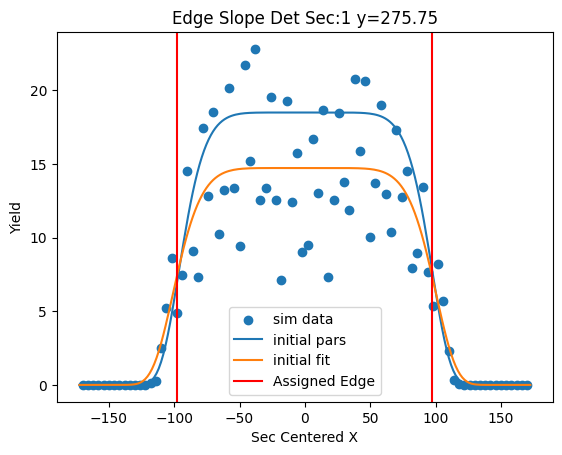

[19.70214193  0.40372514 73.64351117 10.89768665]


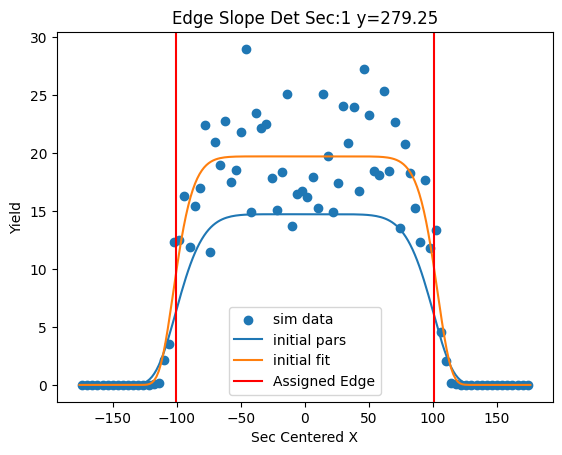

[14.101671   -0.4961765  72.78827895  9.2328432 ]


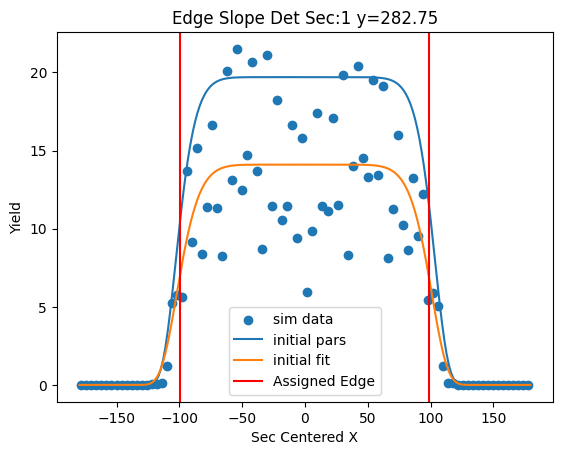

[13.65785094 -0.33071003 73.6782544   9.73214769]


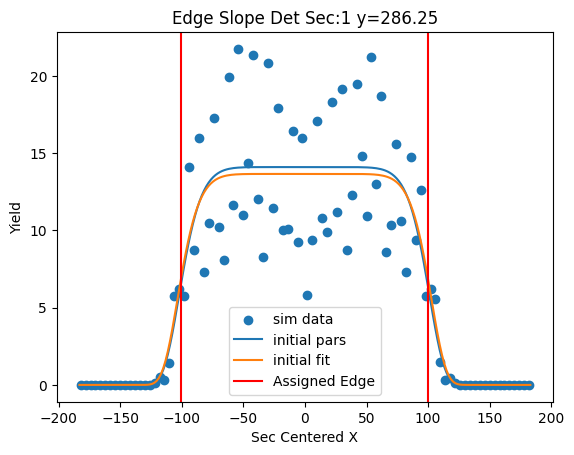

[15.37716533  0.69898877 75.42133514  8.98688105]


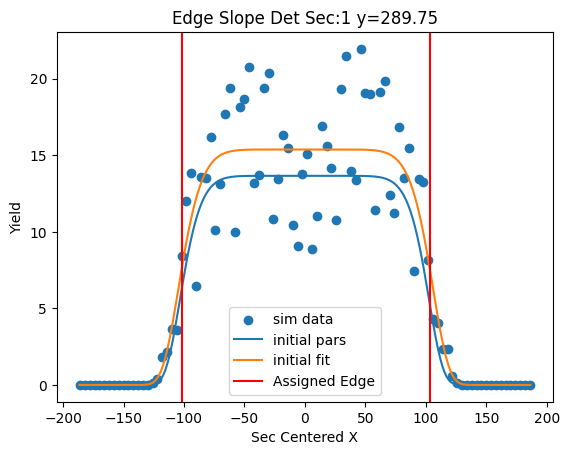

[13.17436938 -0.83357712 77.60576034  6.63938768]


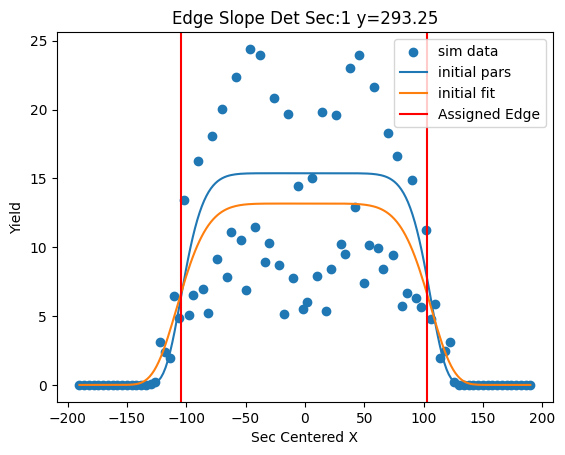

[12.09216311  0.45824218 79.8660097   7.40058127]


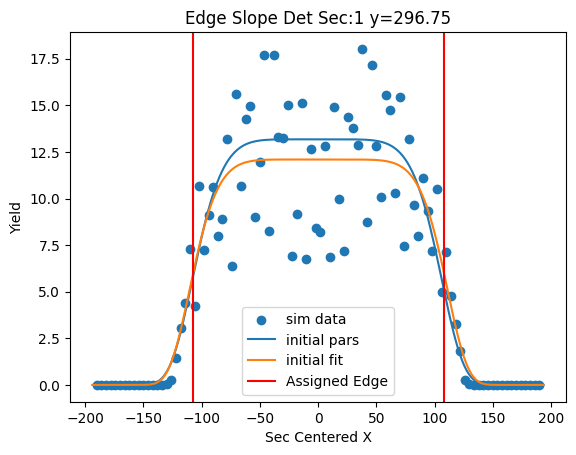

[12.47527784  0.23695679 79.75899496  8.24535394]


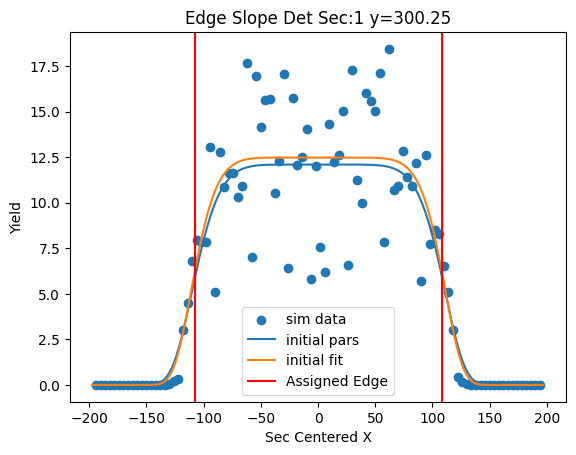

[ 9.4021045  -0.76822575 77.22673061  8.25600176]


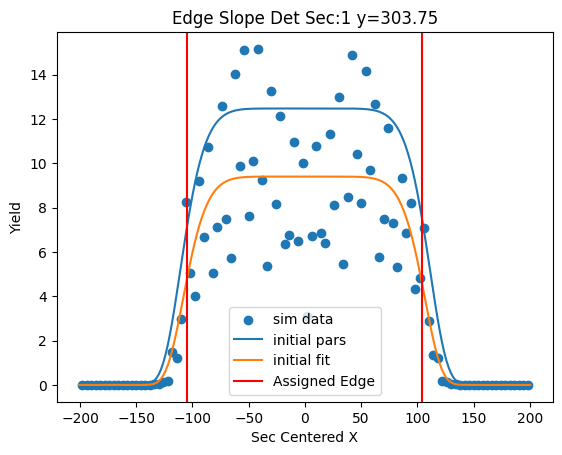

[13.24228393  0.34446929 79.74398615  7.92245116]


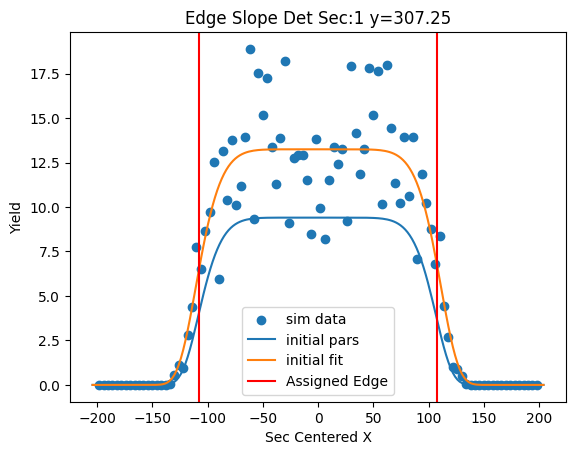

[ 8.73858969 -1.23051052 82.40017798  6.62723697]


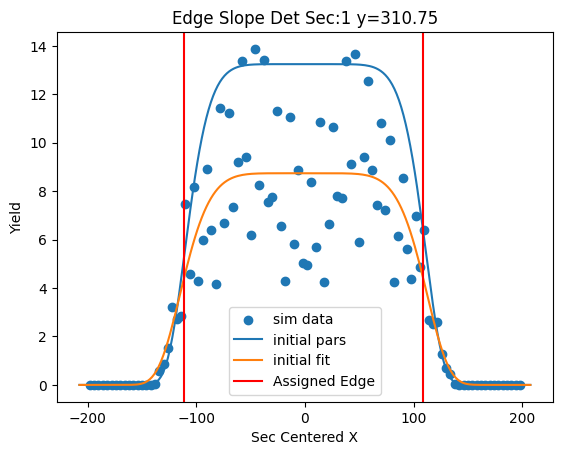

[ 8.83147202 -1.66861375 84.01827769  6.02914986]


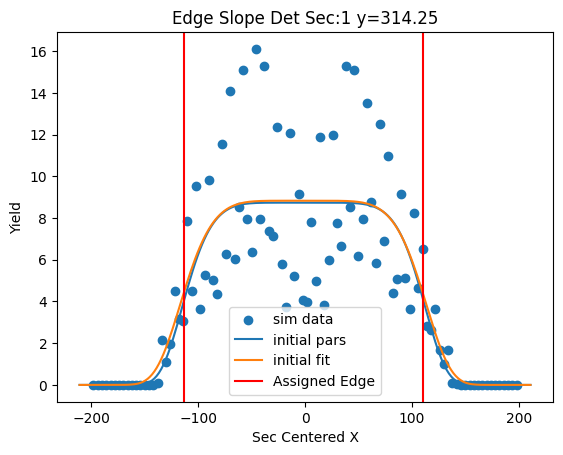

[ 9.45524696  0.4830643  86.41889967  6.75232938]


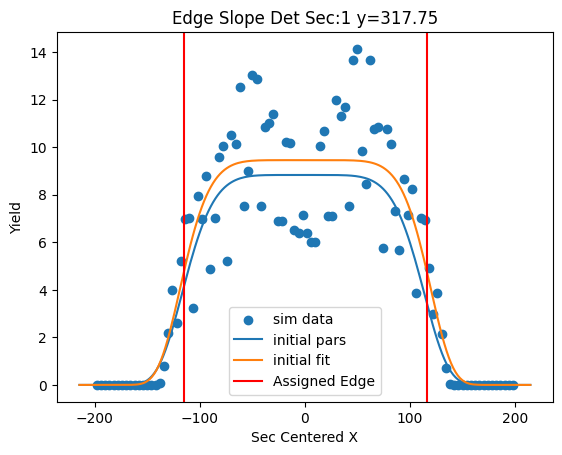

[ 8.47809803 -1.34503217 84.95442249  6.40030441]


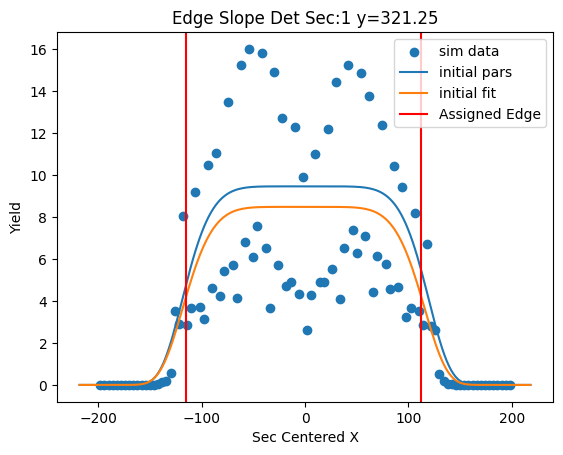

[ 6.94400711e+00 -6.99805847e-02  8.52621907e+01  7.77321473e+00]


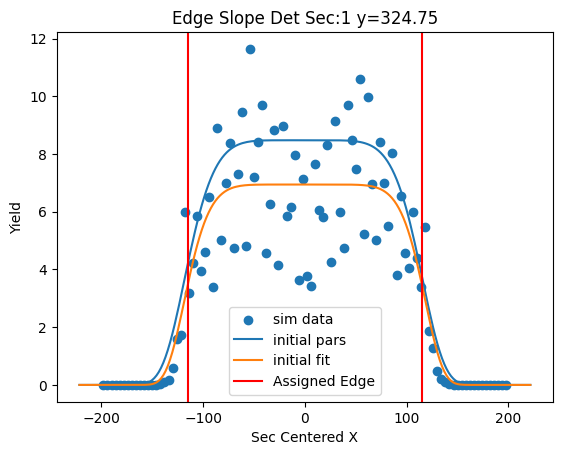

[ 7.99310783  0.13504799 86.70209116  7.30030586]


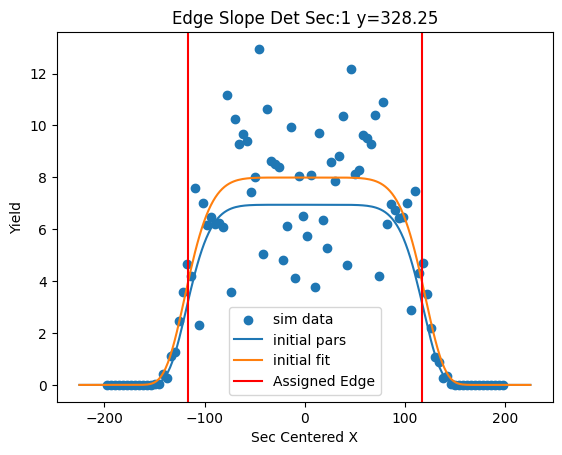

[ 5.48706306 -2.20803791 89.98367359  6.49606812]


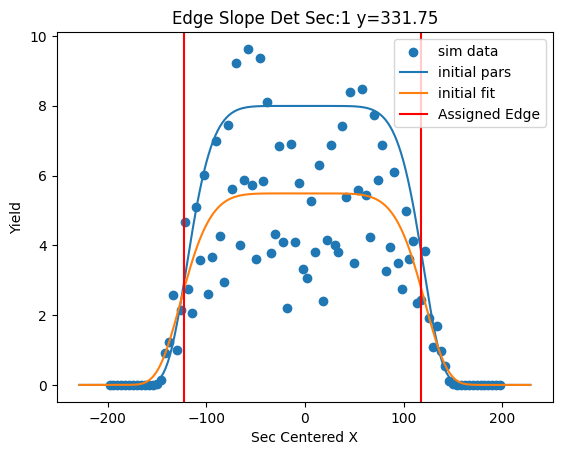

[ 7.70063666 -0.1157932  92.07369869  6.35628812]


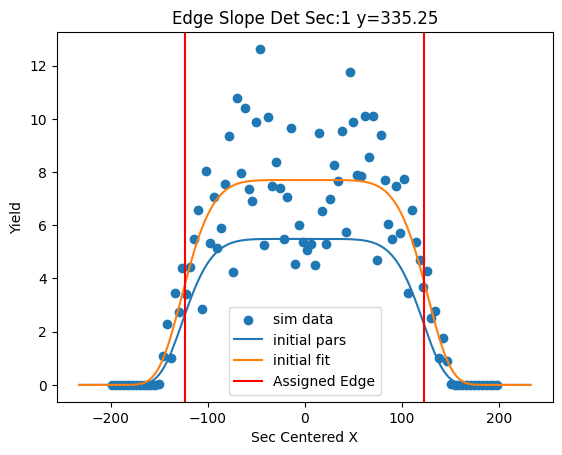

[ 5.09662224 -0.84493321 91.89142848  5.90163546]


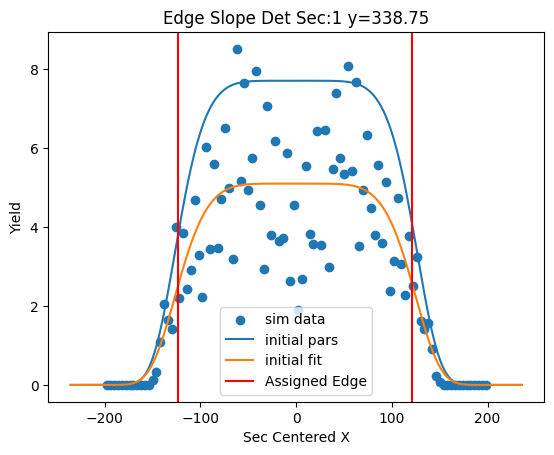

[ 5.32574436 -1.70885876 91.97262849  6.14250835]


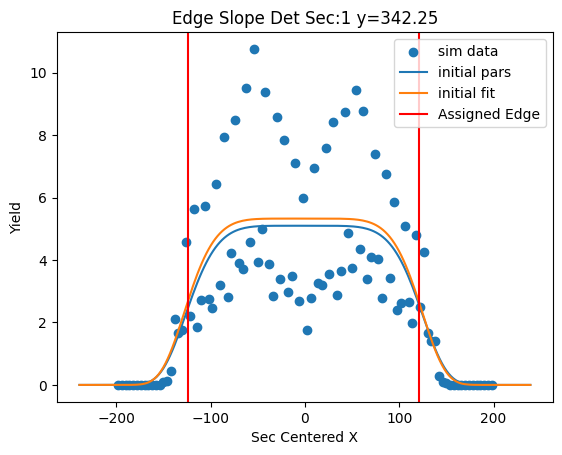

[ 4.80667545  0.6740578  95.02767303  9.96741117]


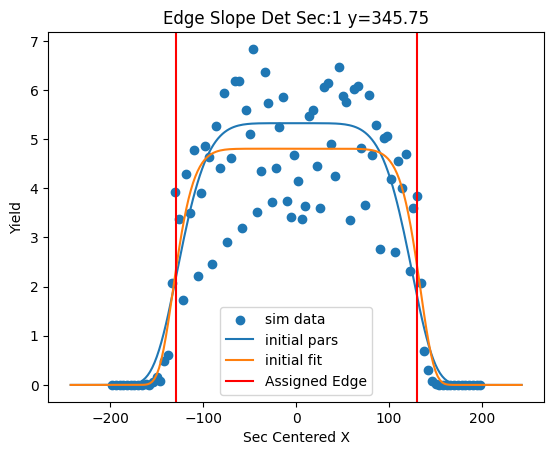

[ 4.17727876 -1.53211204 95.70059679  6.82463729]


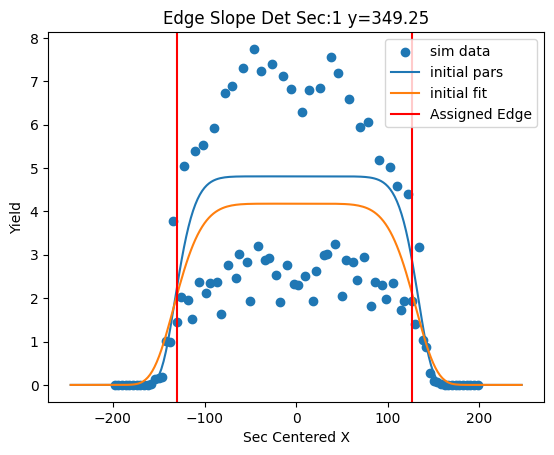

[ 3.29045730e+00 -7.17803079e-02  1.00689947e+02  7.86211039e+00]


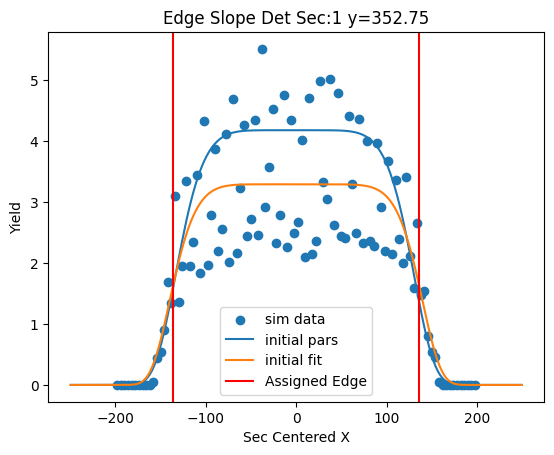

[  4.36871626  -0.22827142 101.3787511    7.81231842]


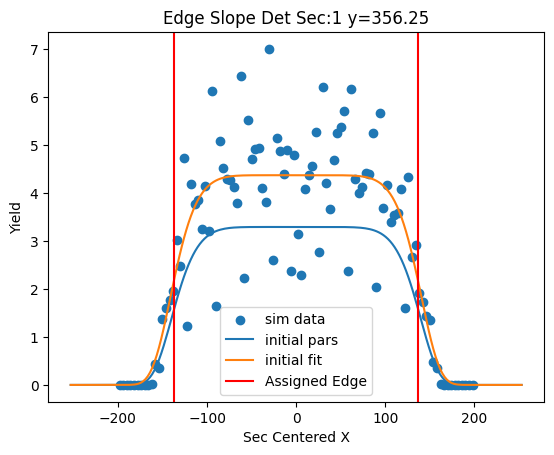

[  2.62557412  -2.39621496 102.18064414   7.29654002]


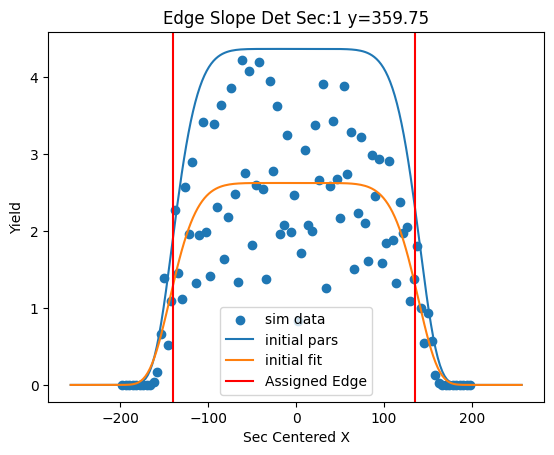

[94.61738685  0.55876139 28.86047741  5.22199157]


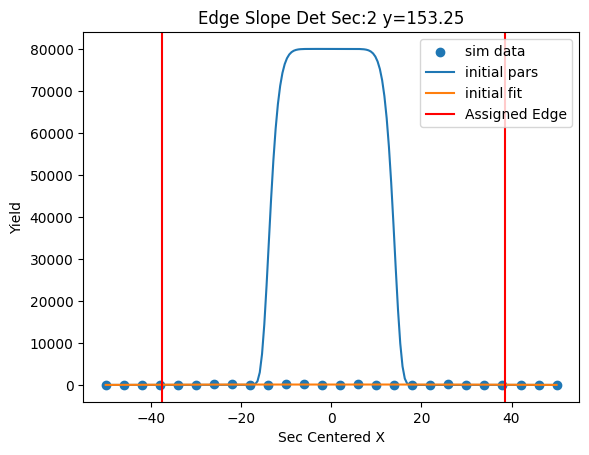

[108.27871326   1.08602689  36.24818384   4.19713867]


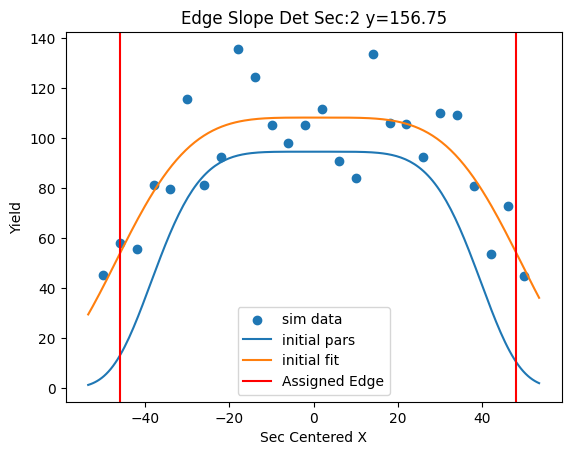

[75.36737101  0.59773837 34.76405724 10.37373968]


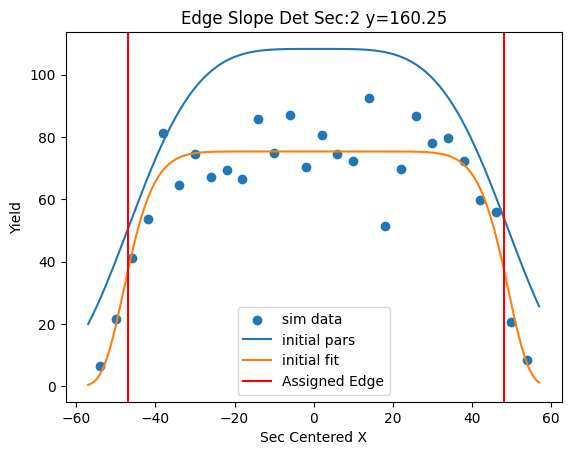

[78.8486298   0.41191784 34.23166461 13.98042158]


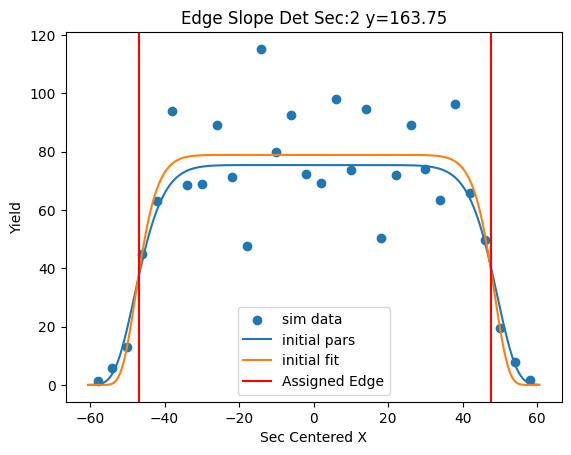

[85.26092084  0.54547067 34.36406742  7.91330201]


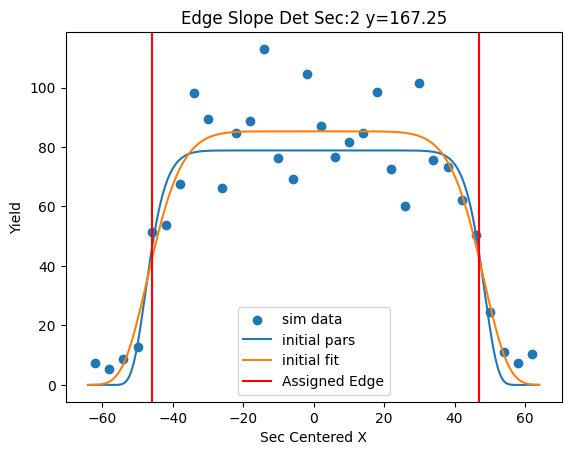

[73.6986202   0.65451415 39.29303206  4.61578763]


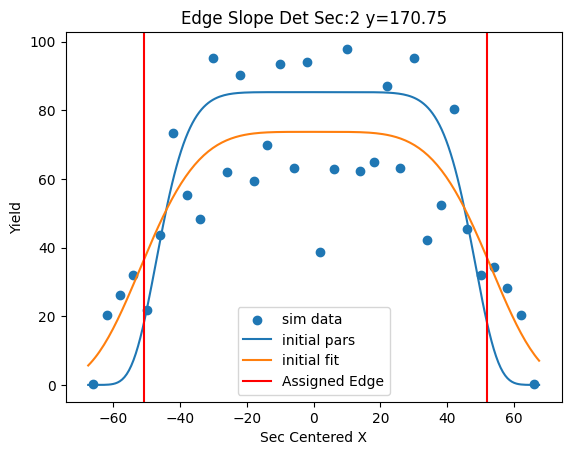

[65.34113003  1.04860437 41.01586221  9.33367919]


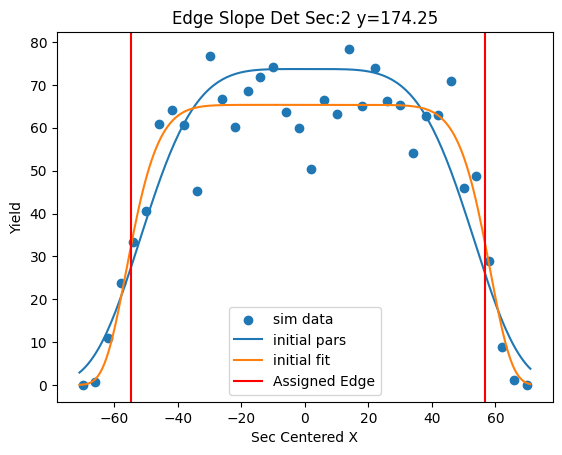

[71.62122857  1.51870602 40.40740143 10.2704942 ]


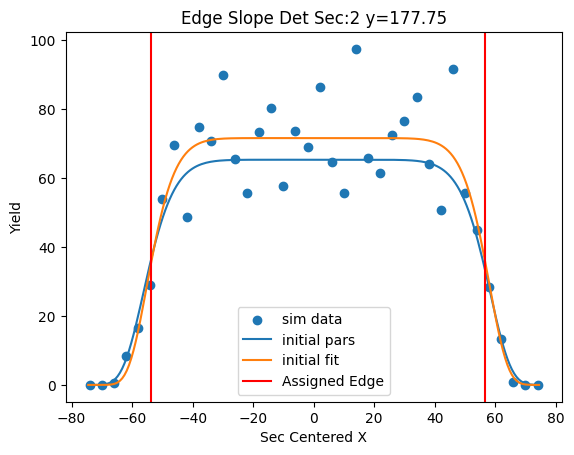

[53.56297128  1.48217037 39.47878706  9.21283216]


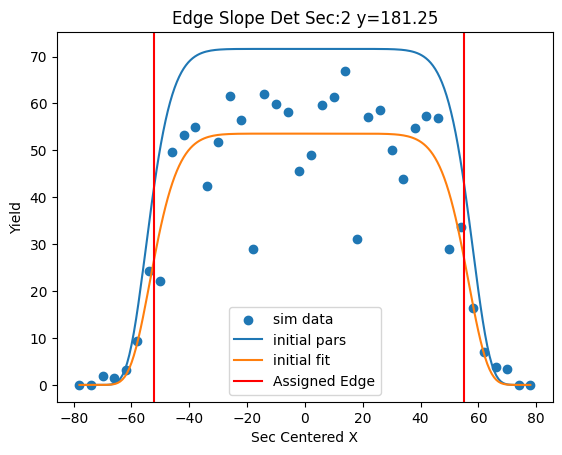

[67.44156183  3.00376677 43.7079062   5.25712992]


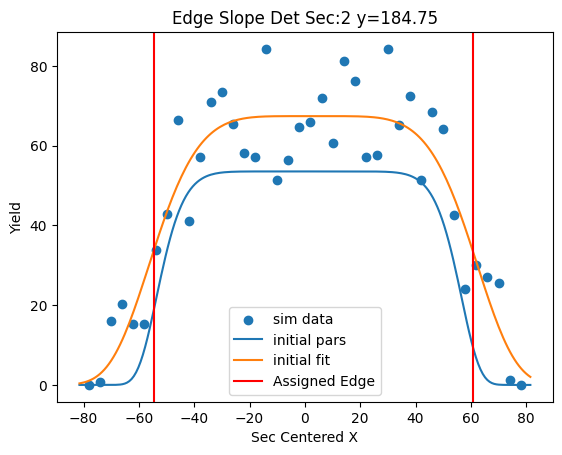

[53.28044567  2.14406038 46.8062887   7.5858413 ]


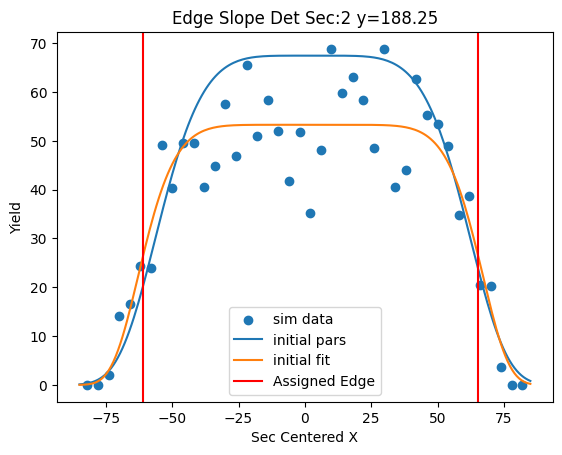

[55.38375207  1.09670675 44.73460882 15.03565247]


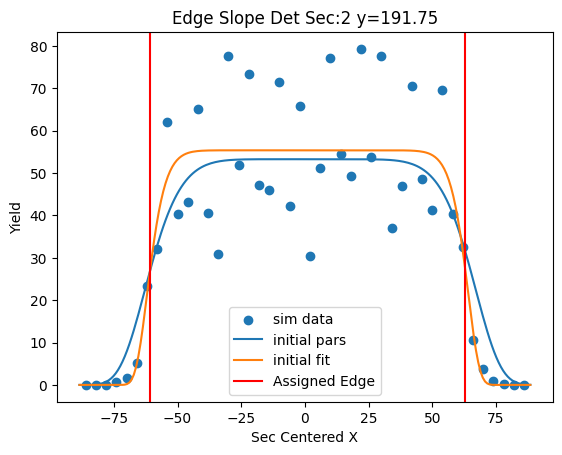

[61.33872979  0.97284443 44.30254887 11.73916182]


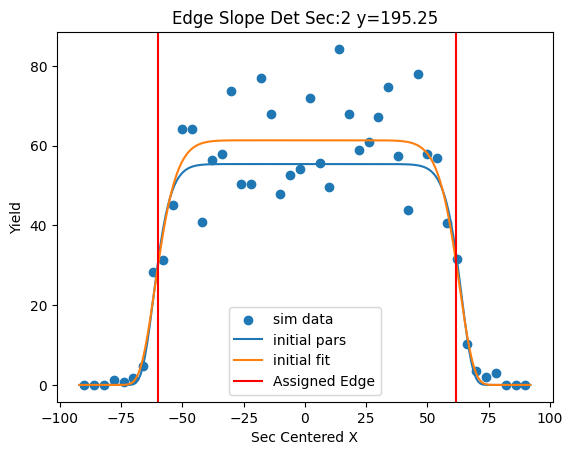

[49.72756911  0.85020704 47.0832022   9.06982845]


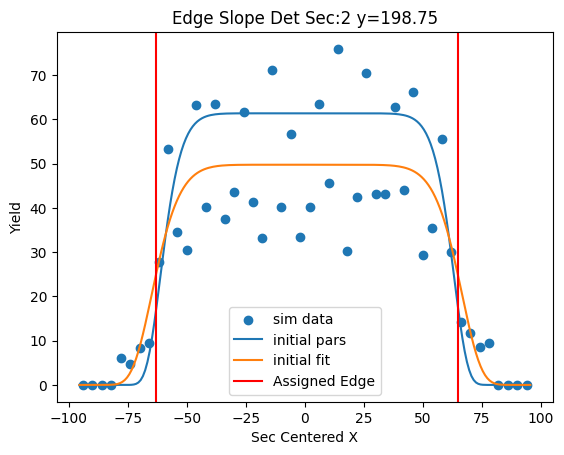

[44.69390282  1.260658   52.93507675  7.2897189 ]


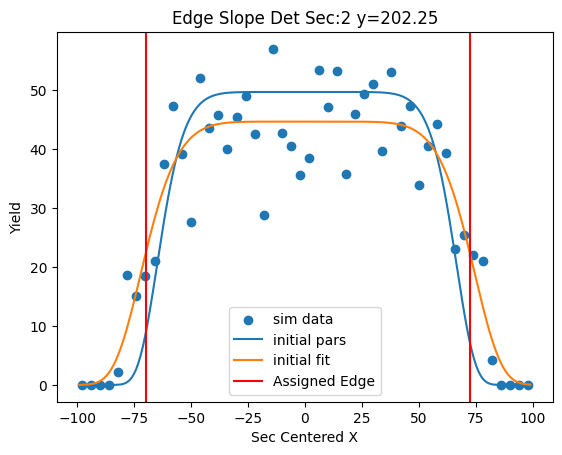

[55.12387971  1.15840604 53.99929483 10.04462144]


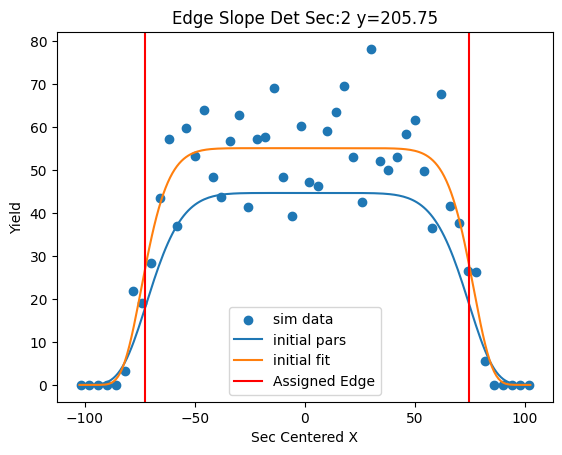

[38.3936372   0.8298178  50.76812926 12.19977534]


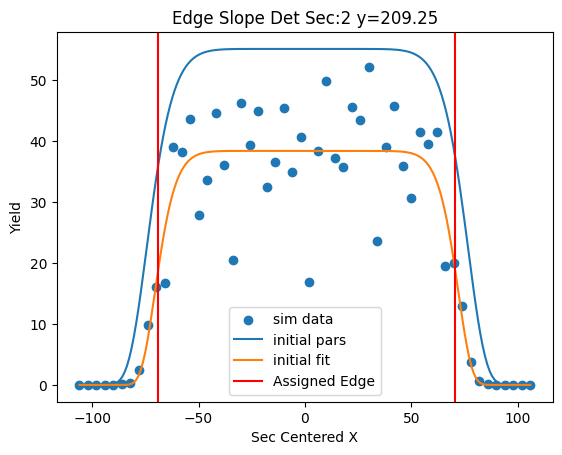

[45.91965372  0.48316848 53.63698487 11.69048301]


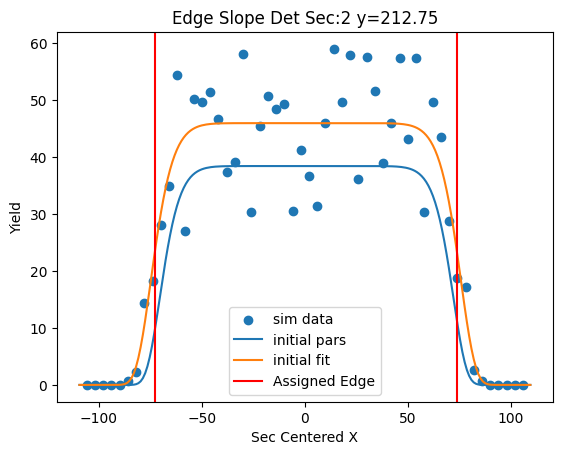

[ 3.71241138e+01 -2.67431980e-02  5.45412602e+01  1.58719361e+01]


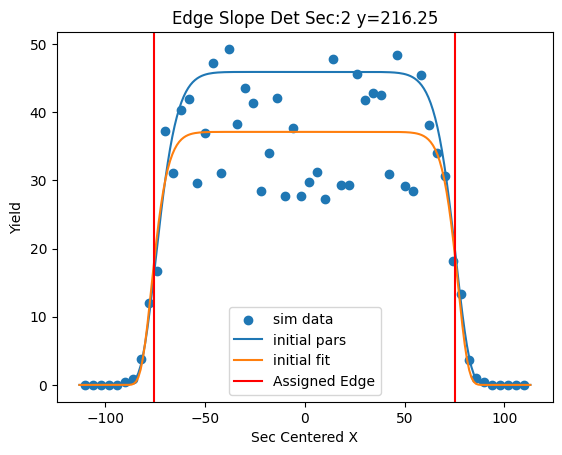

[37.2126146  -0.53700847 54.94225306 14.94704687]


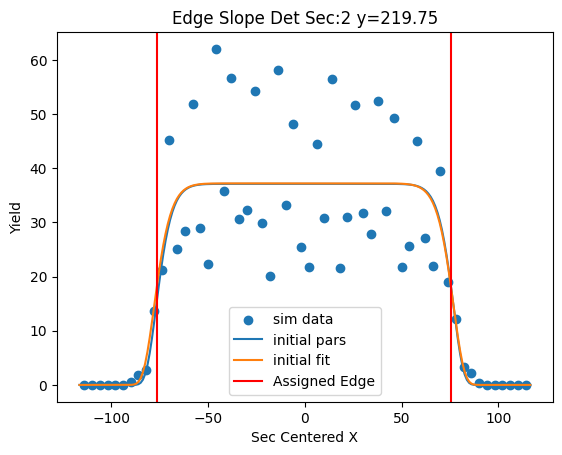

[41.39107148 -0.76123957 55.71268827 10.59606563]


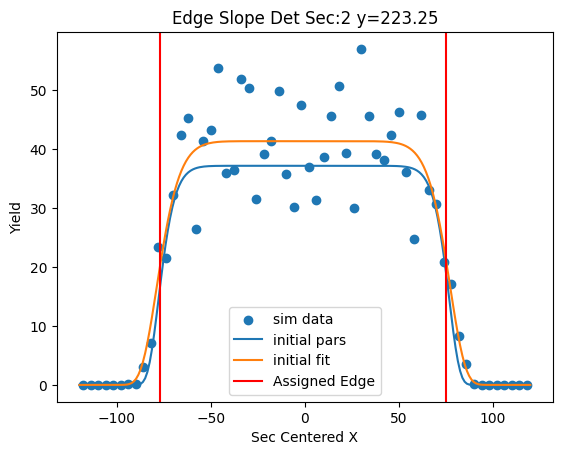

[33.37978599 -1.01024855 54.0914287  11.61910323]


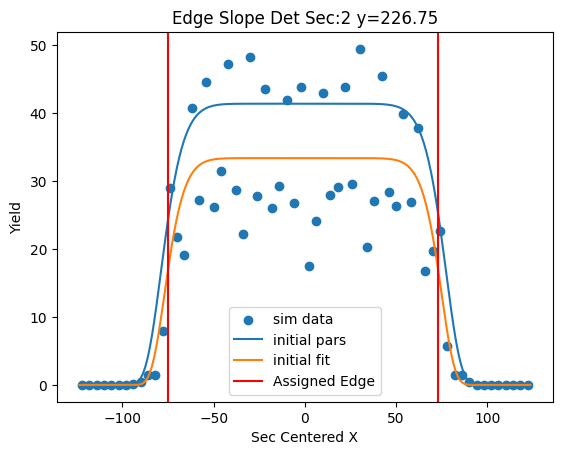

[30.82699351 -1.25115855 55.5985194  11.21078039]


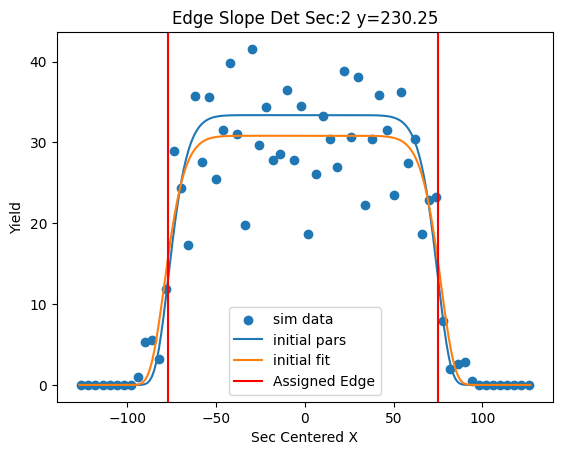

[39.70233848 -2.26351136 60.27313186  7.5404508 ]


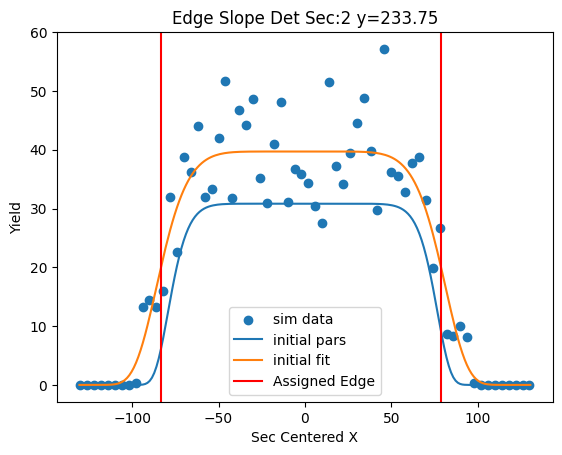

[25.73461696 -2.28502373 63.87731452  8.73964842]


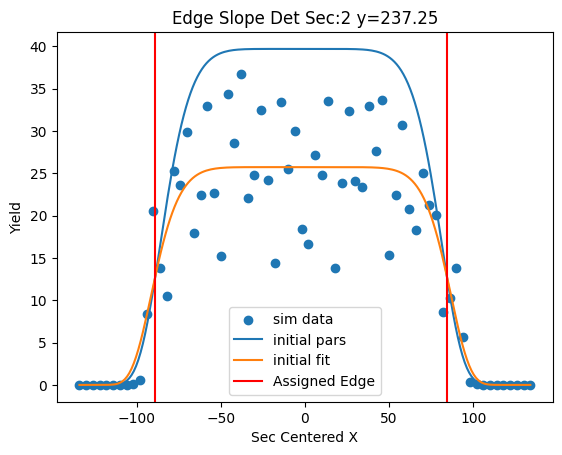

[29.9484754  -1.01506996 62.86522225 11.81780231]


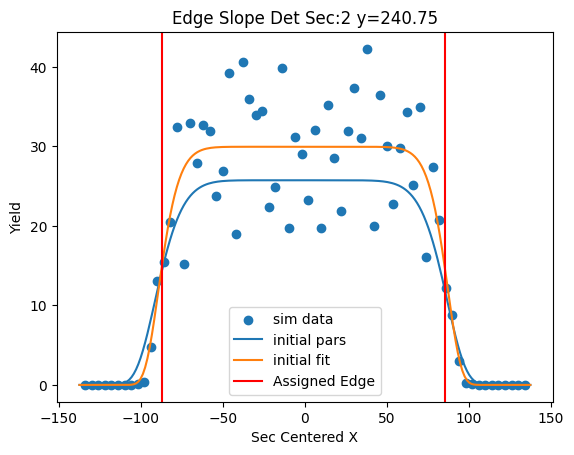

[27.054486   -0.73401689 61.46791436 14.71548921]


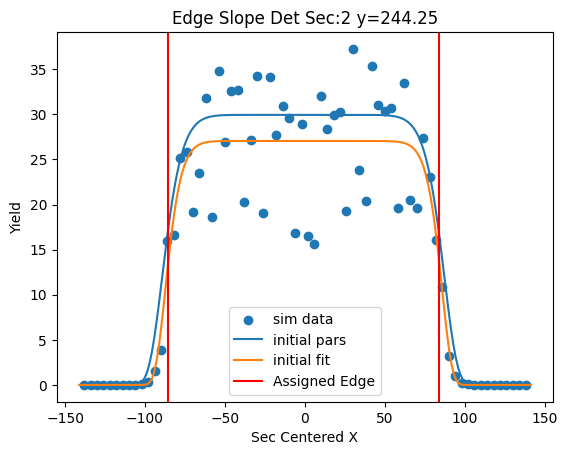

[26.53030516 -0.95351696 63.98736073 10.23000901]


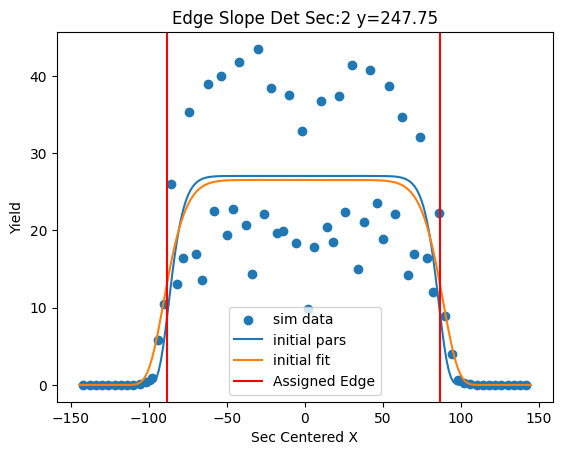

[27.47841321 -0.6824854  65.59882041 12.62213051]


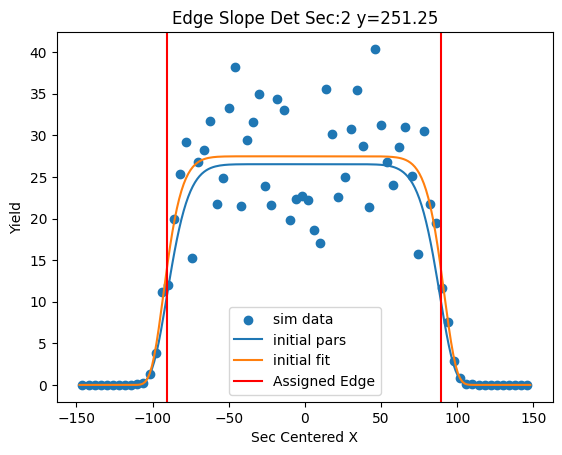

[21.3456709  -1.46027802 66.06363975 10.02254873]


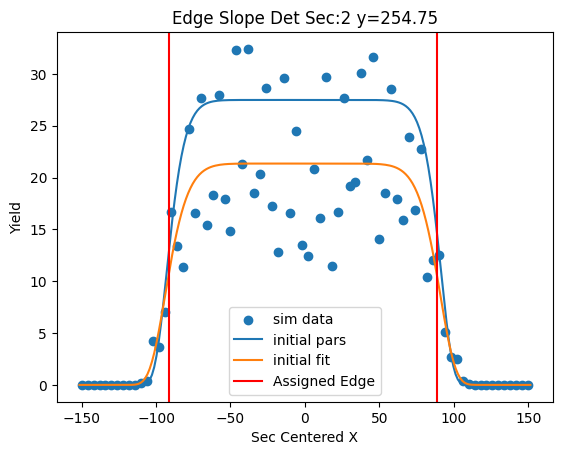

[20.73017217 -1.22306206 66.82361308 11.09542376]


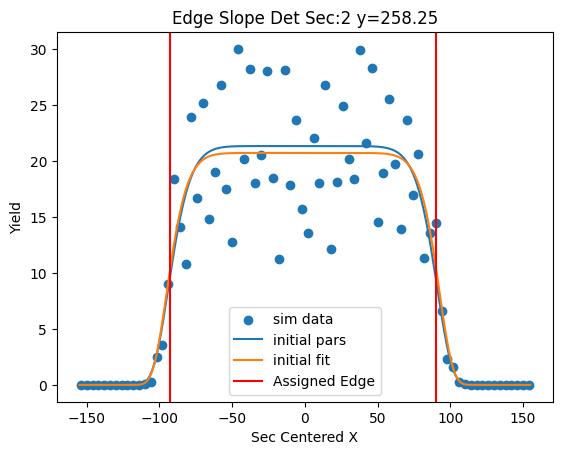

[27.79459231 -0.71606758 65.05504055 13.17604285]


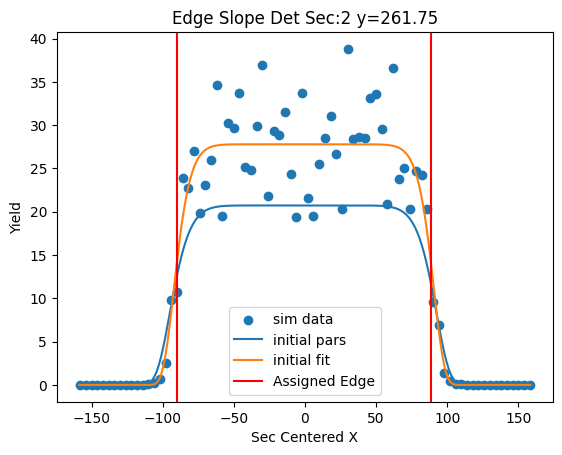

[17.90168145 -1.09283501 64.56145062 11.92324234]


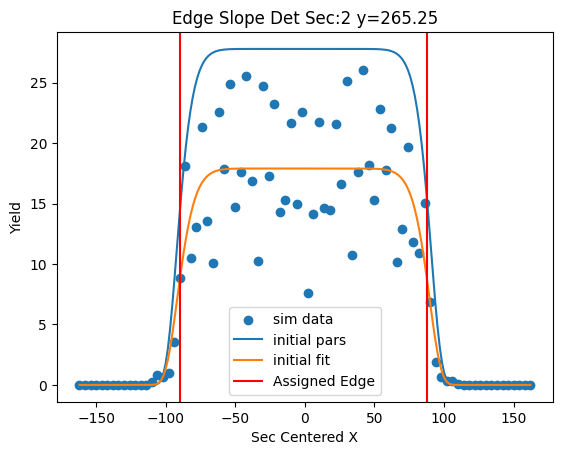

[20.24635032 -1.40086564 68.01740142  9.3493048 ]


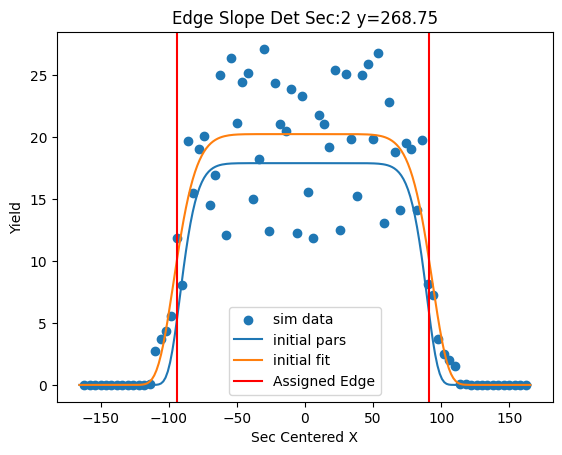

[19.08020036 -1.65598557 72.21086709  7.88244875]


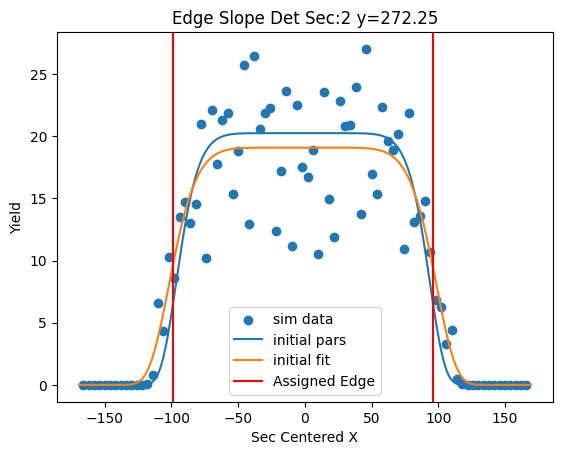

[15.33337644 -1.87024462 74.29543021  7.69151877]


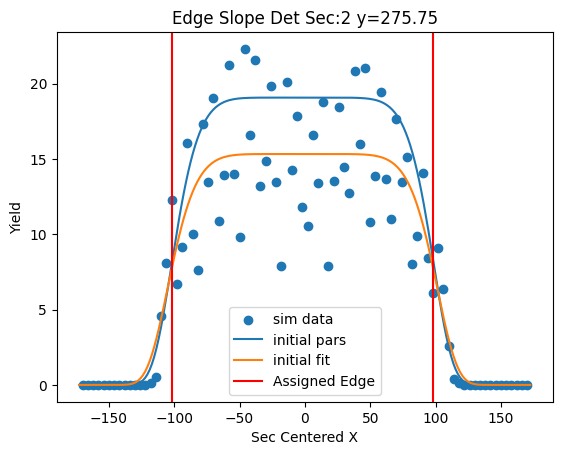

[20.70023355 -0.31623231 74.82567953 11.14356877]


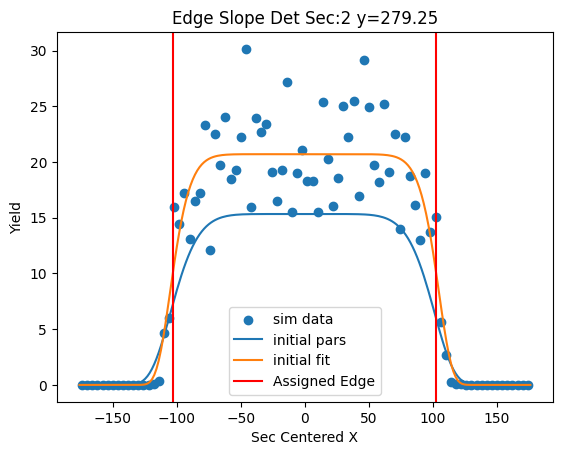

[14.6723263  -1.07423611 74.22814864  9.30481672]


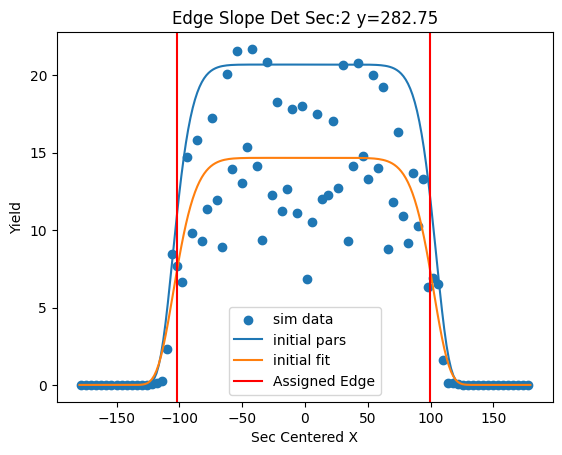

[14.1823251  -0.86190125 75.0294913   8.85687369]


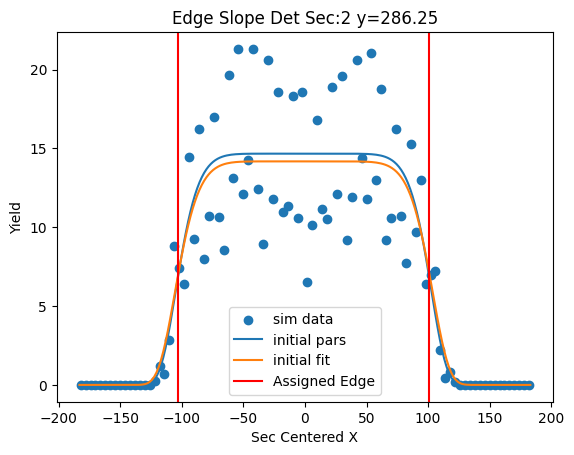

[16.40189438 -0.22612115 77.41173939  7.73485711]


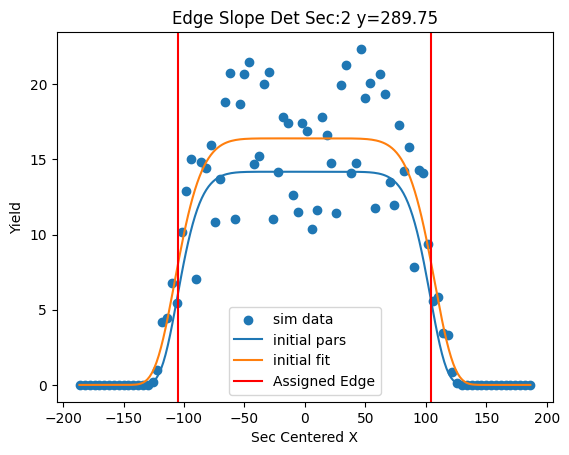

[13.85170866 -1.62461072 79.75268607  6.29073468]


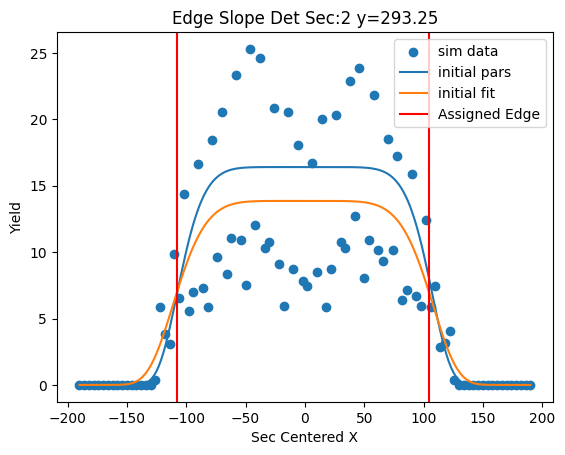

[12.74089032 -0.25159699 81.43756151  7.10744281]


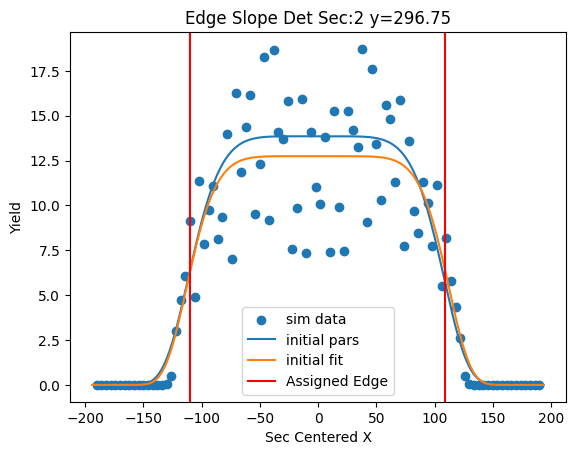

[13.06603567 -0.33395148 80.81916942  7.73283181]


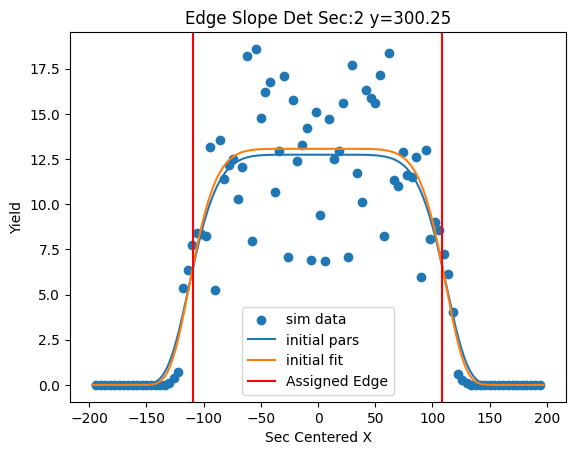

[ 9.96136261 -0.96962642 78.10461893  7.49987399]


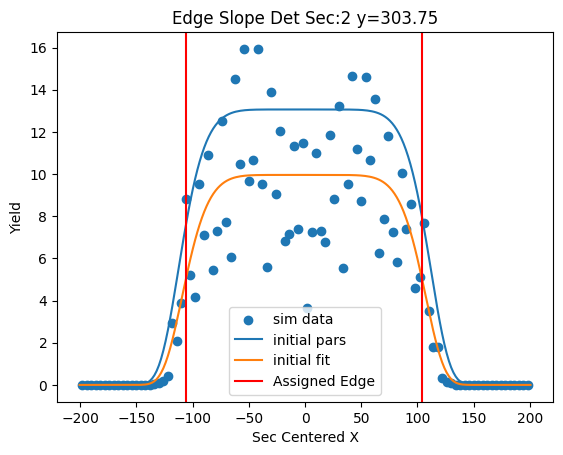

[13.73061448  0.14069179 80.60672049  7.47050201]


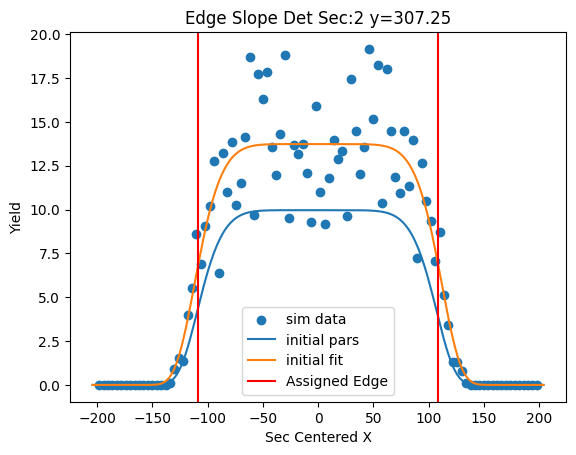

[ 9.1652277  -0.93128146 83.30283953  6.28927446]


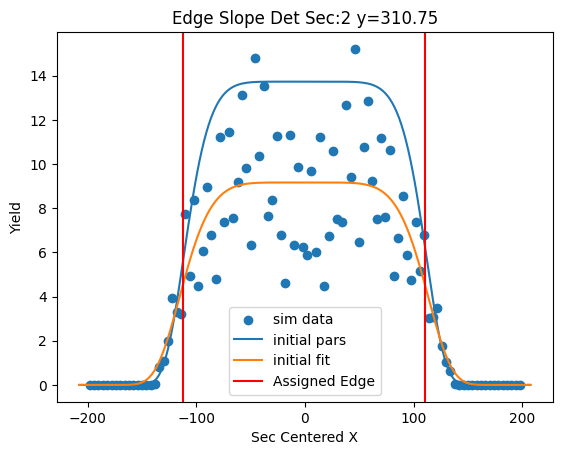

[ 9.27201436 -1.47138327 84.7518171   5.48938142]


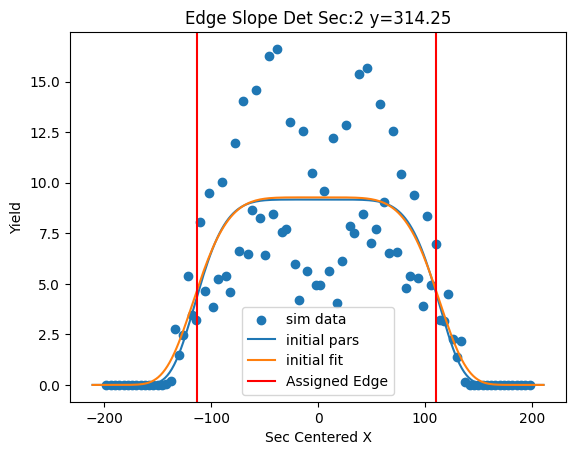

[ 9.9377539   0.53079643 87.02704443  6.20452989]


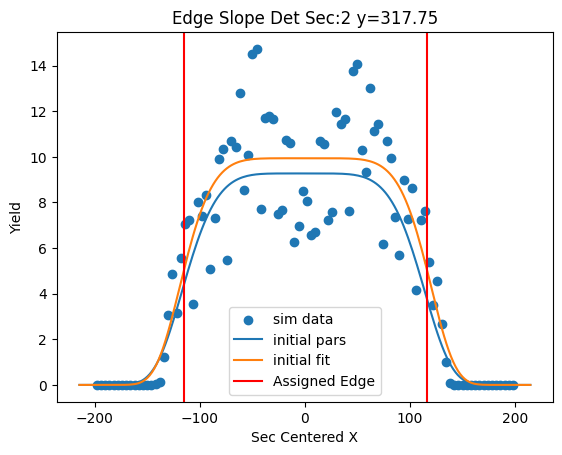

[ 8.70264682 -1.91626531 85.78779212  6.15663379]


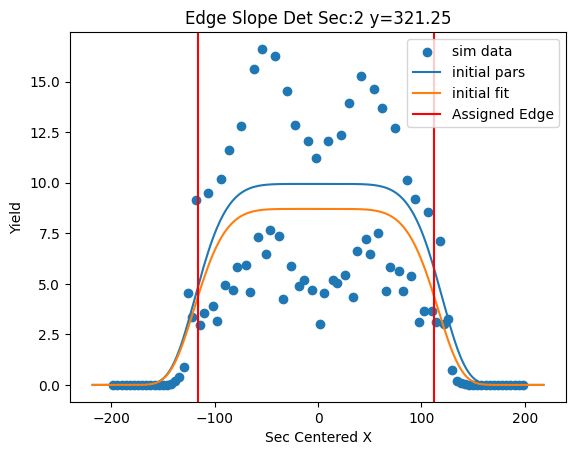

[ 7.24015372 -0.29906752 86.02054085  7.57402605]


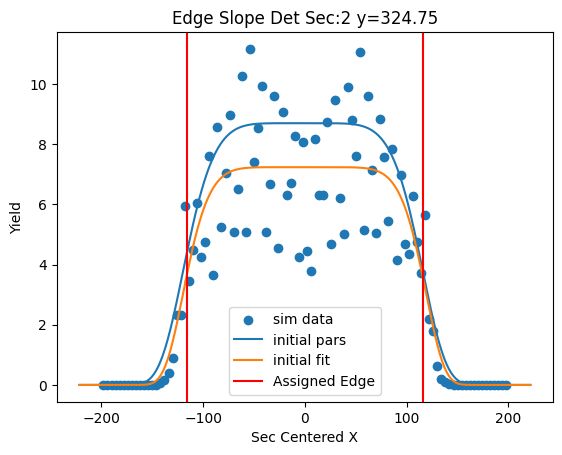

[ 8.22304328 -0.51221661 87.39151842  6.97116532]


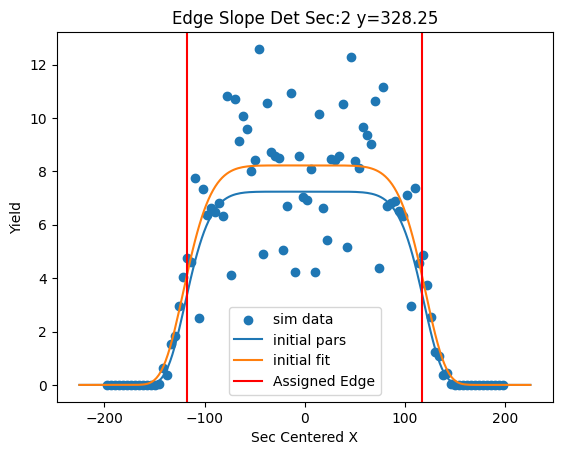

[ 5.68272793 -1.70016477 90.824158    6.34855732]


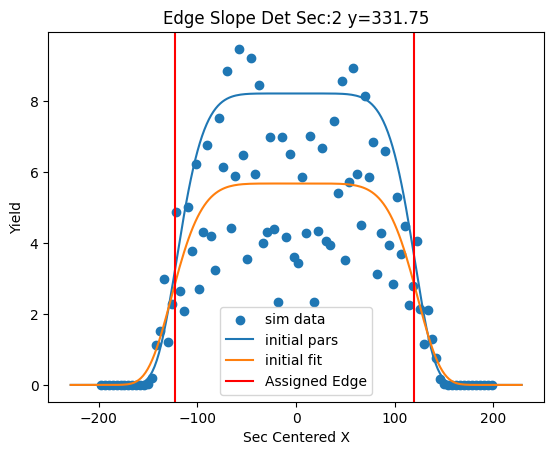

[ 7.75779669 -0.41846891 93.24123408  6.18851502]


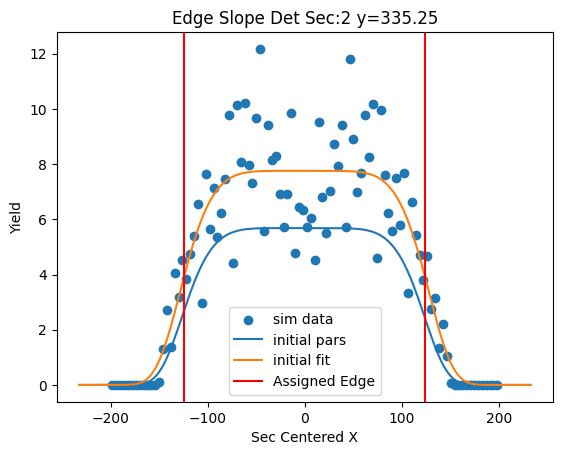

[ 5.28141379 -1.61108847 92.78171507  5.75944821]


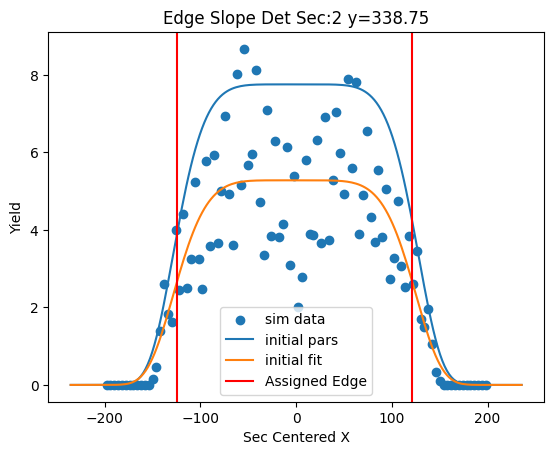

[ 5.30776495 -1.61236146 93.32824236  6.37558365]


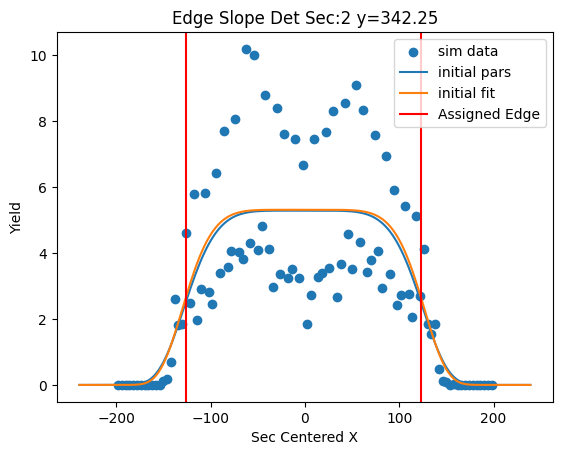

[ 4.93489378e+00 -6.45437662e-02  9.54977826e+01  9.46672985e+00]


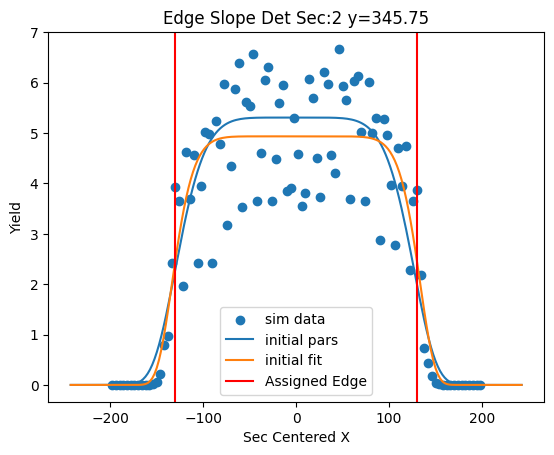

[ 4.27950857 -1.61272789 96.04305698  7.10026076]


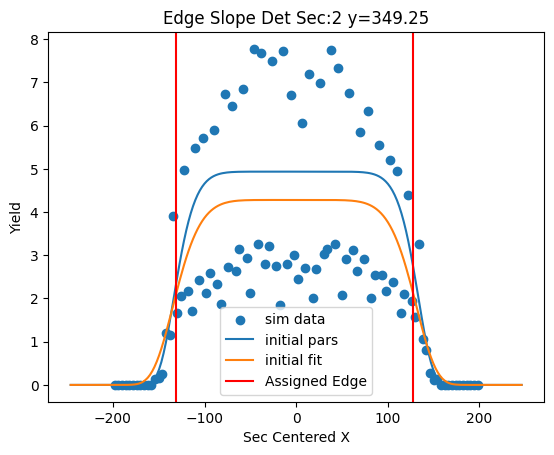

[  3.48175085  -0.5379051  100.31287941   7.25308949]


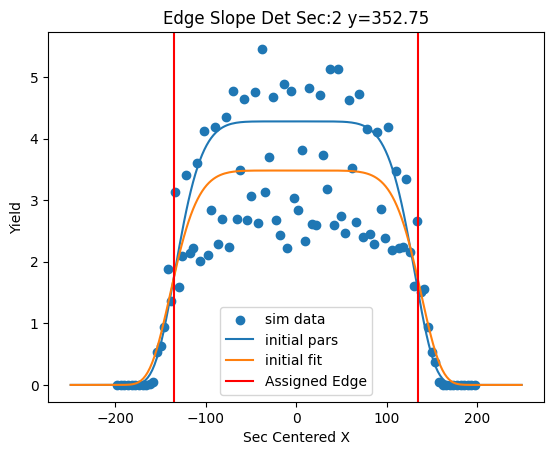

[  4.3753544   -0.68942879 101.35395799   7.31920538]


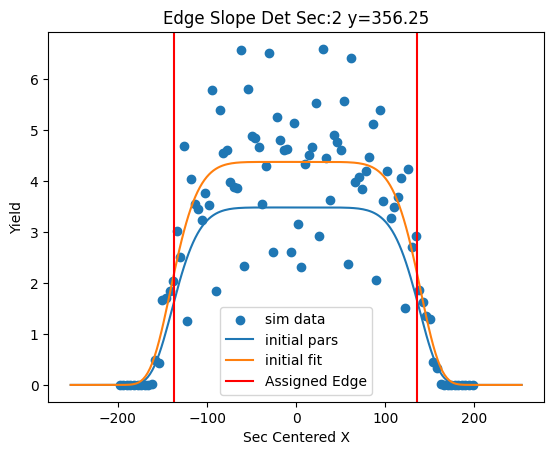

[  2.73367803  -2.71999537 102.31719253   7.13877749]


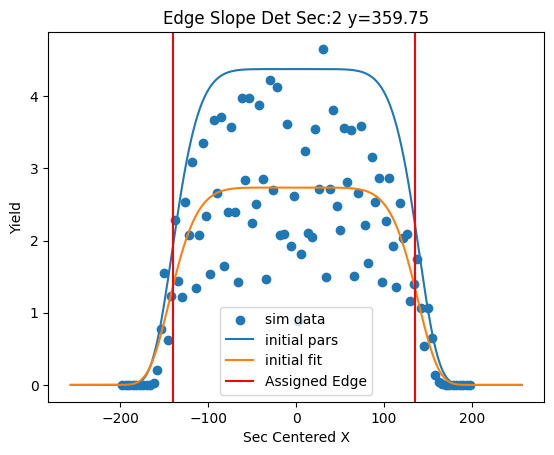

[48.36581373  0.0923818  29.64696481  5.34401441]


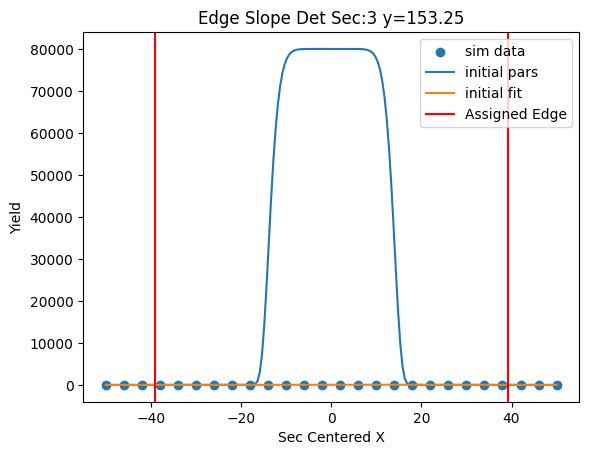

[5.62927324e+01 2.63138090e-02 3.77347557e+01 4.48139781e+00]


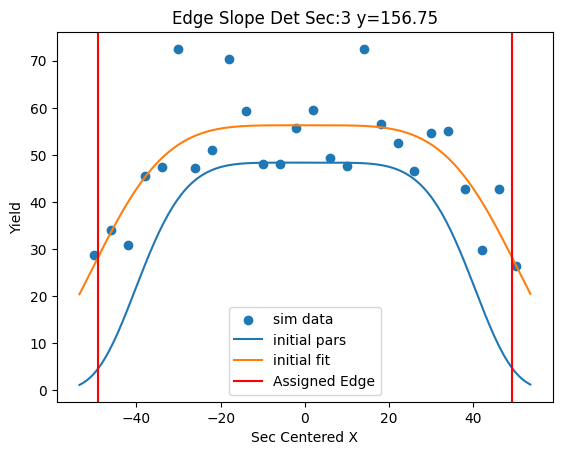

[41.87861148  0.2468898  35.20337816  9.89089379]


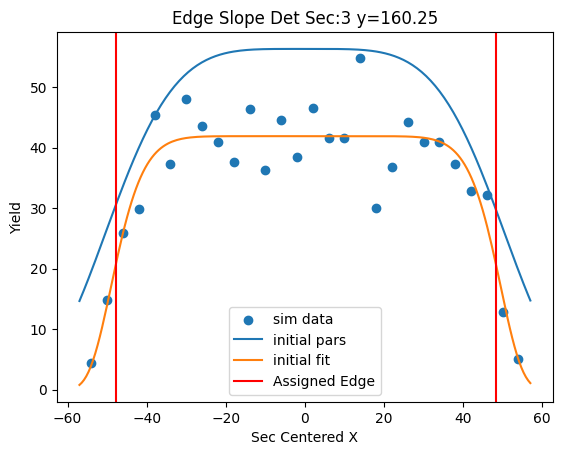

[43.93688064  0.11515681 34.61435251 11.18719084]


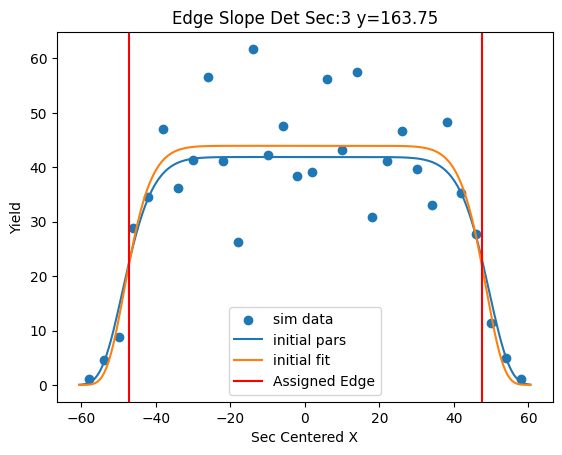

[46.47780654 -0.09998375 35.50731874  6.66435127]


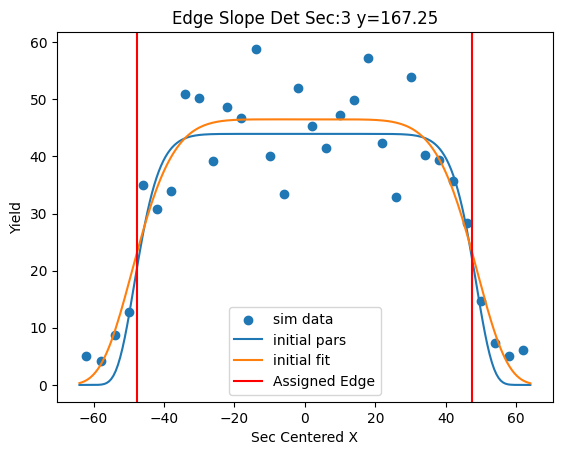

[40.77105218 -1.11804863 41.17224907  4.88959785]


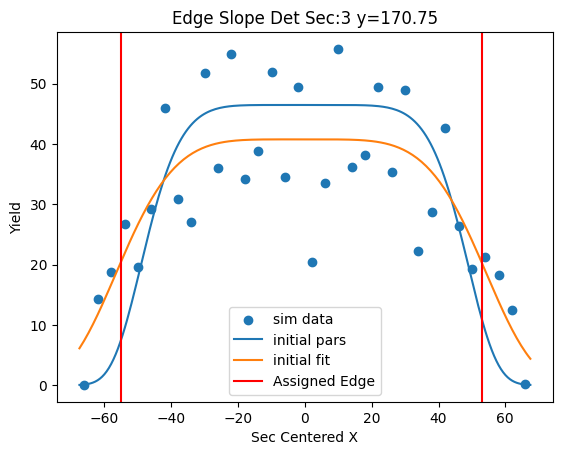

[35.04008875 -0.82454859 42.10802783 11.59714184]


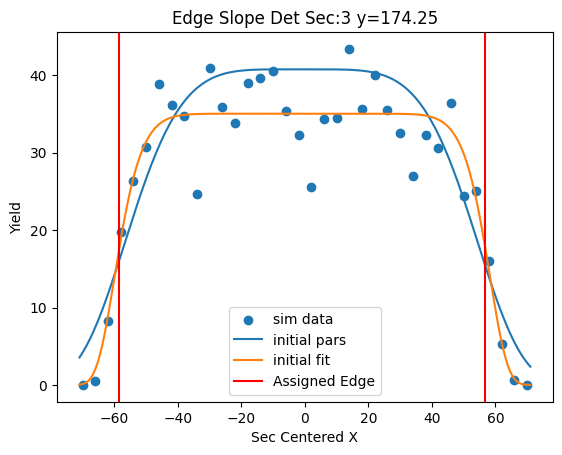

[39.77462645 -1.18463612 41.56074398 10.28417429]


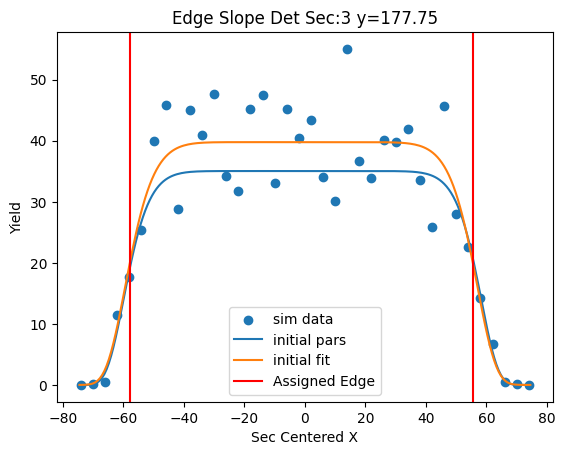

[32.75941528 -1.50436062 41.0665972   8.71211076]


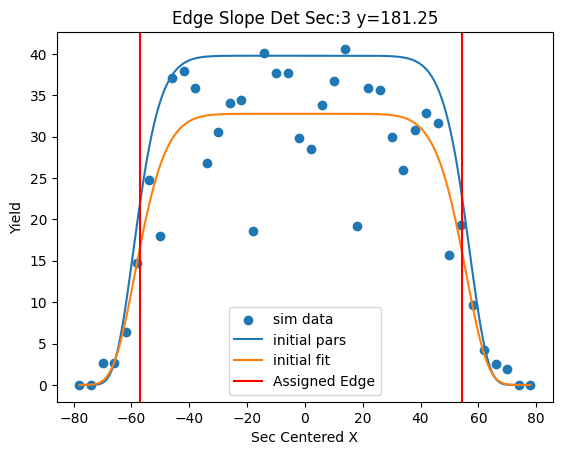

[40.78918826 -1.40171827 46.26527592  6.1993087 ]


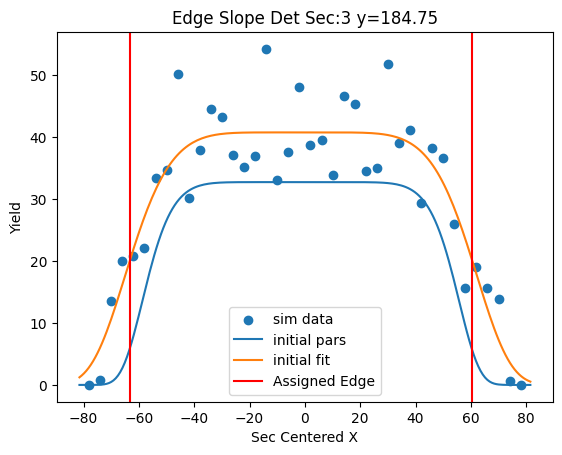

[31.79098813 -0.7389086  48.32714023  9.50014822]


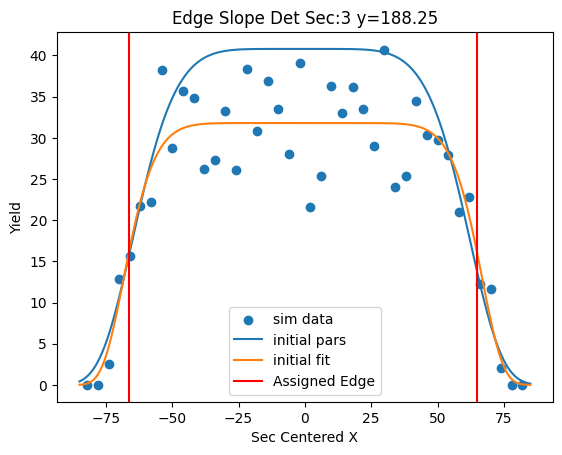

[33.43559881 -0.44406186 45.61960402 17.90273685]


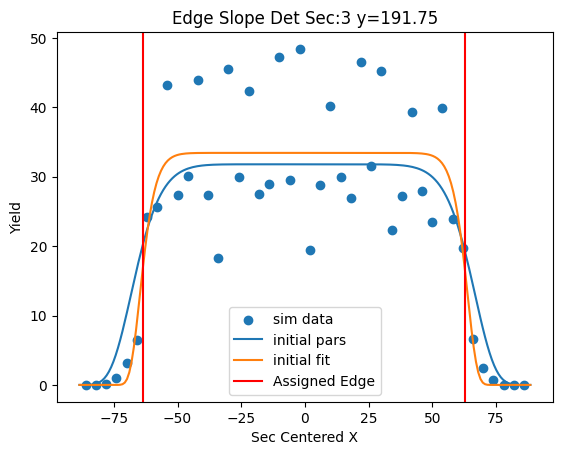

[36.31240795 -0.25910627 45.42996194 12.00645163]


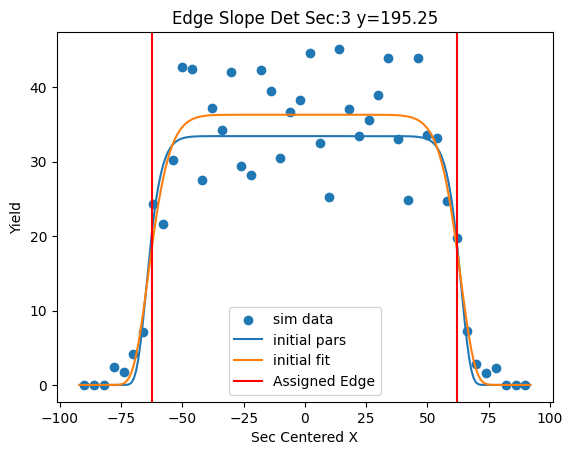

[31.37918383 -0.70960714 49.472834    6.97407938]


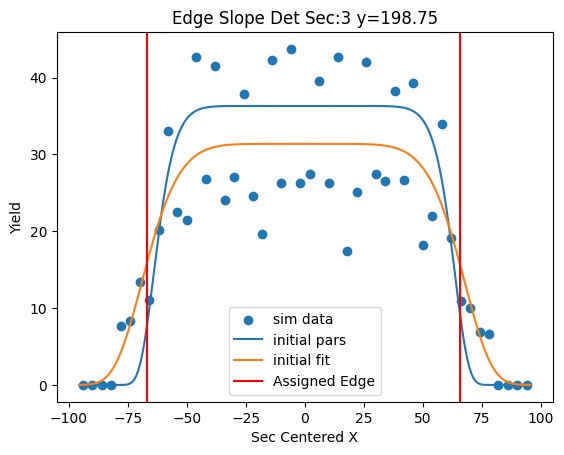

[27.53073389 -0.4347205  54.8041383   8.22566024]


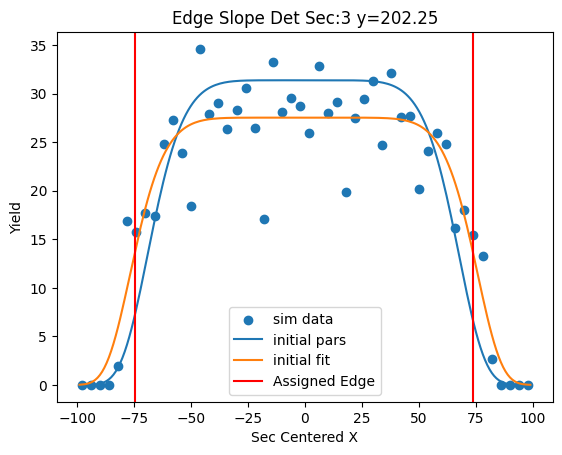

[33.96736373 -0.26848889 55.64009501 11.04891817]


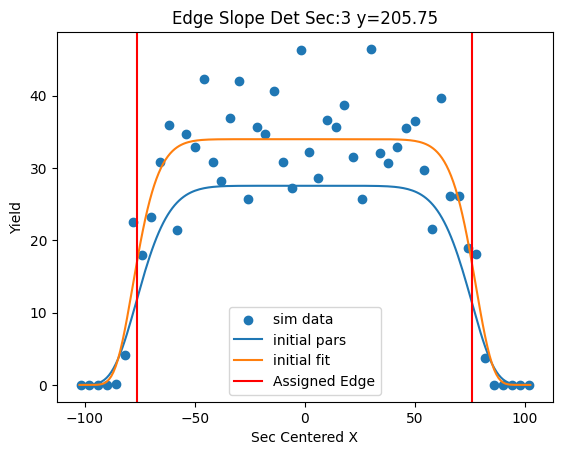

[24.56113834 -0.29131932 52.63626416 10.83786237]


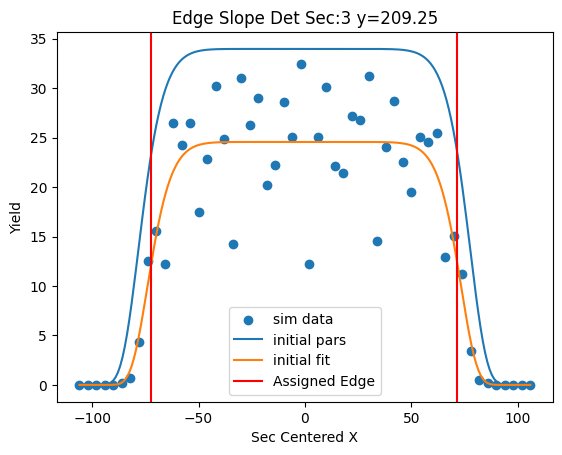

[29.94205069  0.30708041 54.76422843 10.04541643]


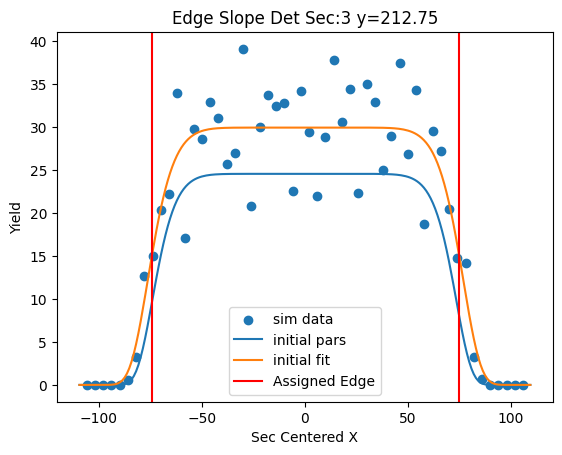

[24.76423214  0.28135422 55.66926798 12.68792605]


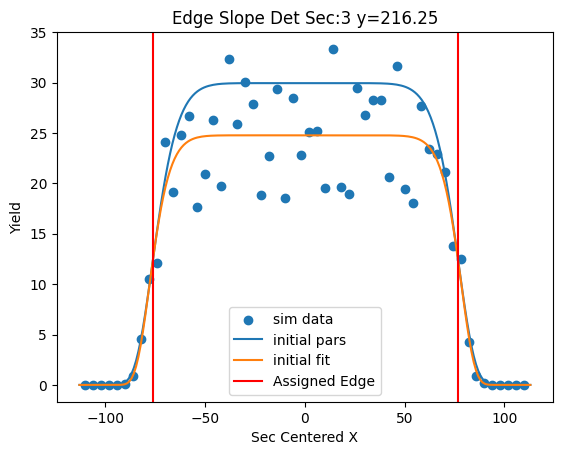

[24.04816062 -0.22309199 56.24948387 12.48441675]


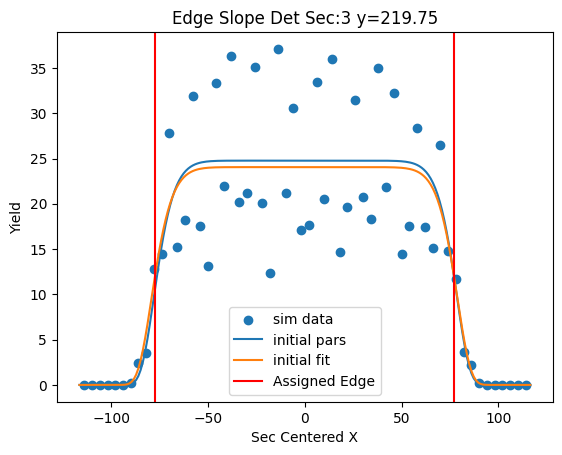

[25.63126663  0.17595133 57.56115098 10.3975882 ]


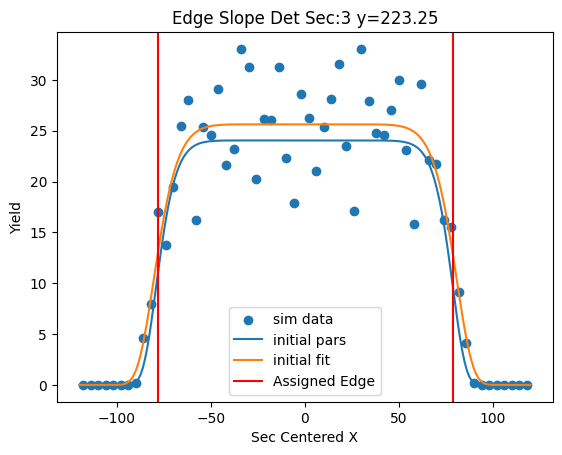

[2.16652942e+01 3.04989024e-02 5.49881790e+01 1.06021303e+01]


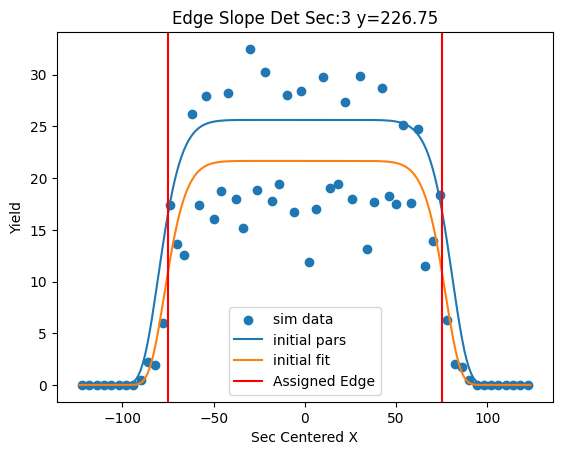

[20.68523462  1.05620758 56.06577508  9.60599595]


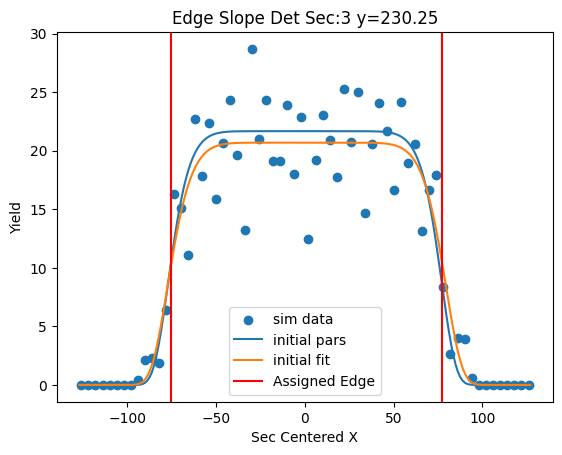

[26.87839595  2.24277173 60.89908955  7.3347002 ]


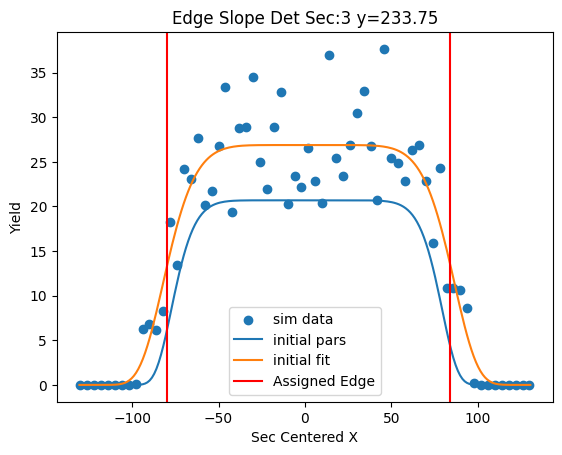

[17.92274338  1.20945145 64.19563269  8.76599285]


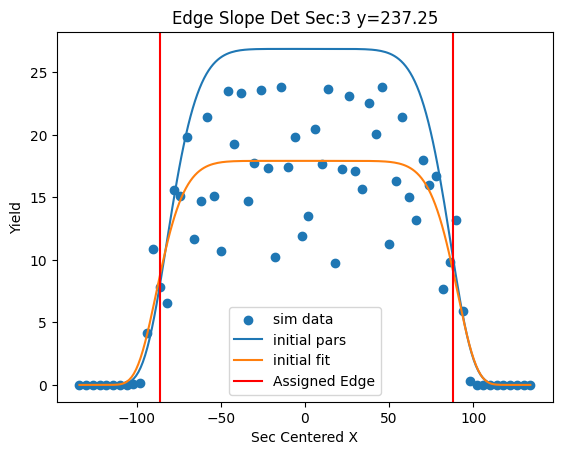

[20.98973312  1.11532333 63.29789298 11.17256716]


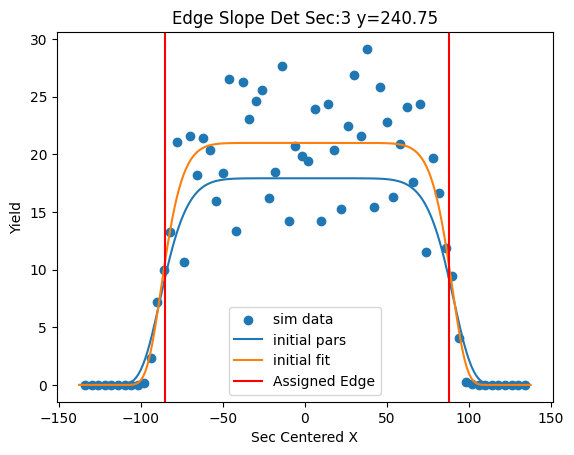

[19.11777377  0.53568477 62.08234841 14.08312081]


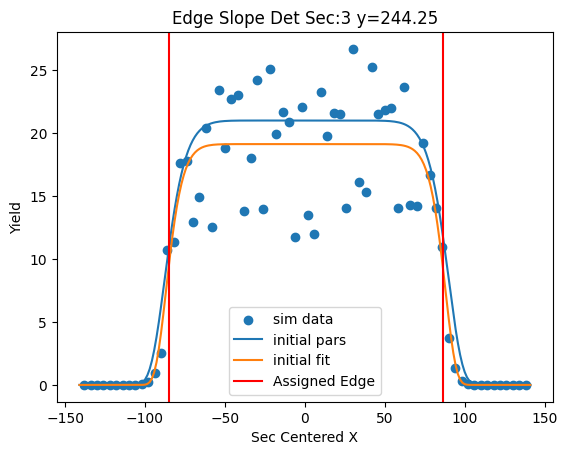

[1.85555244e+01 1.17777038e-02 6.45965092e+01 9.44413212e+00]


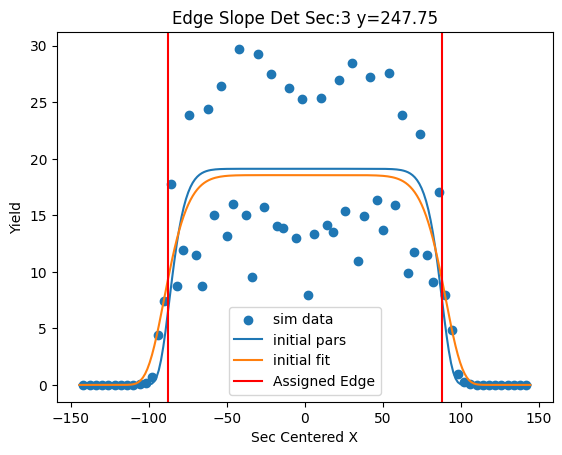

[19.14837205  0.59799058 66.61287294 11.81537258]


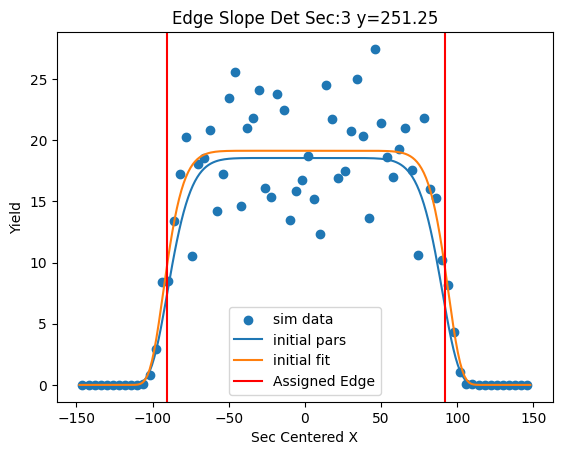

[15.39976586  0.16067325 67.14727482  9.07846967]


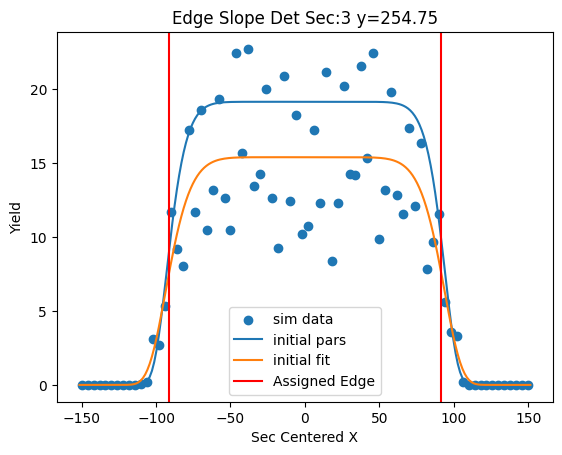

[15.05231865  0.32075716 67.60207619 10.23663659]


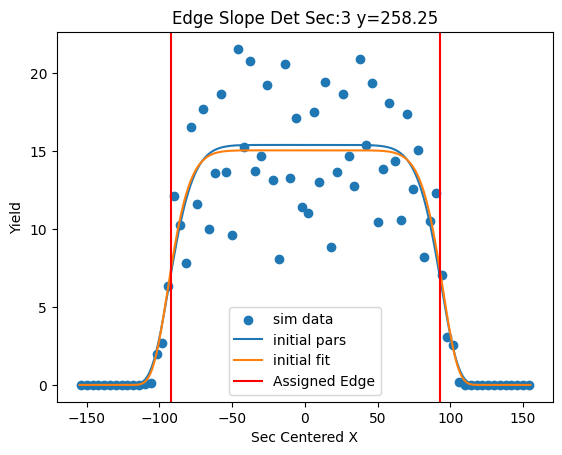

[20.368065    0.74420261 65.53669553 12.02522069]


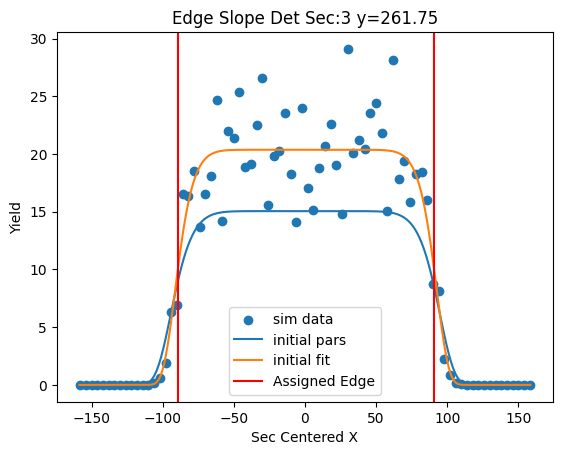

[13.46838158  0.06517791 64.55232689 11.43824461]


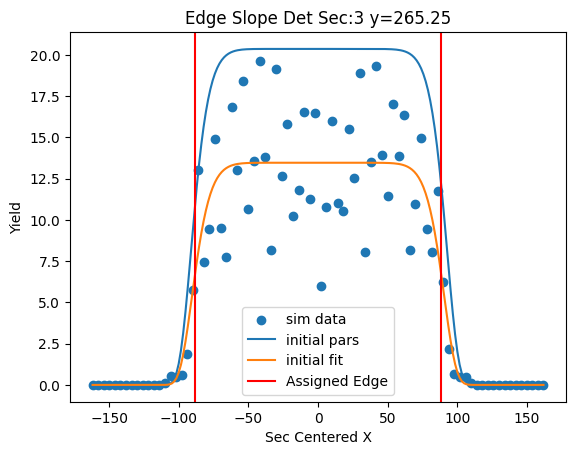

[15.20165226  0.43289632 67.55195681  9.07688546]


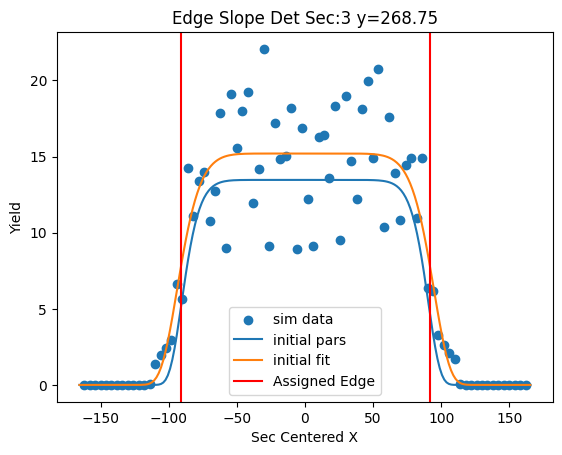

[14.56557969  0.35958067 71.7093798   7.61952285]


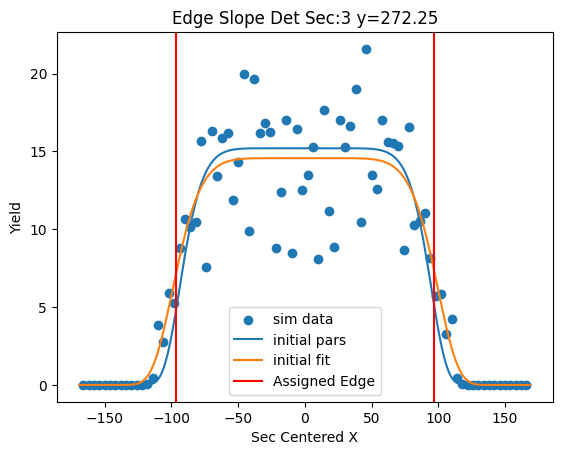

[11.81493277 -0.40013385 73.93674337  7.37559095]


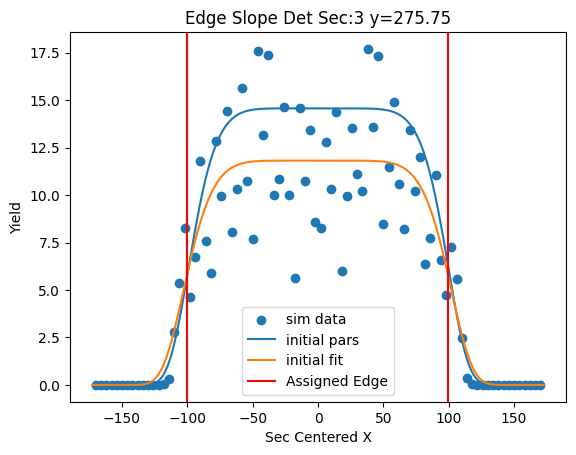

[15.84880915  0.21752103 74.32467395 10.19482261]


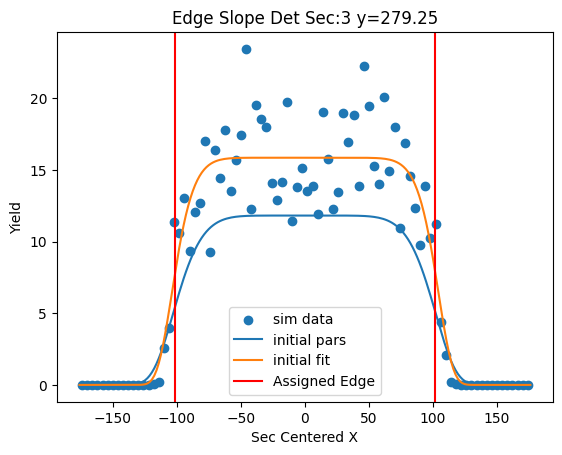

[11.723337   -0.73478369 73.38391247  8.9184343 ]


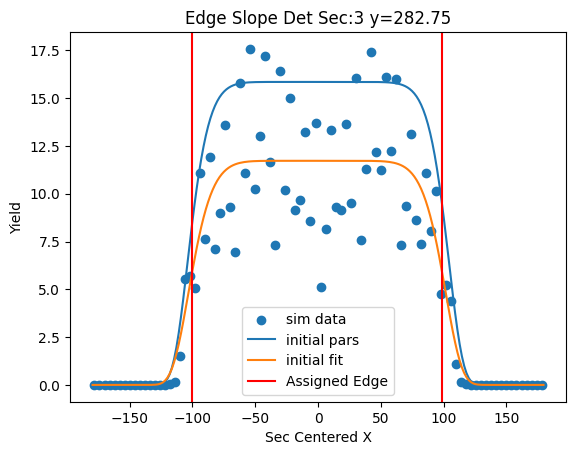

[11.49186051 -0.60166483 74.29747223  9.03467027]


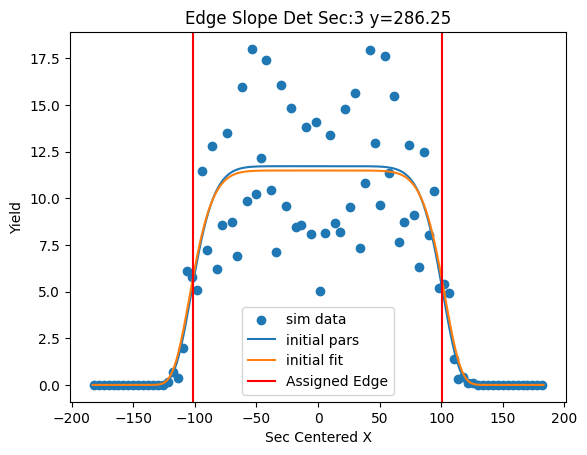

[13.07561204  0.28058898 76.5861305   8.57651214]


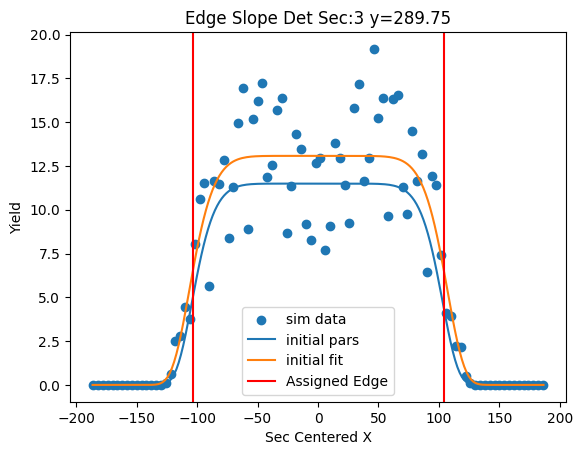

[11.52702878 -0.89113552 78.63750356  6.502681  ]


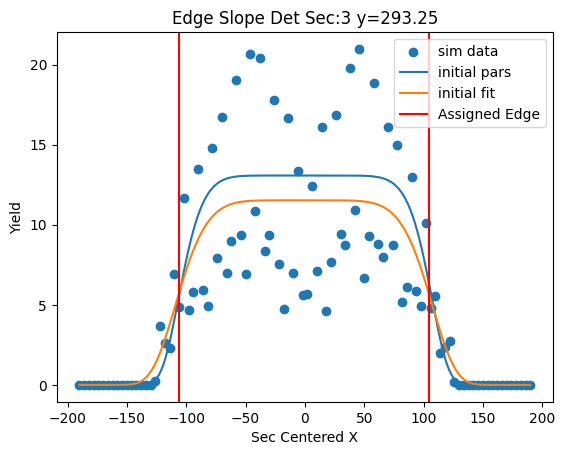

[10.67232951  0.5481655  80.61897535  7.1933064 ]


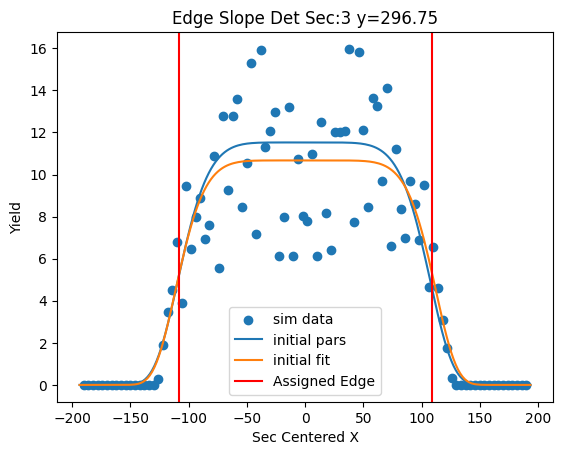

[11.24861252  0.49457757 79.99670979  7.58762914]


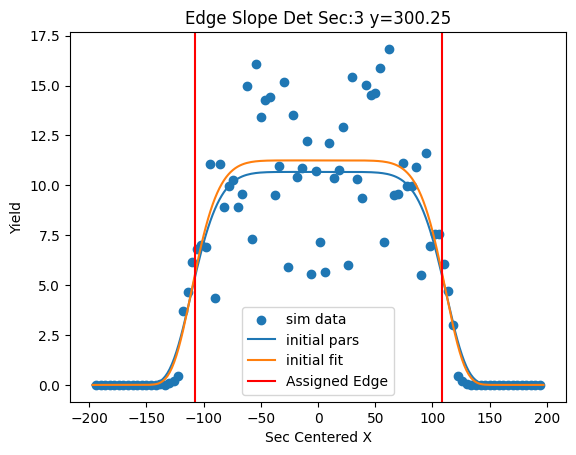

[ 8.56475762 -0.25637066 77.40256983  7.62248599]


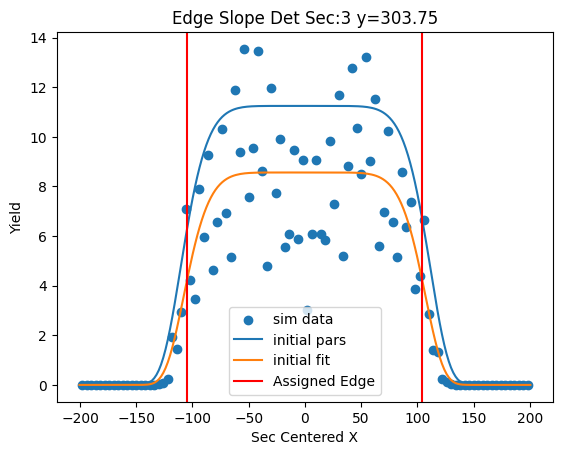

[11.73453728  1.02444179 80.09283846  7.49210001]


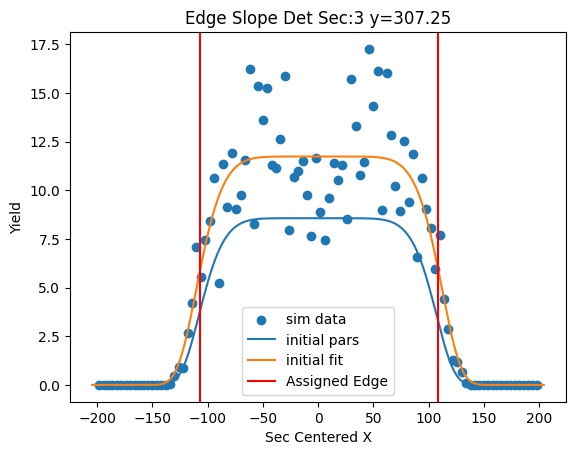

[ 7.97988115  0.09358561 83.04419926  6.67194003]


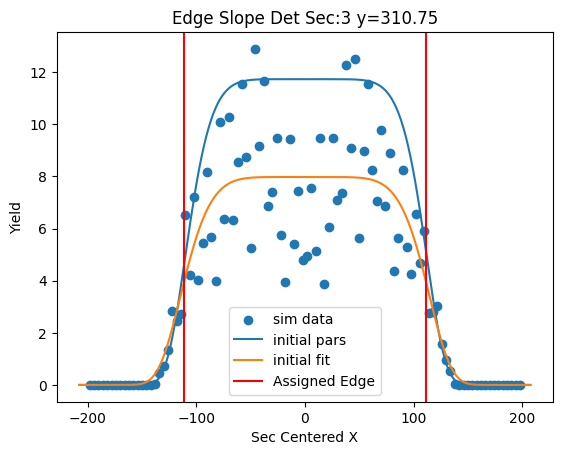

[ 8.1425091   0.18257585 84.32592081  5.83814169]


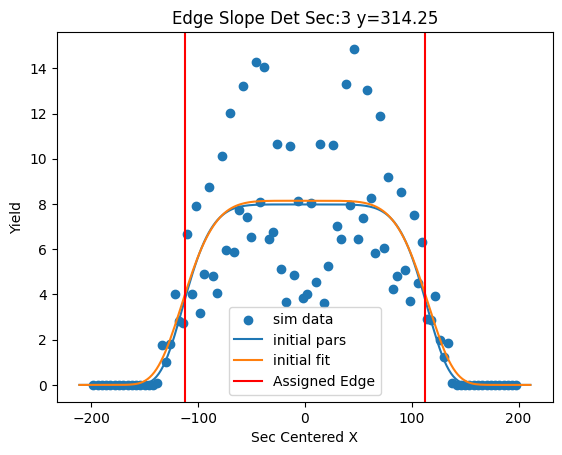

[ 8.82859485  1.40057594 86.45372838  6.4442794 ]


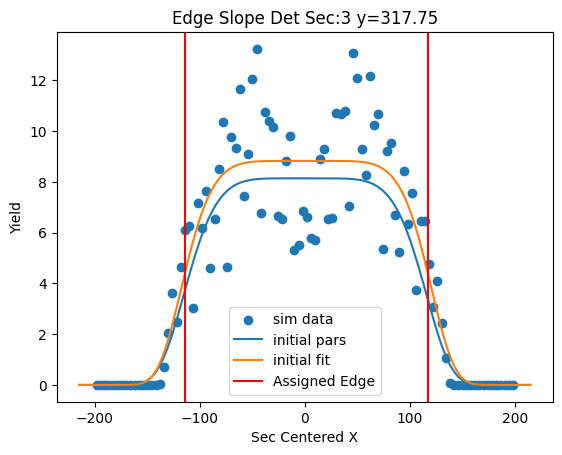

[ 7.98267872 -0.41676905 84.77521261  6.17146129]


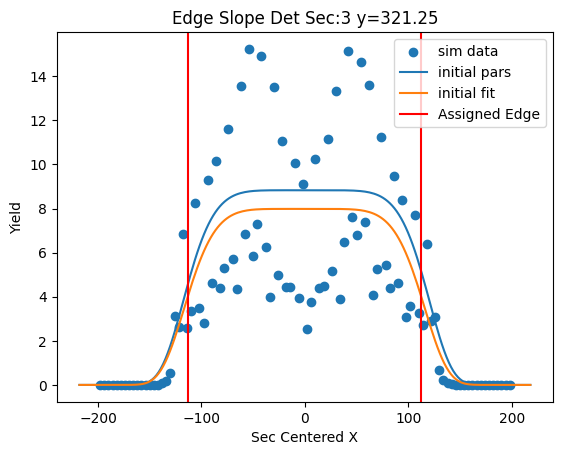

[ 6.62956399  0.7290611  85.34327962  7.30503804]


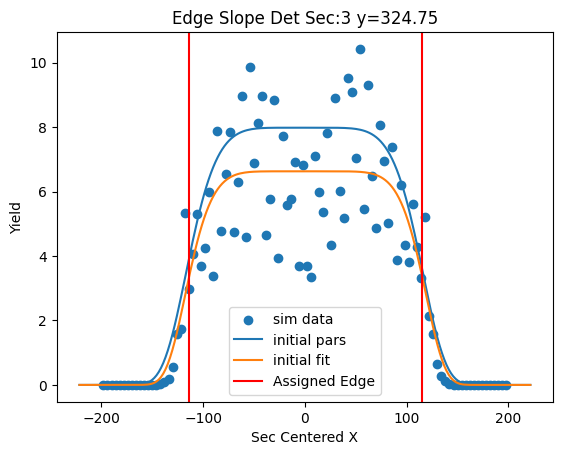

[ 7.58454665  0.43187624 87.06440826  6.78094137]


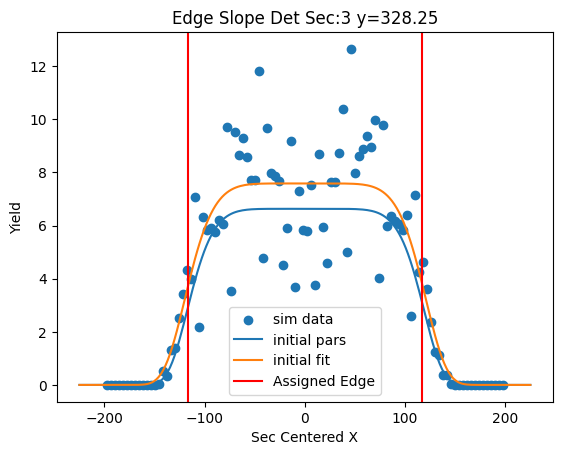

[ 5.32288695 -1.3947591  90.13014452  6.05736813]


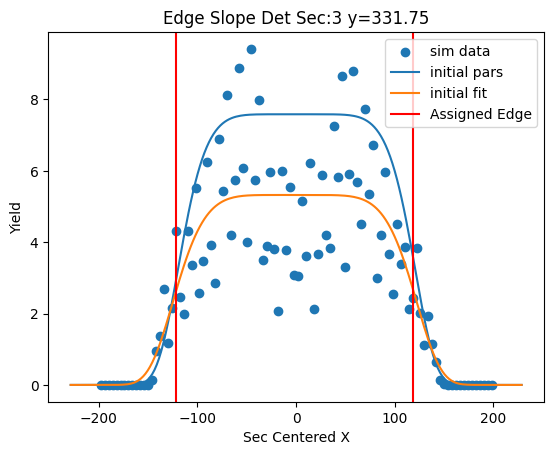

[ 7.25041101  0.45214653 93.01340851  6.18135999]


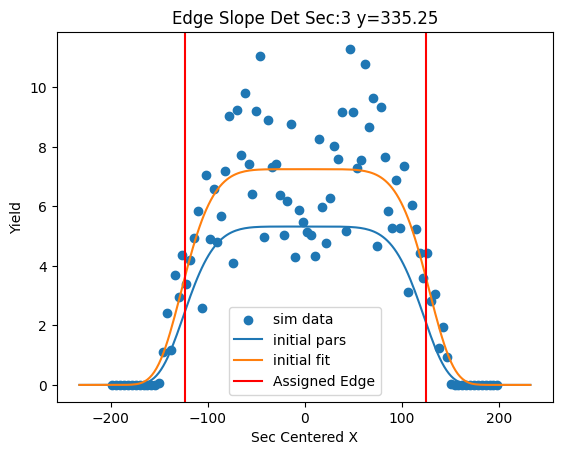

[ 5.00868405 -0.82647043 92.45666823  5.67255018]


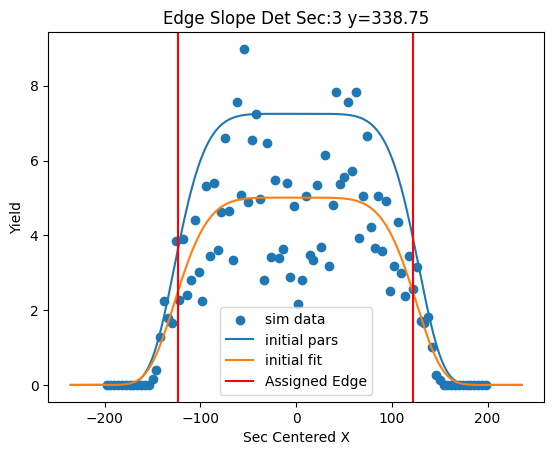

[ 5.17643331 -1.88742545 92.12335901  5.74997171]


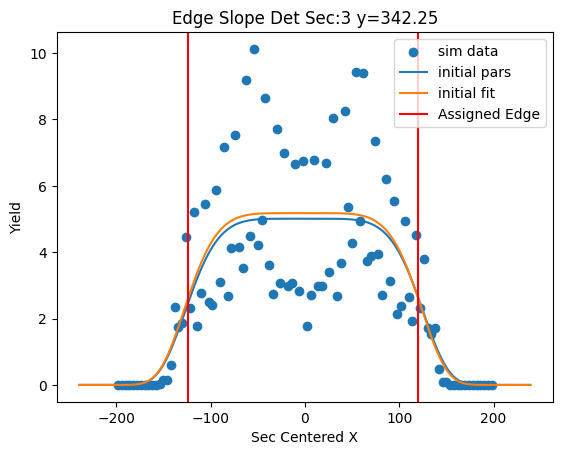

[ 4.66281735  0.84221432 95.2945189   8.45956026]


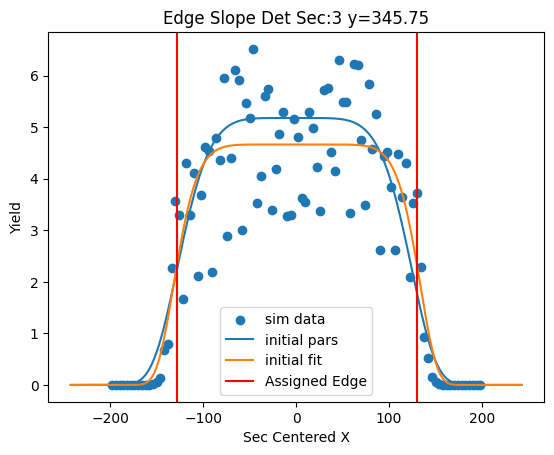

[ 4.02719342 -1.17912996 96.4703853   6.56262012]


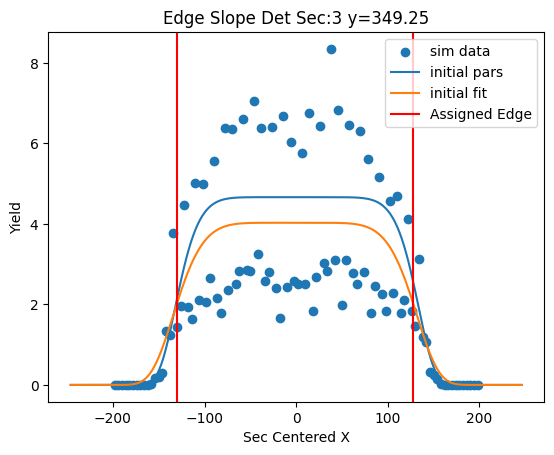

[  3.16750573  -0.12483033 102.02260972   7.63264156]


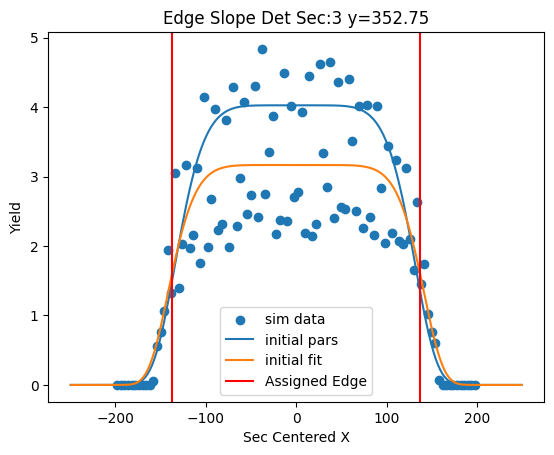

[  4.17203874   0.30204793 102.9687436    7.40390382]


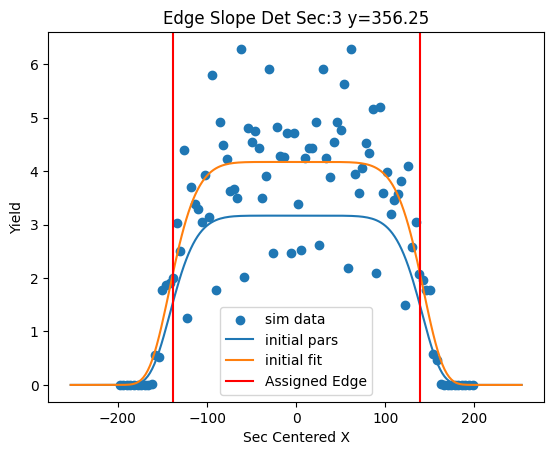

[  2.55329389  -1.25567625 103.69035233   6.90612497]


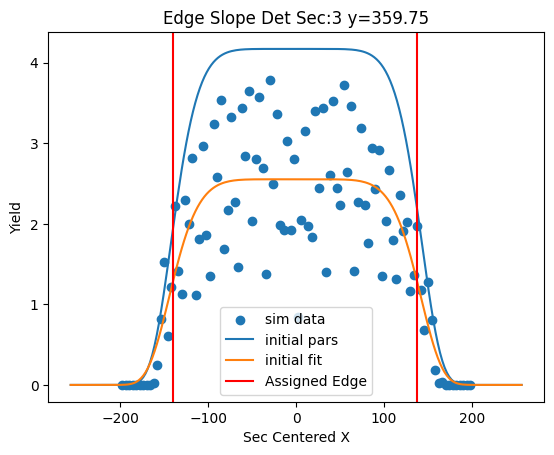

[104.82452174   0.98878912  30.18769579   5.23047538]


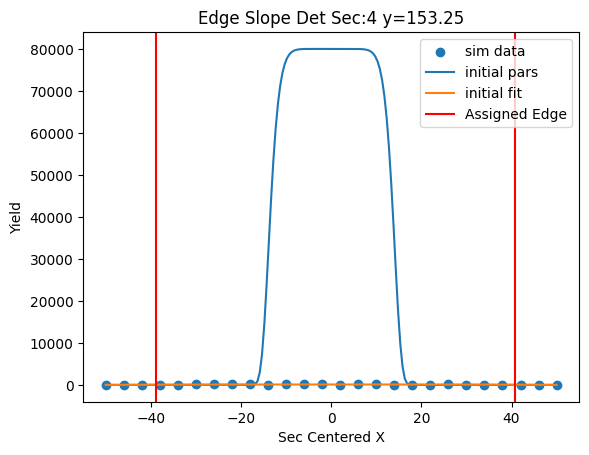

[120.07495945   1.48952571  39.58380779   3.86346582]


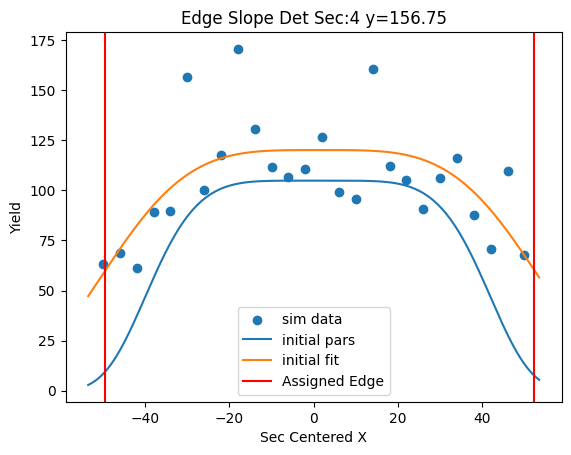

[85.1522296   0.99244435 35.42685387  9.70948486]


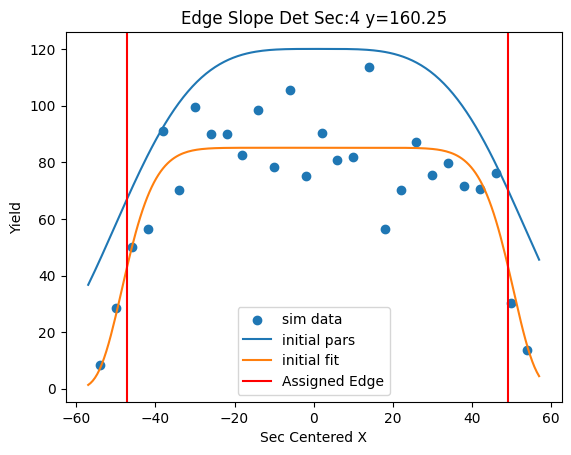

[88.10594006  0.95208354 34.72270913 10.44882863]


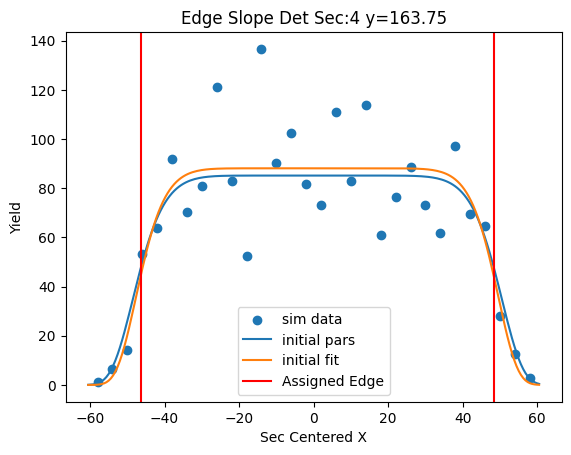

[92.08759771  1.52266331 35.2372906   6.1809391 ]


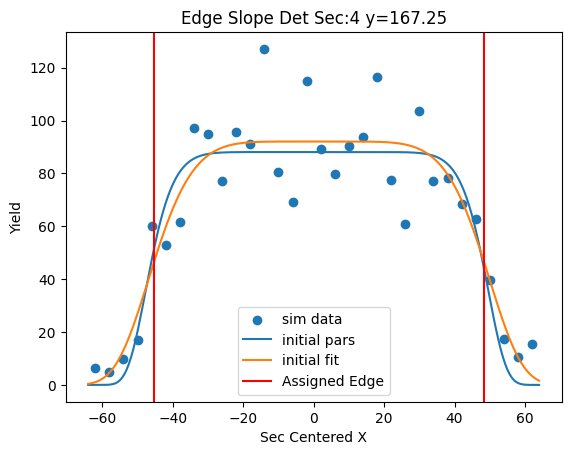

[78.16478785  1.69006043 40.45146363  4.5796383 ]


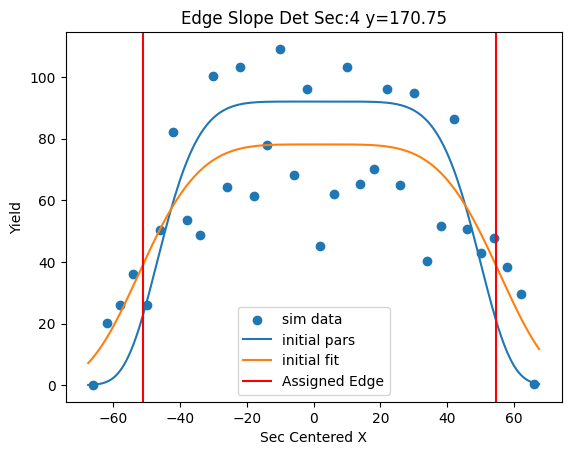

[67.32586196  1.26358034 41.77011696 11.073536  ]


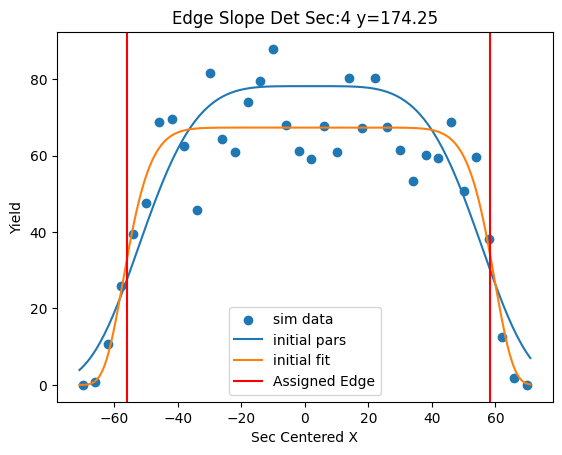

[76.34411374  1.08826883 41.36596382  9.95704088]


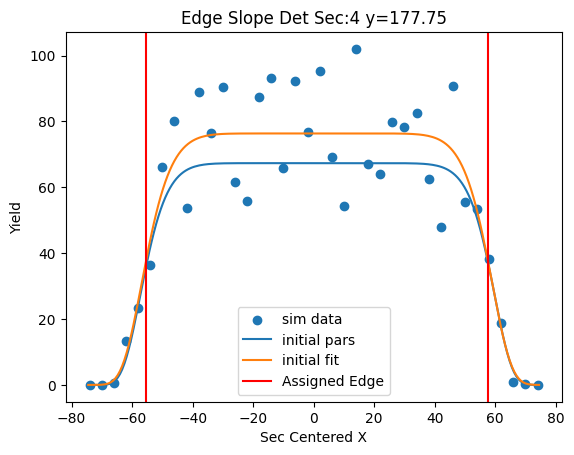

[58.93812717  0.52818747 40.40805254  8.12755289]


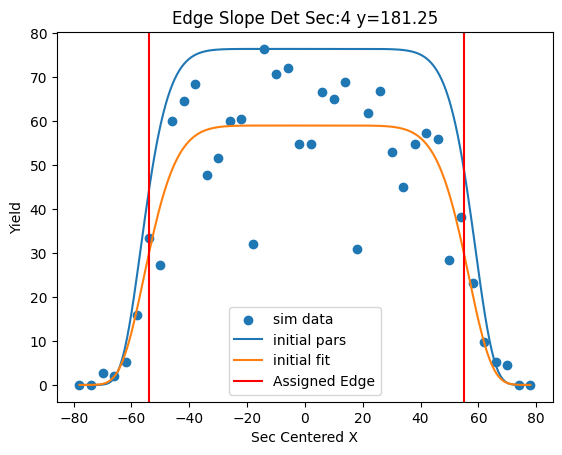

[68.84442379  1.49549103 44.9444053   5.27757513]


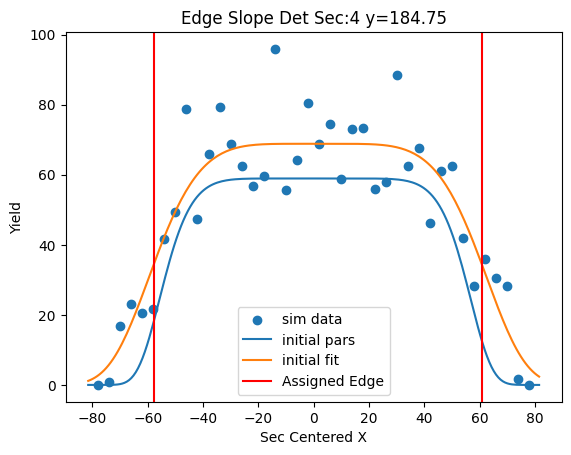

[51.1186243   1.18321894 47.63801187  7.85803974]


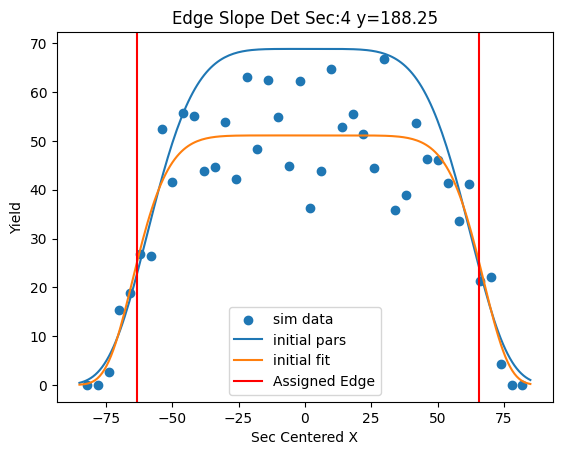

[50.6845009   0.64714373 45.21847387 14.10656358]


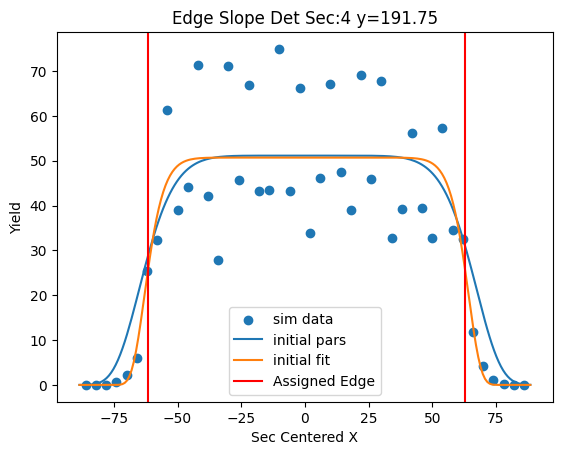

[54.51843261  0.27610567 44.30840611 10.5259955 ]


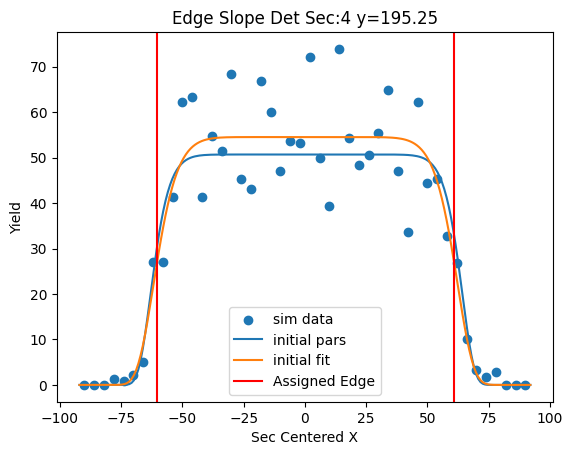

[ 4.48867627e+01 -4.57559895e-02  4.68771499e+01  7.31902350e+00]


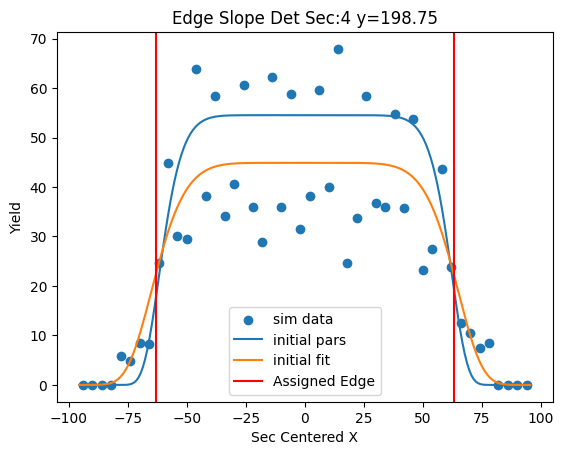

[39.18609469  0.59089683 52.61117672  6.14173352]


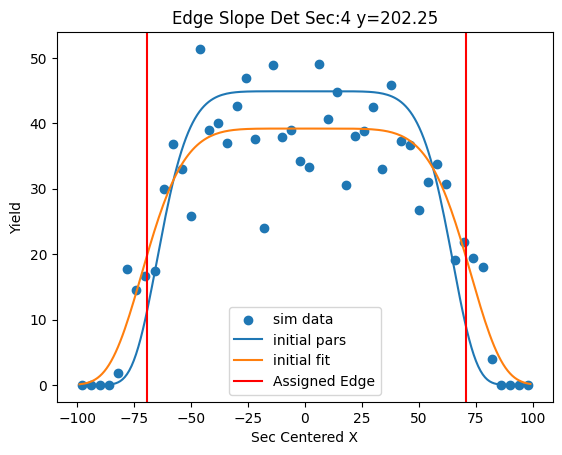

[48.24470574  0.72641158 54.05683159  8.52841988]


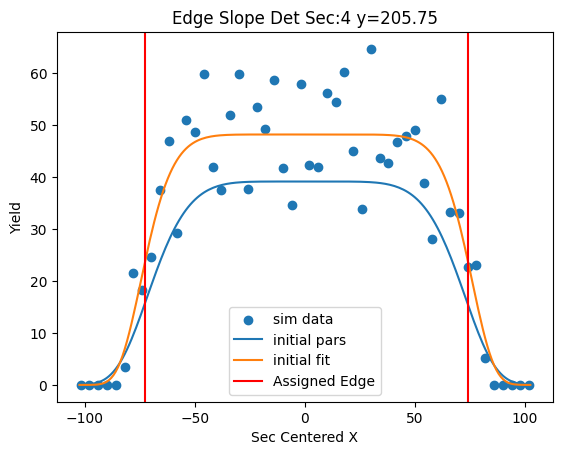

[34.61018442  0.29751784 50.66895077 10.72355282]


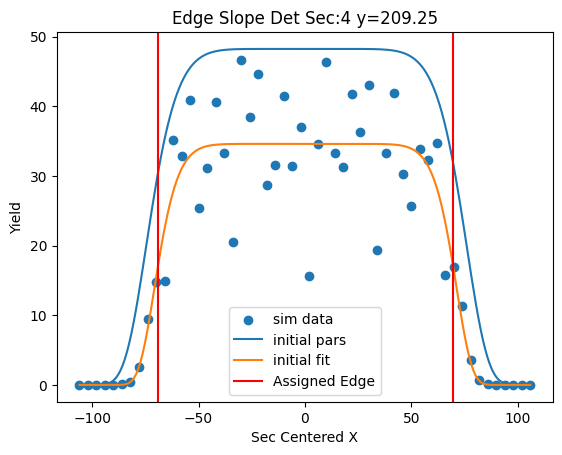

[42.66587405  0.94910635 53.10956915  9.60423868]


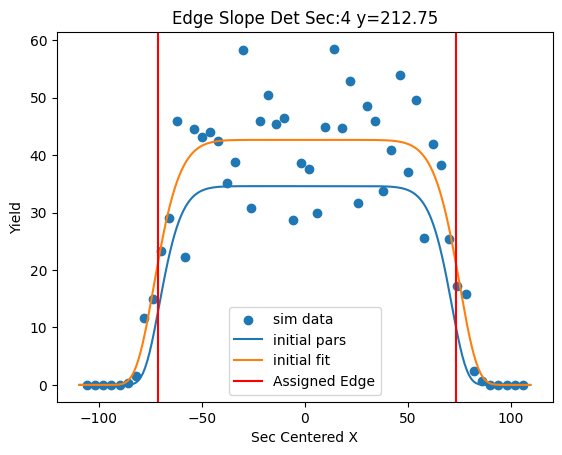

[34.02871765  0.64787151 54.0380703  12.34391109]


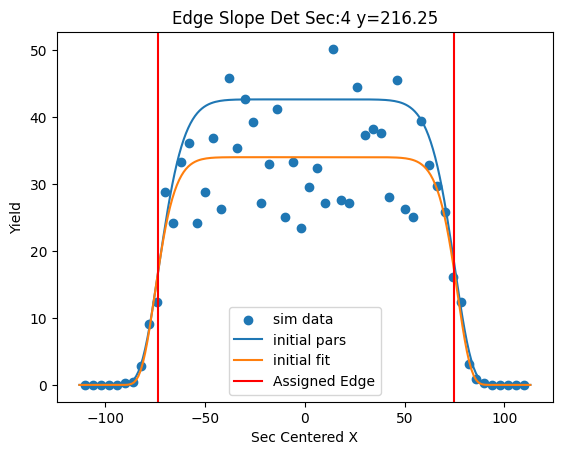

[32.79399043  0.15734472 54.55363881 11.68543589]


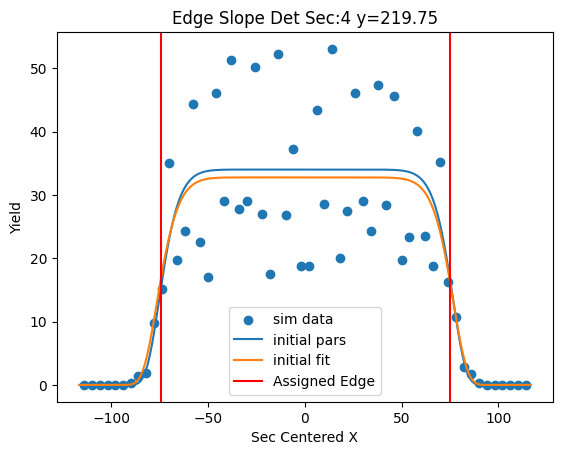

[34.6595488   0.55567695 55.44603077 10.41737412]


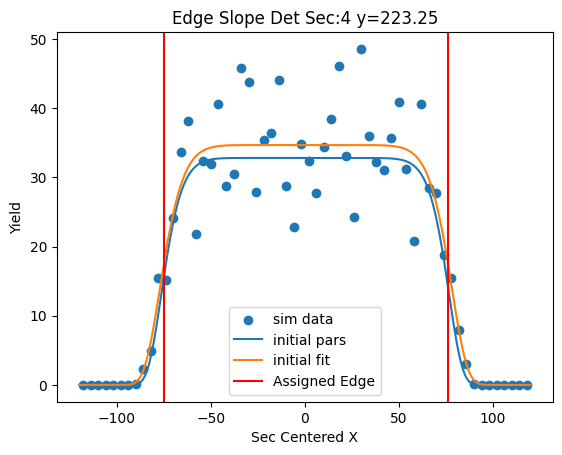

[28.10848204 -0.10884921 53.73934721 10.33893734]


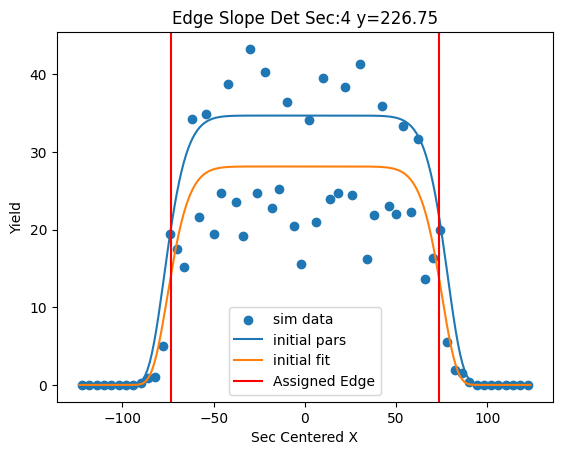

[2.54651332e+01 3.75786323e-02 5.50603485e+01 1.02797406e+01]


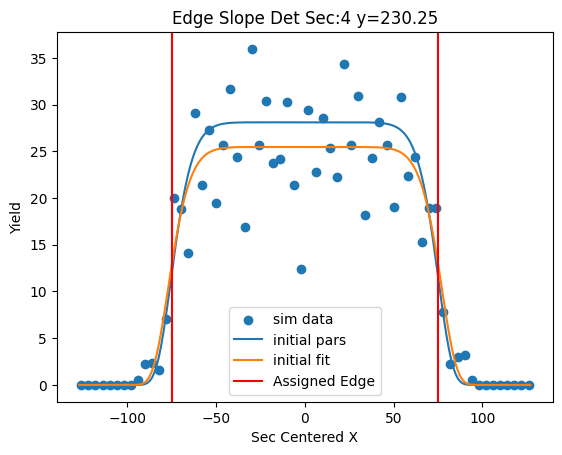

[32.92938564  0.63980315 59.55363401  7.02086939]


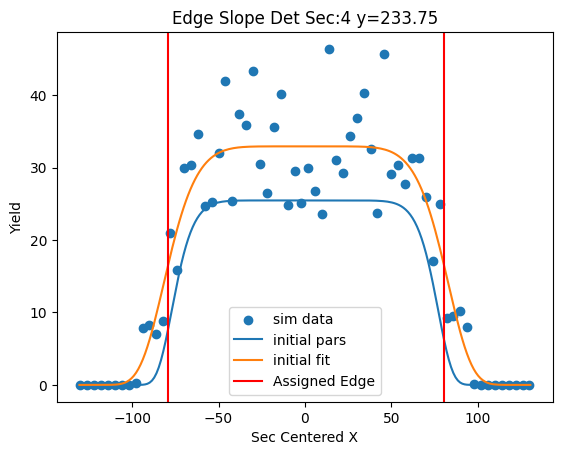

[21.10371092 -0.30393328 63.47498355  8.08439423]


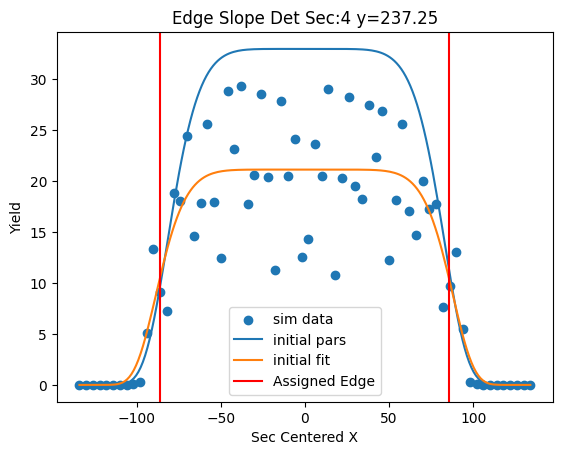

[24.38350359  0.23208295 62.6066061  10.7994142 ]


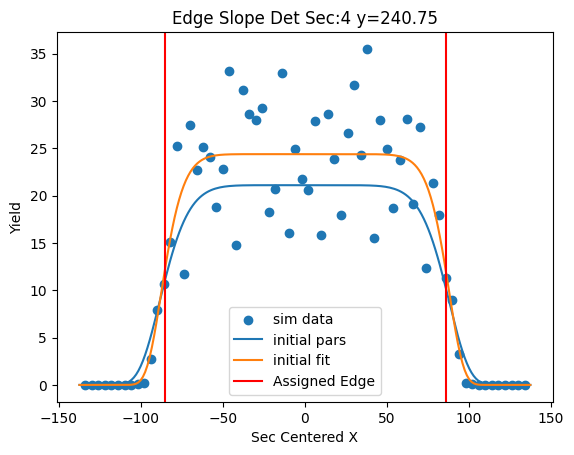

[ 2.22765078e+01 -5.76500281e-02  6.14491881e+01  1.29339938e+01]


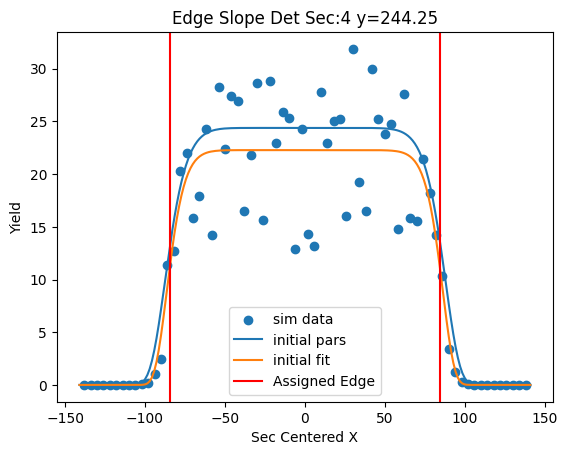

[21.87209988 -0.74790776 63.90495026  8.92178789]


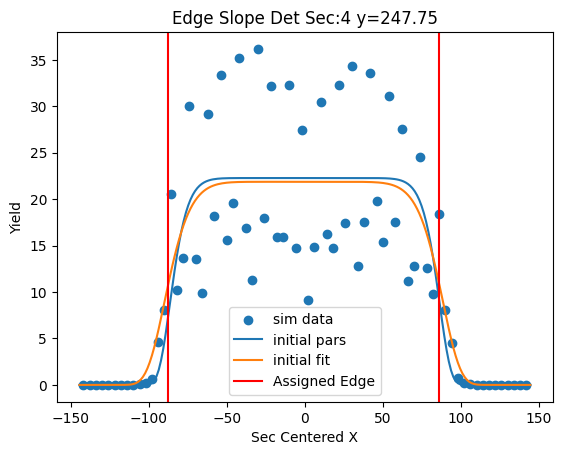

[22.23292675  0.25515696 65.88255022 11.5055564 ]


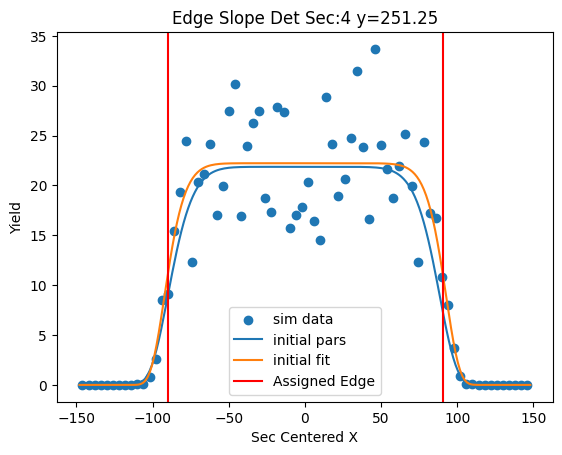

[17.49836756 -0.37306386 66.43433489  9.31532367]


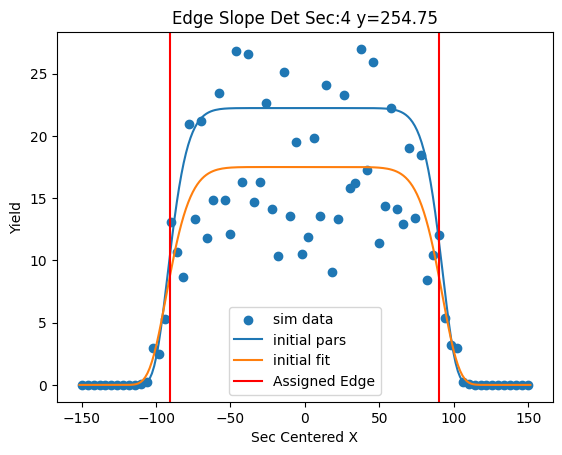

[17.1123452  -0.2703285  67.12360945 10.60284212]


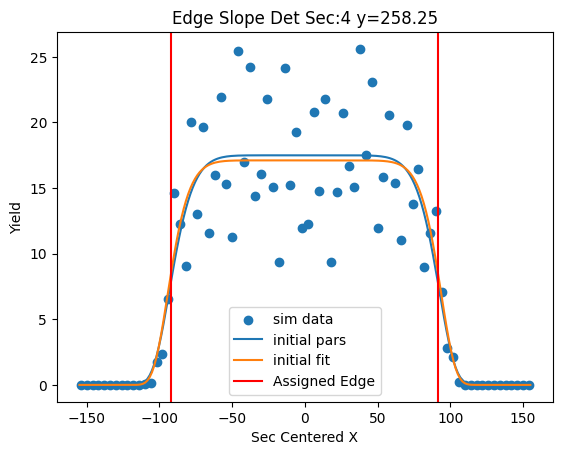

[23.01868819  0.21379419 65.28452545 13.08575874]


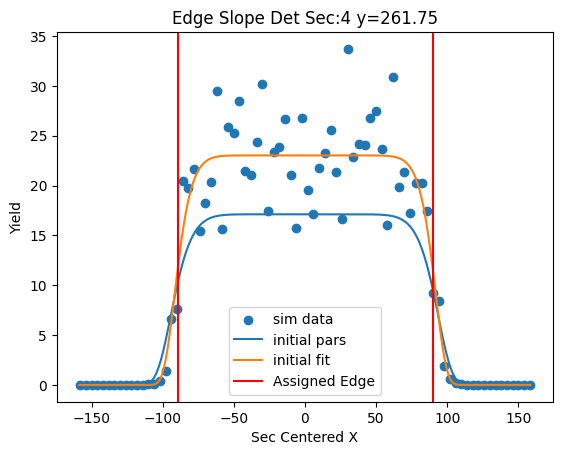

[14.96584642 -0.30965837 64.6892382  11.67980799]


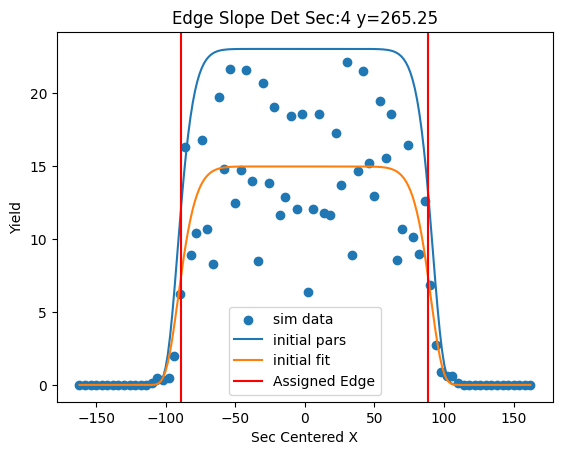

[16.87846054  0.9550874  68.38531695  9.08336487]


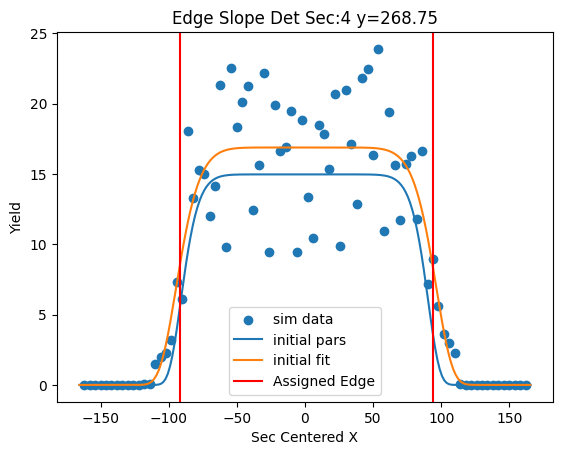

[16.15155454  1.2066312  72.43576609  7.81605973]


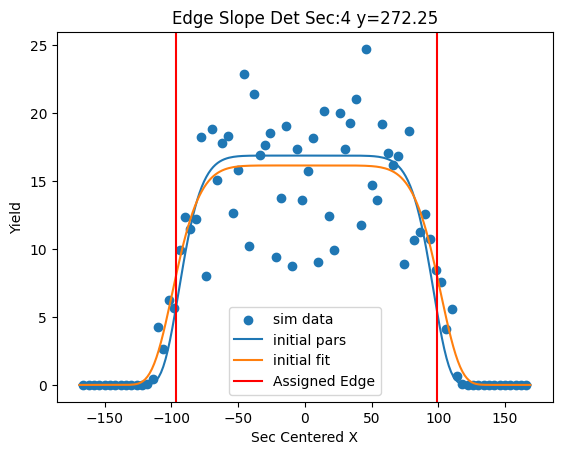

[ 1.29921588e+01 -6.36371218e-02  7.43121935e+01  7.57878941e+00]


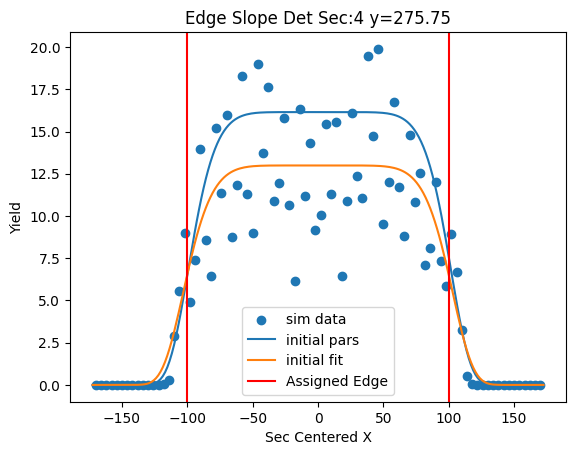

[17.54245511  1.12630335 74.95215842 10.59751335]


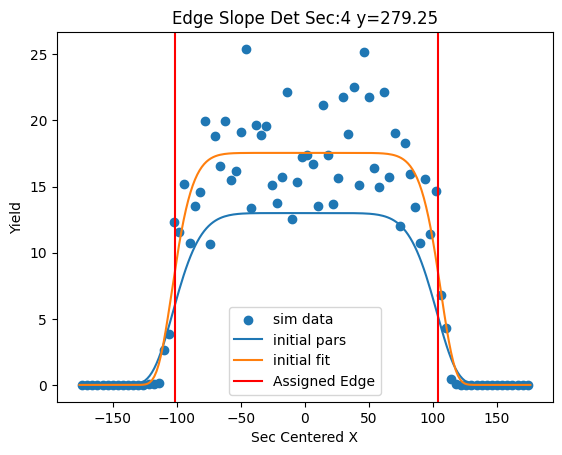

[12.81161029  0.58664927 74.27084498  8.68591268]


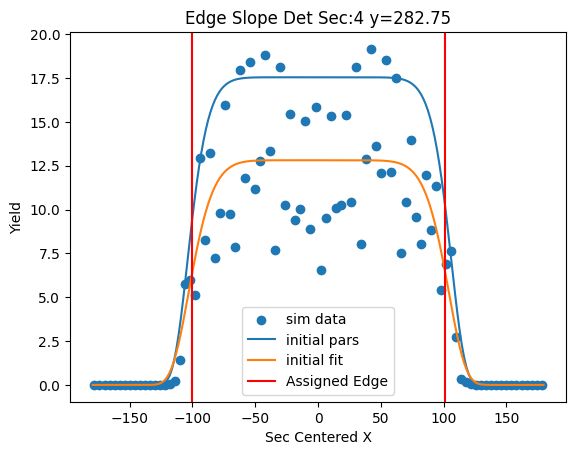

[12.28811458  1.12266024 75.42475143  8.53867622]


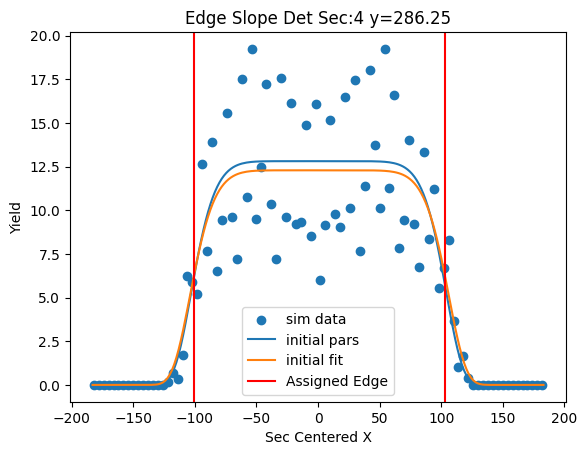

[14.06735563  3.2178882  78.20021156  7.69060255]


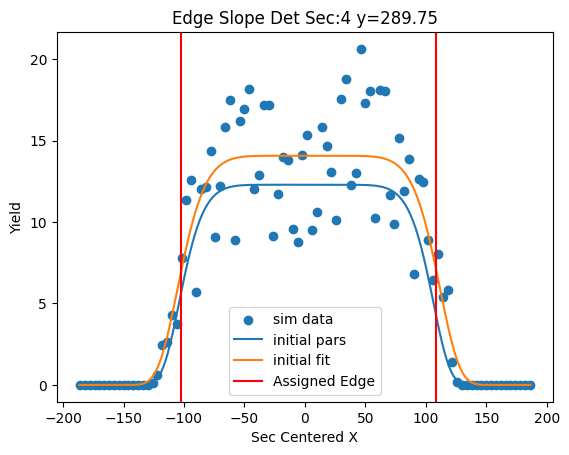

[12.36910382  1.80216937 79.98055747  6.11006494]


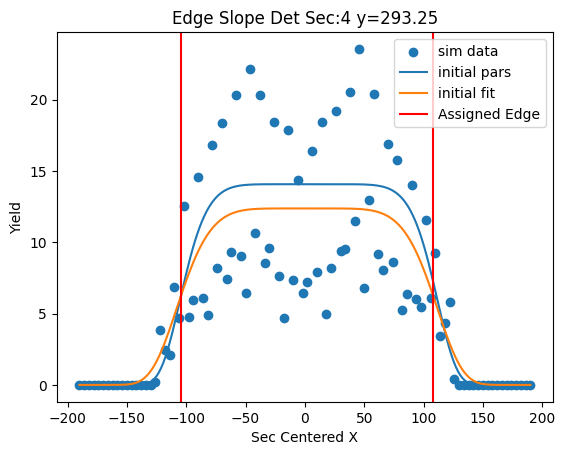

[11.00740327  2.32054521 81.94997479  7.18970746]


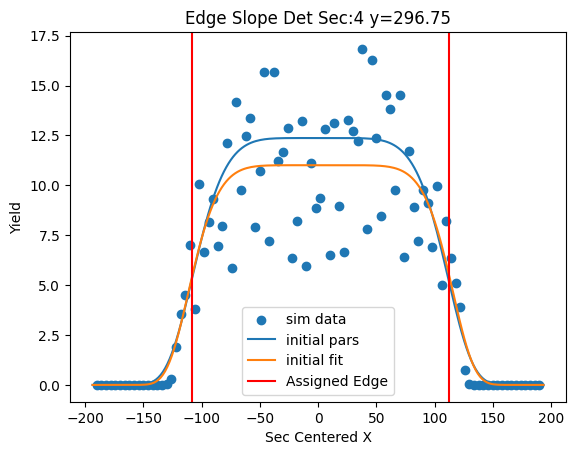

[11.42140224  1.6199217  81.095081    7.59026928]


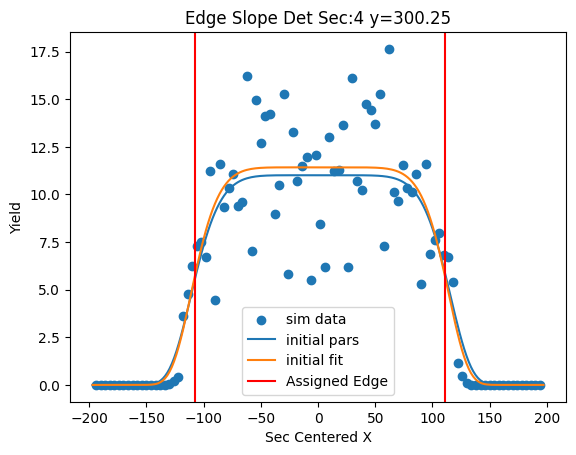

[ 8.63884771  0.48839836 78.37404944  7.37578357]


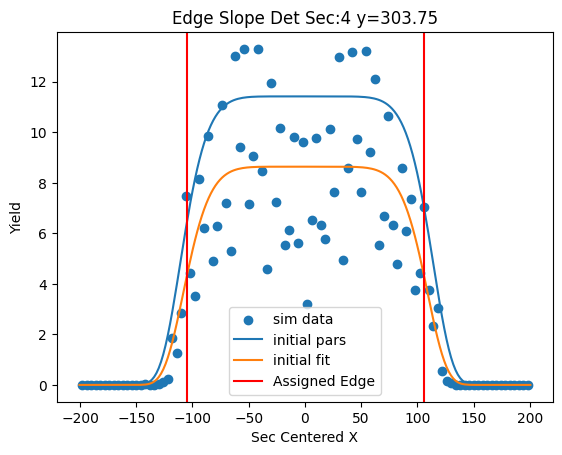

[12.03321951  2.03317113 80.84073179  7.49602363]


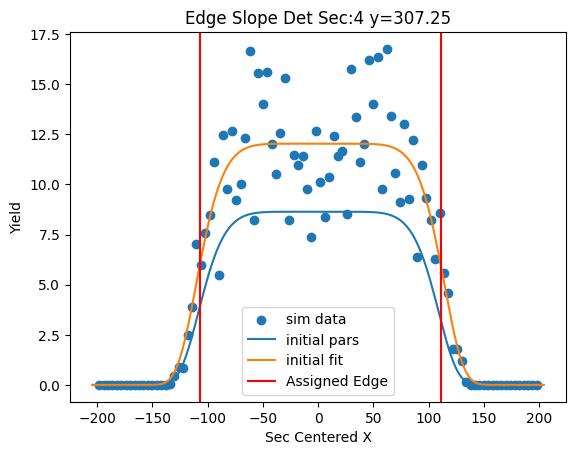

[ 8.04030963  0.7009964  83.37876146  6.35027152]


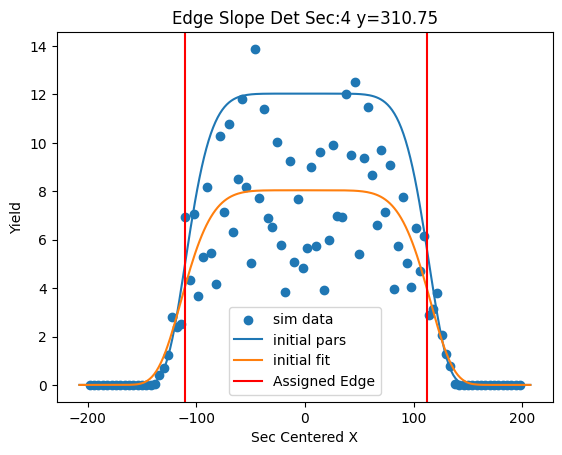

[ 8.10503966  0.82679757 84.92538324  5.72259791]


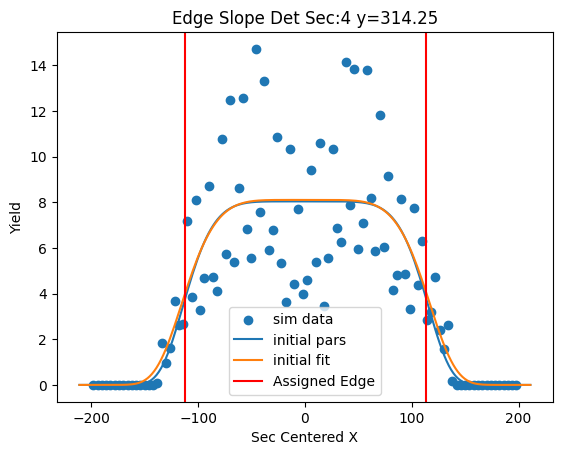

[ 8.69181072  2.58575709 87.20665532  6.48658686]


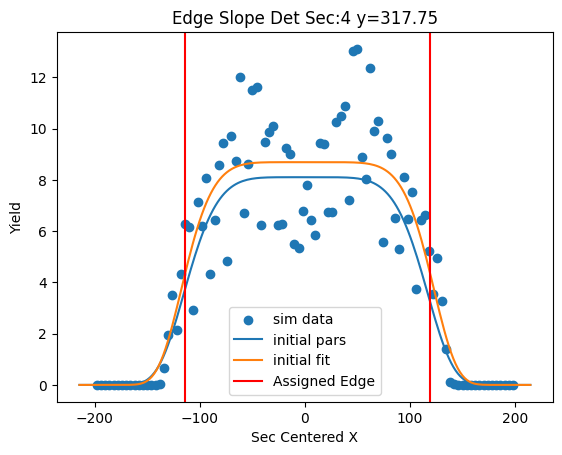

[ 7.80555600e+00 -7.35250918e-02  8.53918818e+01  6.11136651e+00]


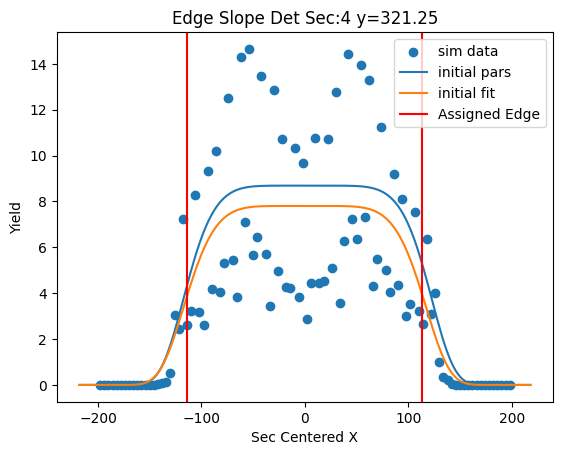

[ 6.3615664   1.69943613 86.09756758  7.58034401]


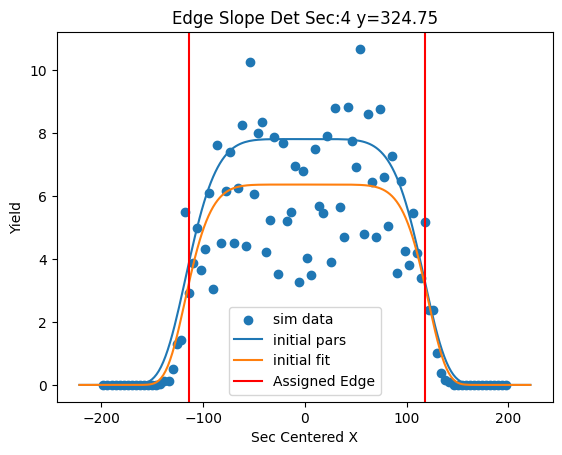

[ 7.28036676  1.7130654  87.79330343  7.37841308]


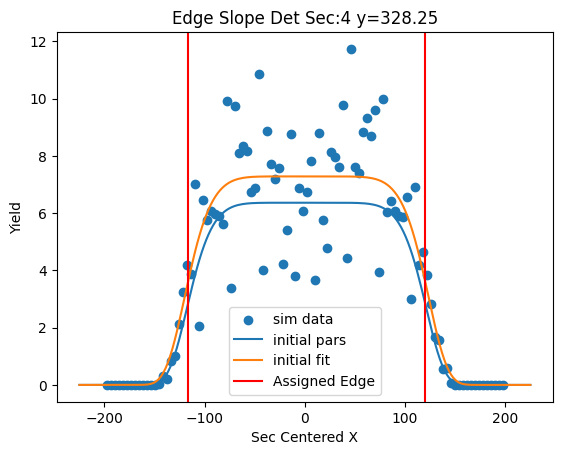

[ 4.89647741 -0.19593592 90.97566026  6.47022879]


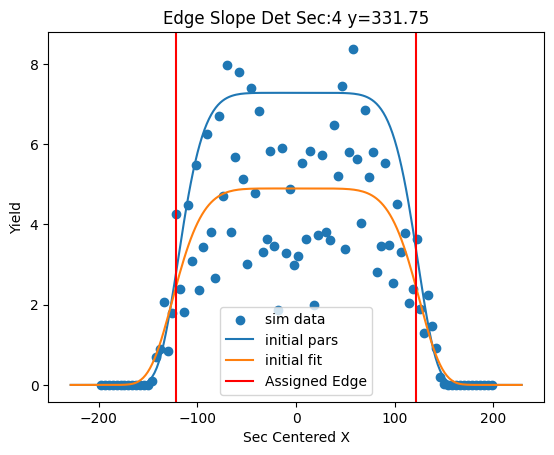

[ 6.98604208  2.66007715 93.0314002   6.16164024]


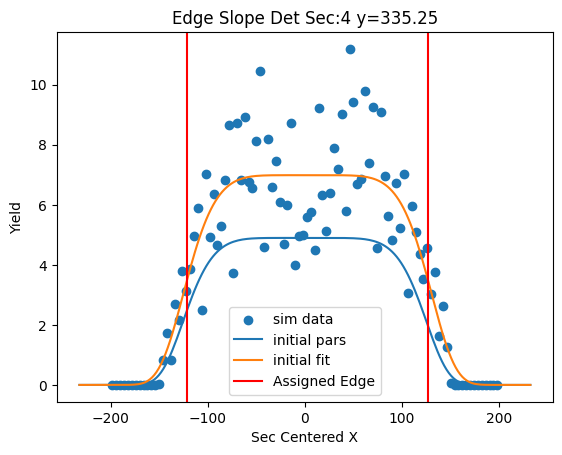

[ 4.57048615  1.16290847 93.07055641  5.8986936 ]


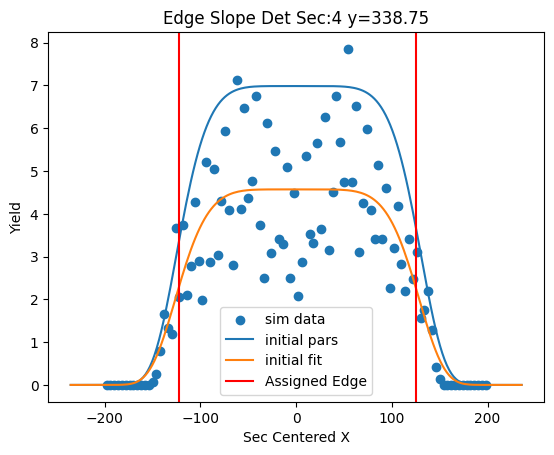

[ 4.69949365  0.38068237 93.31178068  6.22645046]


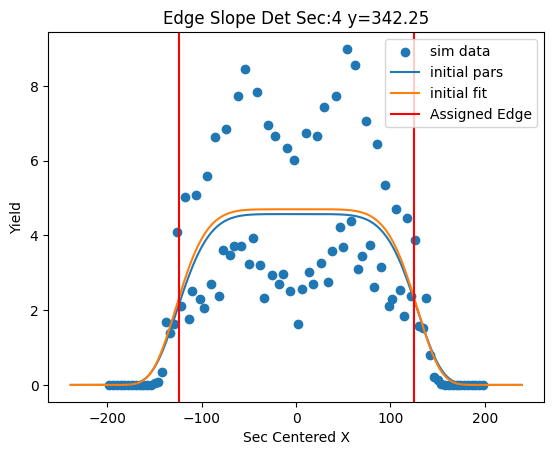

[ 4.5040282   2.48993746 95.27626961  8.43668266]


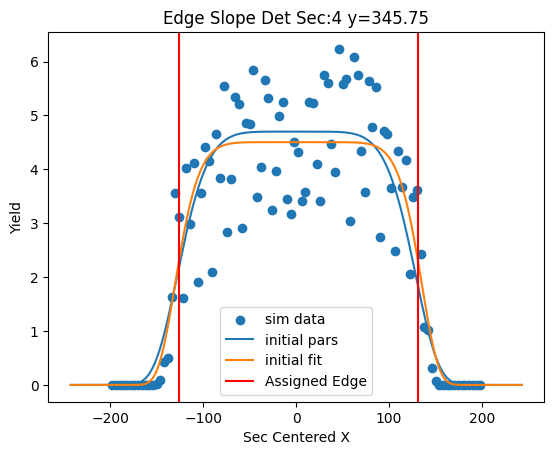

[ 3.84084035 -0.46474751 95.9919991   6.99552665]


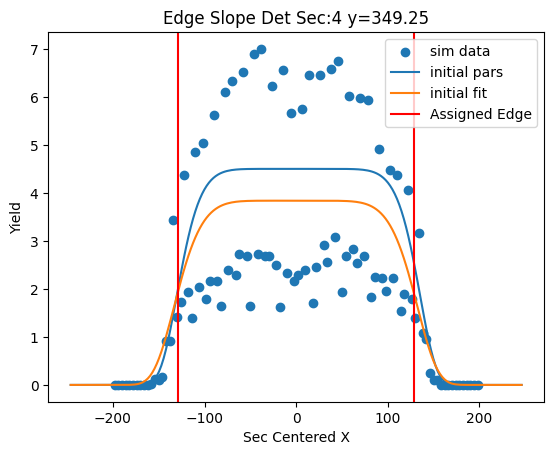

[  3.07896749   0.89791579 100.65994379   7.3164088 ]


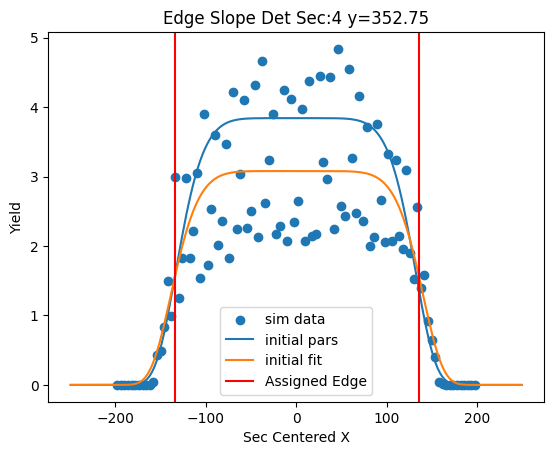

[  4.05794458   1.07369722 101.26239551   7.40099187]


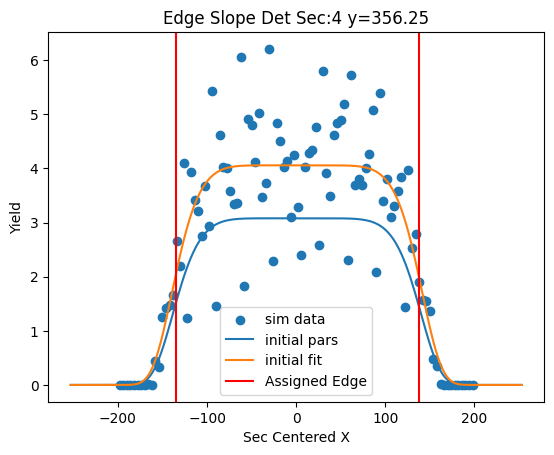

[  2.38767021  -0.8302763  102.4197445    7.06415605]


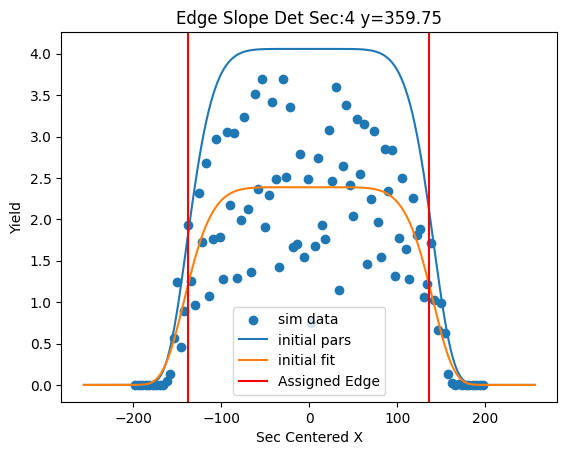

[257.23808677  -0.683372    27.50527478   5.91669475]


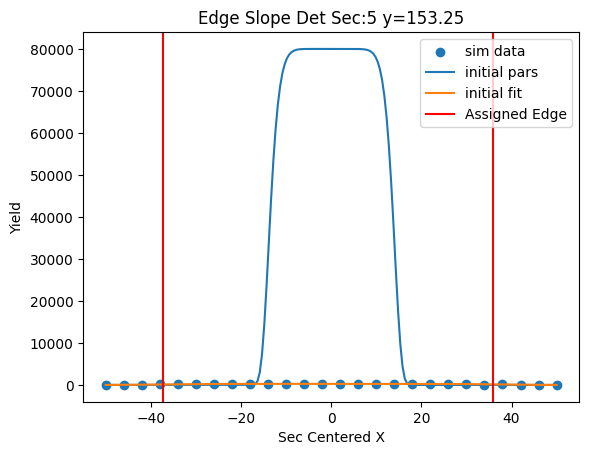

[293.57228035  -0.81195482  33.96206882   4.75114978]


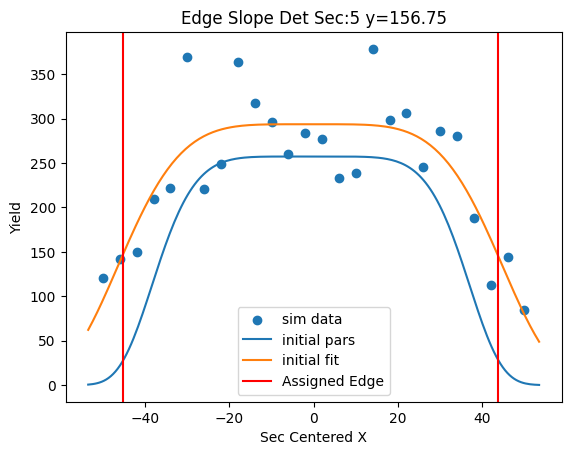

[202.80085825  -0.39845746  34.06078853   8.98441406]


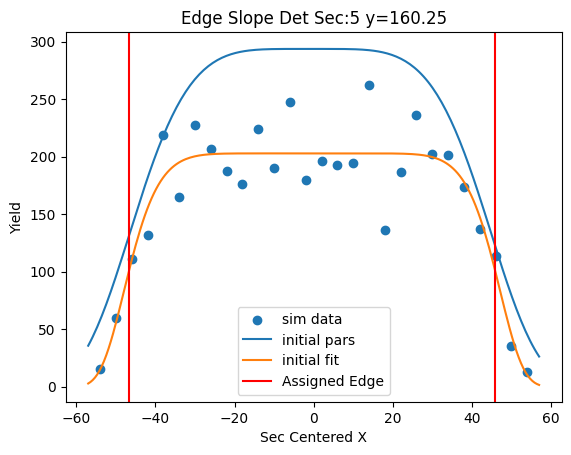

[203.60893976  -0.54775904  33.86413345  11.28440808]


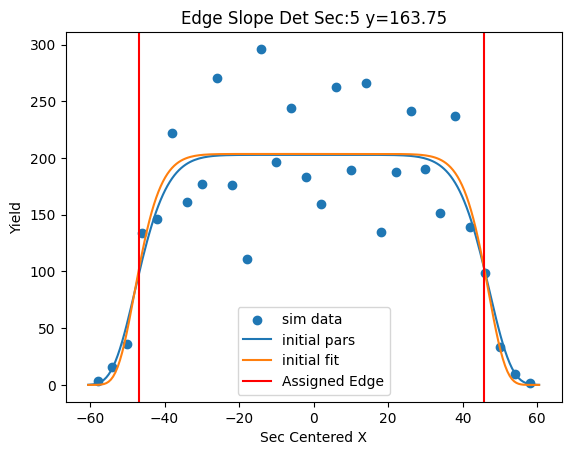

[204.76278225  -1.4447794   34.32072512   7.59914482]


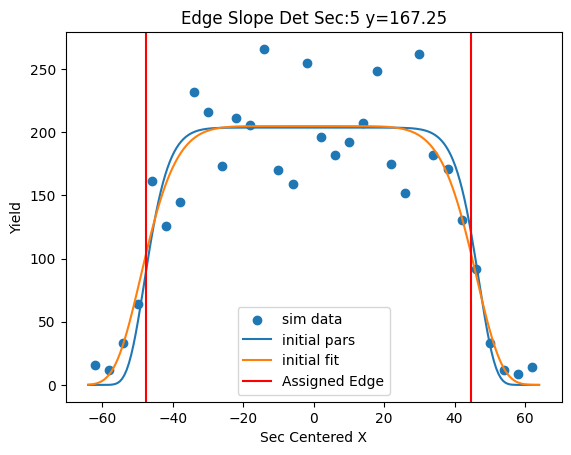

[163.99001709  -2.81419063  38.83347032   5.07771578]


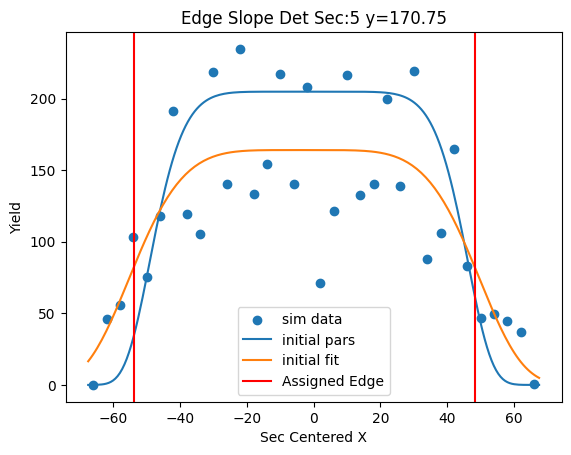

[142.68814019  -1.69867712  40.84064574   9.5410827 ]


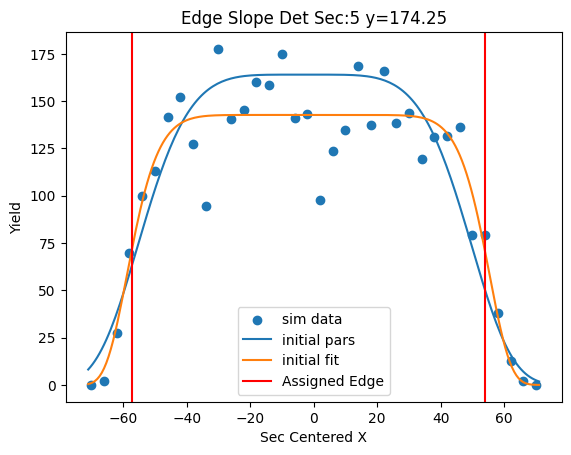

[159.70304834  -2.12103853  40.93076263   9.63413378]


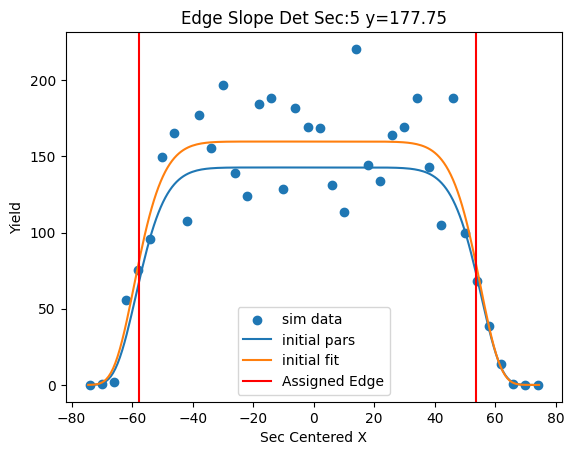

[118.14057354  -2.30925443  40.3394665    8.67462123]


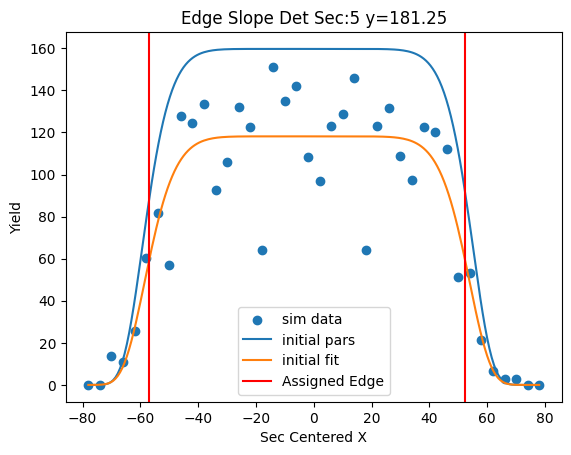

[137.42976013  -3.15876334  44.68043804   5.7528393 ]


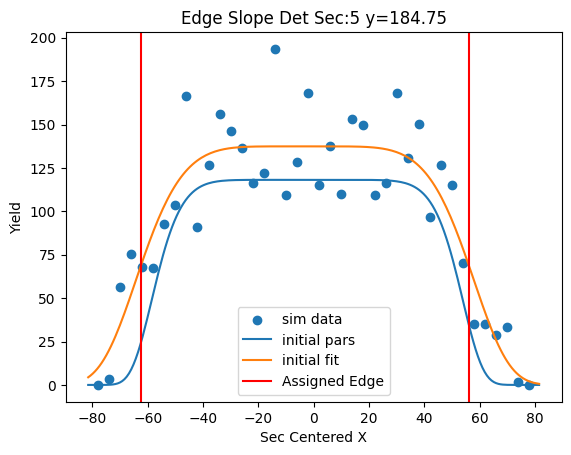

[100.37918828  -2.63215313  47.09777847   7.76949936]


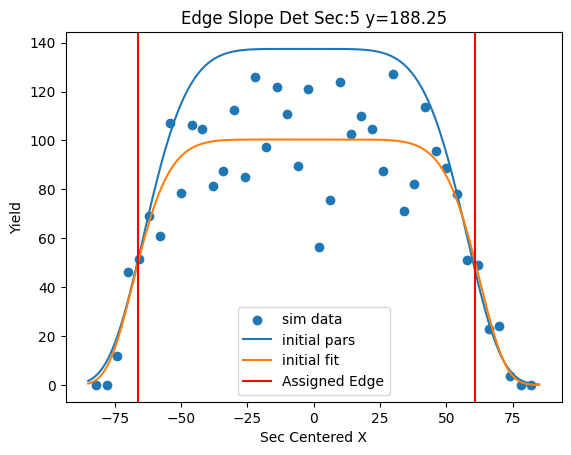

[98.98049998 -1.33720572 44.98859729 13.79852471]


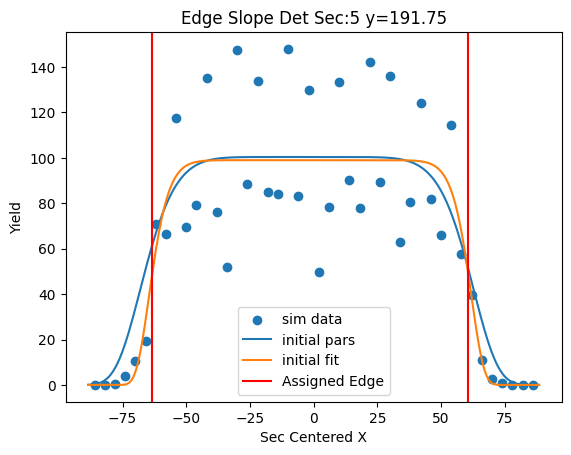

[ 1.04177382e+02 -4.70825163e-02  4.43423903e+01  1.06353263e+01]


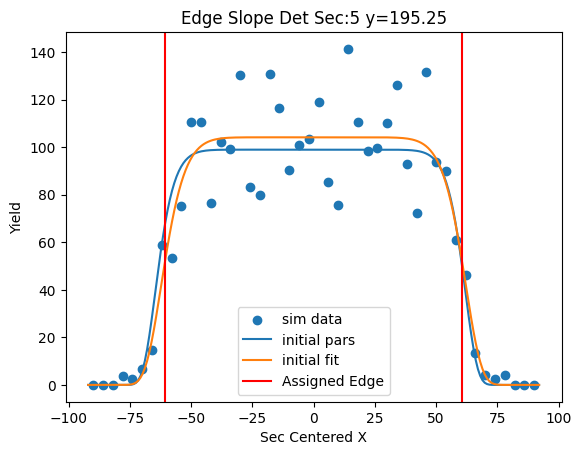

[8.19722305e+01 4.76598226e-02 4.74279247e+01 7.40024391e+00]


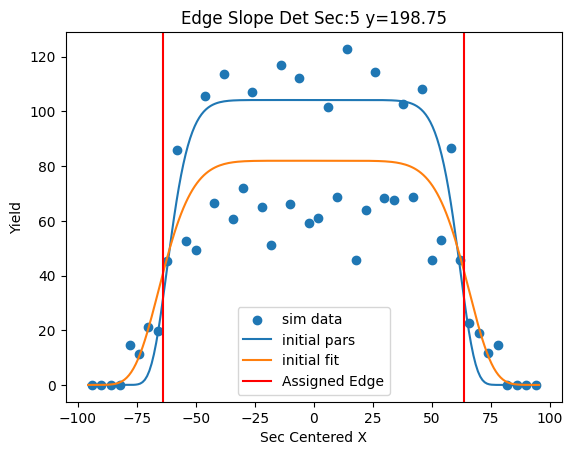

[71.93933084  0.24593504 53.12990468  6.62414451]


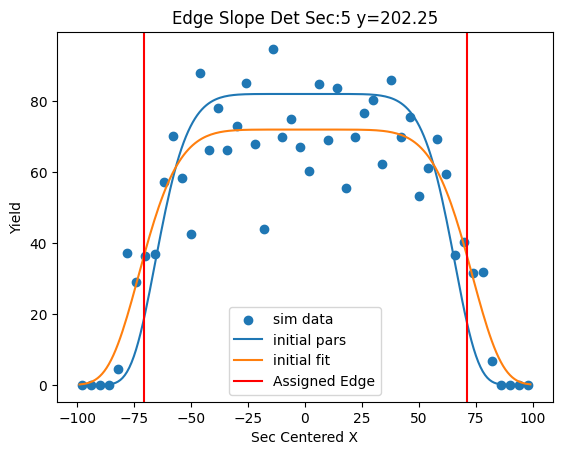

[87.50790819  0.21275669 54.33652527  9.13709078]


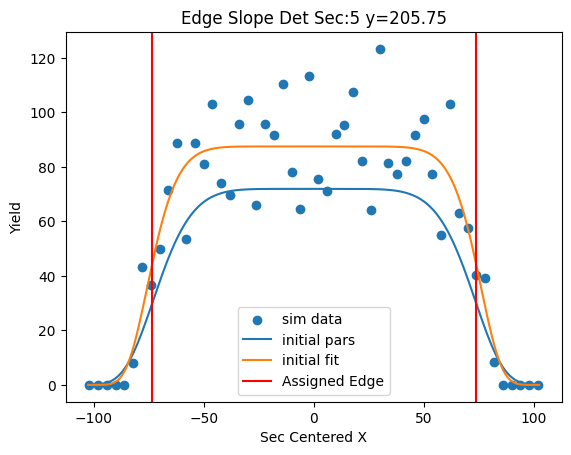

[58.83442902 -0.08882645 51.24785095 10.84013125]


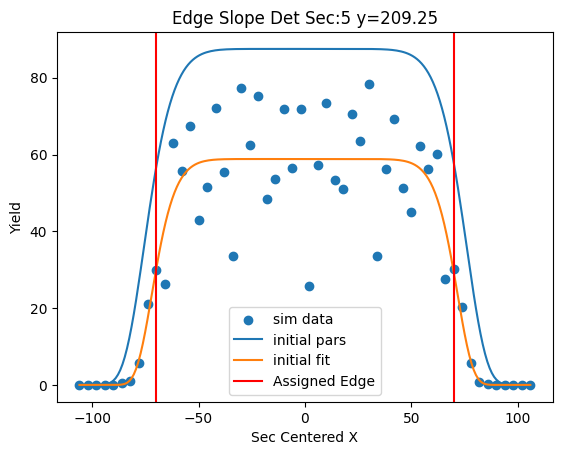

[70.24853338  0.38557905 53.85408473  9.54353804]


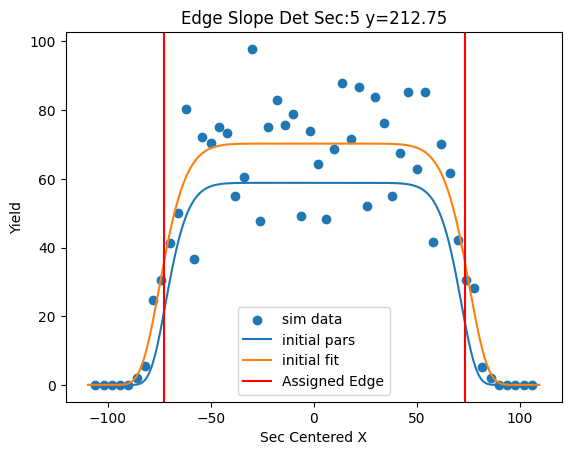

[54.79056871  0.13100759 55.05499375 12.04091768]


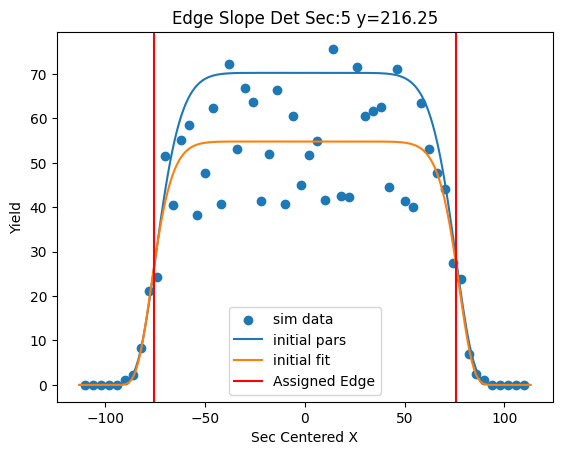

[ 5.32665103e+01 -3.76039588e-02  5.55301974e+01  1.12594837e+01]


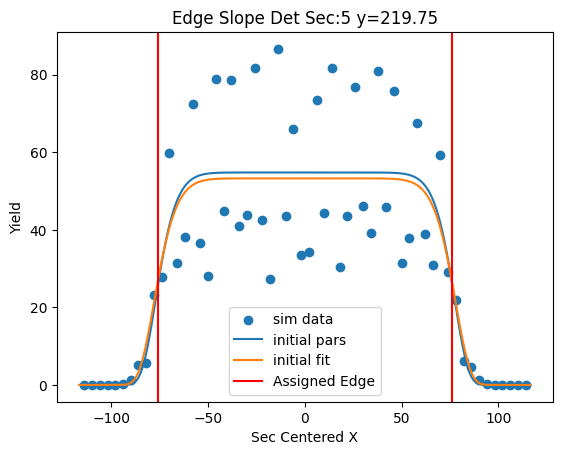

[55.91171806  0.31079455 56.55000591  9.97458803]


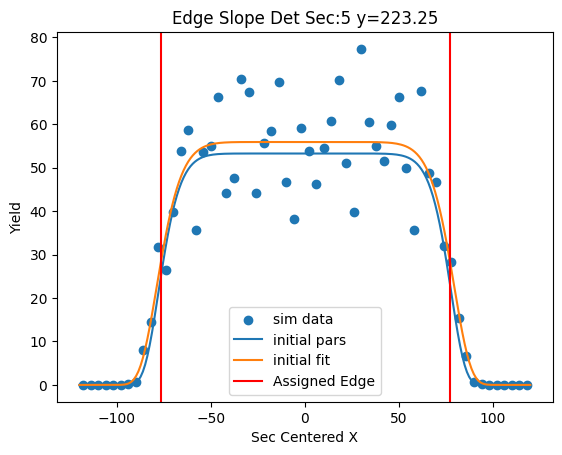

[43.7415198   0.08085114 54.18415244 10.53952595]


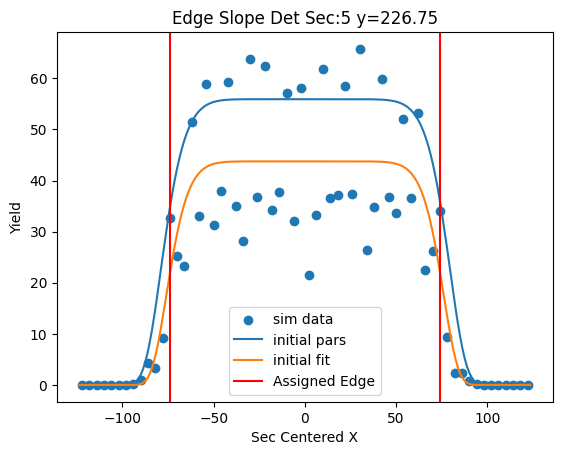

[39.37811789  0.47652114 55.12495746 11.08390873]


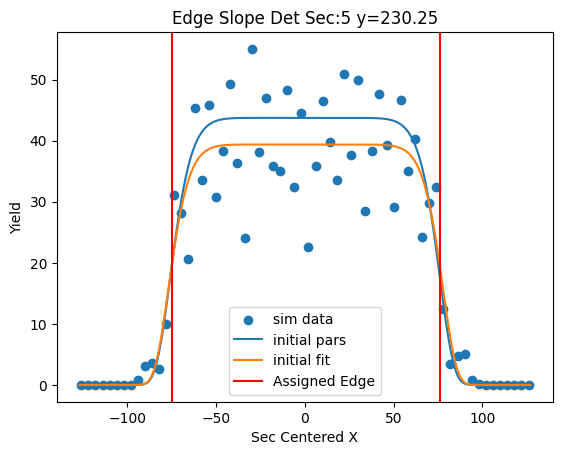

[50.96993107  1.55665229 59.36949392  7.43873387]


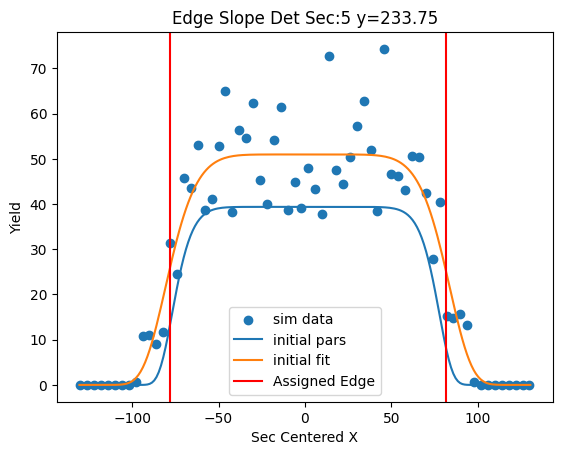

[31.692648    0.61509475 63.24454099  8.12553043]


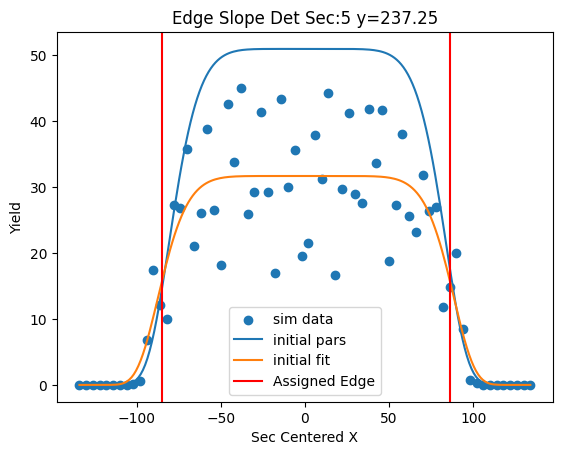

[36.45374151  0.87482958 62.57162639 11.21301347]


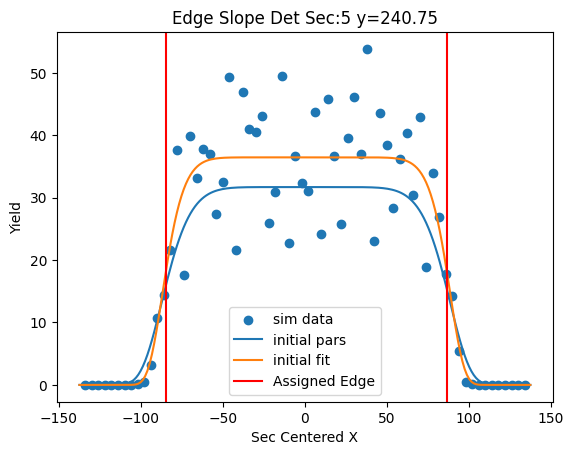

[32.48905085  0.51360992 61.49352608 13.83816634]


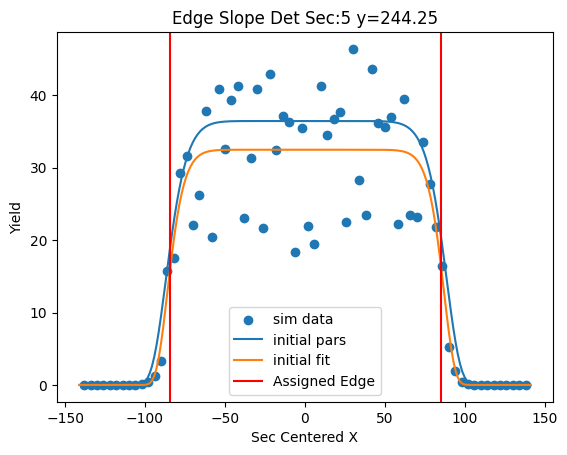

[3.18028814e+01 4.46991254e-02 6.39452260e+01 9.36786632e+00]


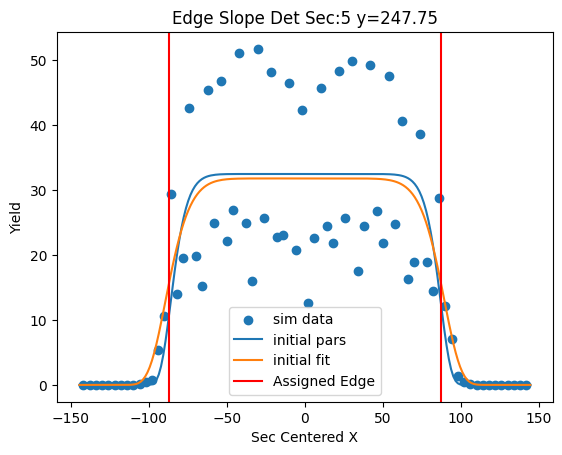

[32.23906503  0.93772823 65.62939189 11.90011384]


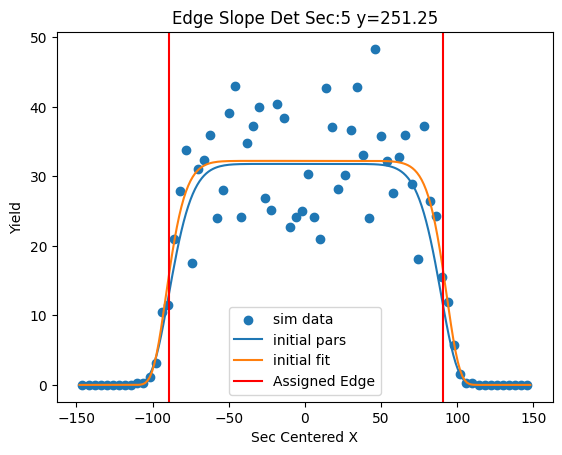

[24.44645281  0.27204443 66.08844487  9.35599966]


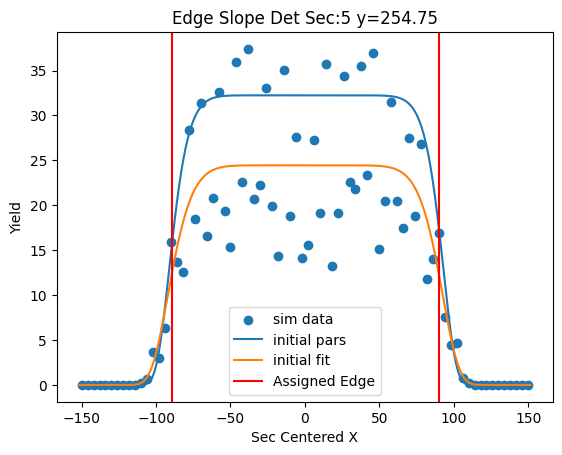

[23.44504235  0.09145403 66.75713963 10.44670275]


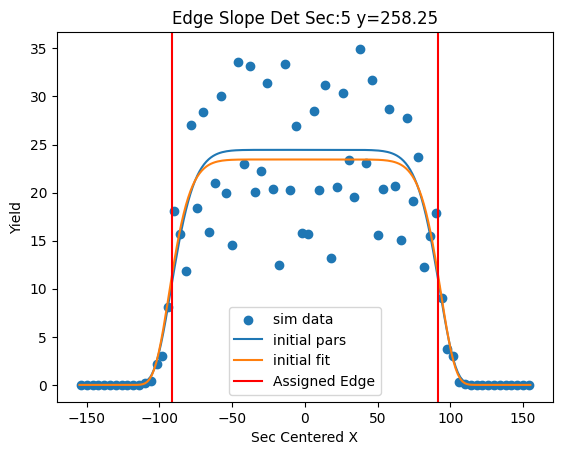

[31.33485103  0.37844106 64.89208353 12.72956814]


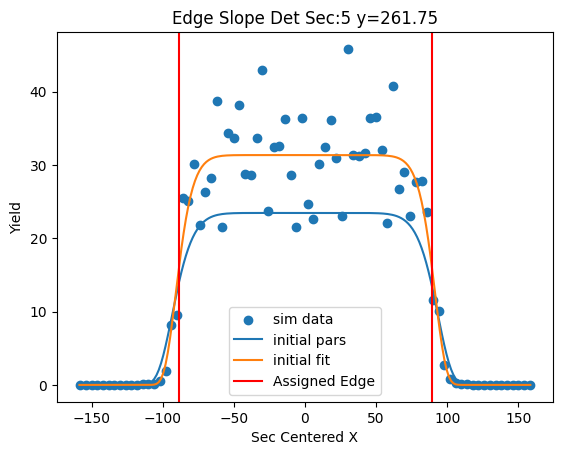

[19.86833934 -0.57298681 63.94482721 11.19531142]


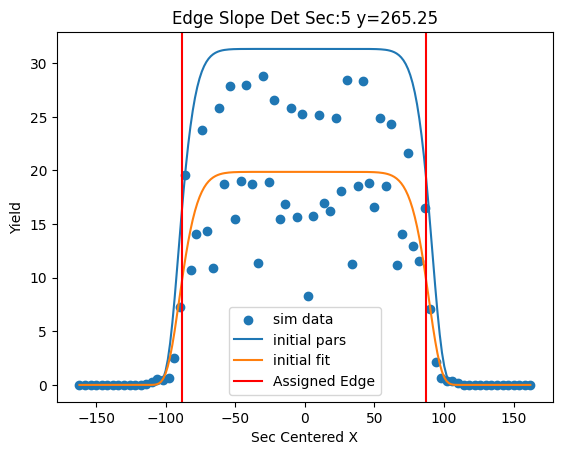

[22.46996252 -0.09182866 66.44626995 10.62965316]


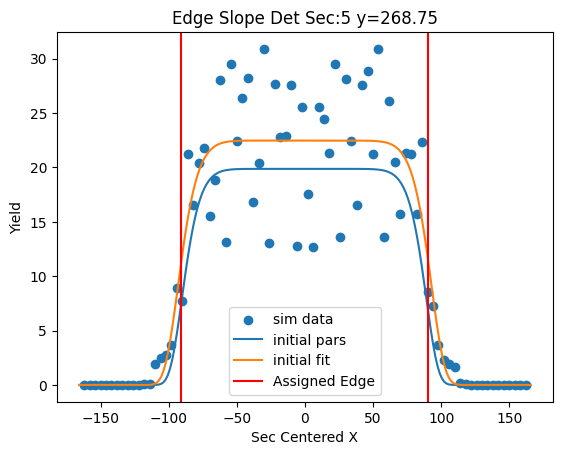

[21.25298952 -0.18669622 70.18026828  7.56843126]


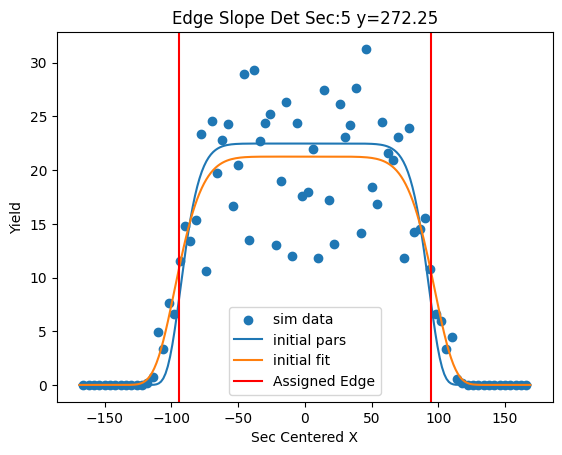

[16.57130679 -1.19888486 72.92828961  7.20851677]


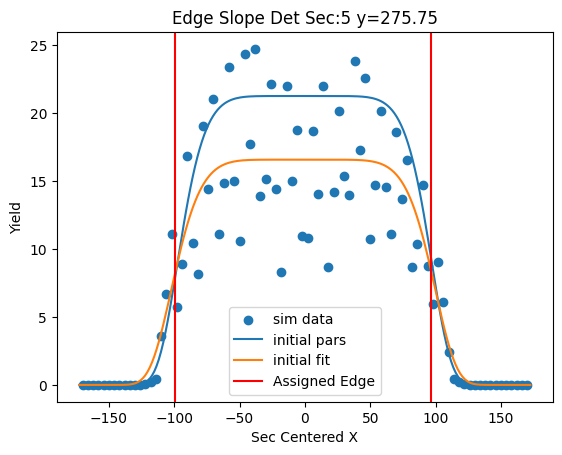

[22.23519309  0.28299412 73.92147349 10.87728797]


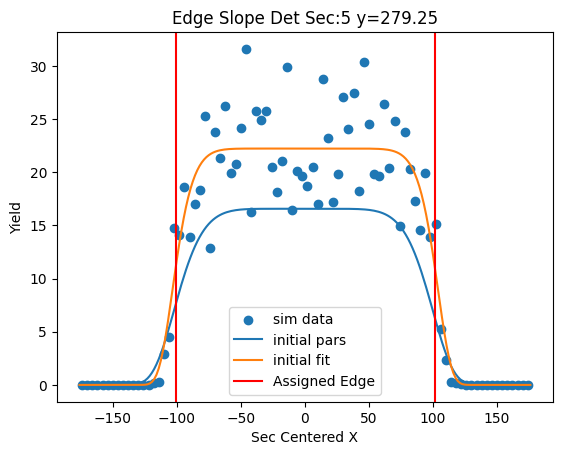

[15.55670477 -0.39809217 73.29560678  9.67605598]


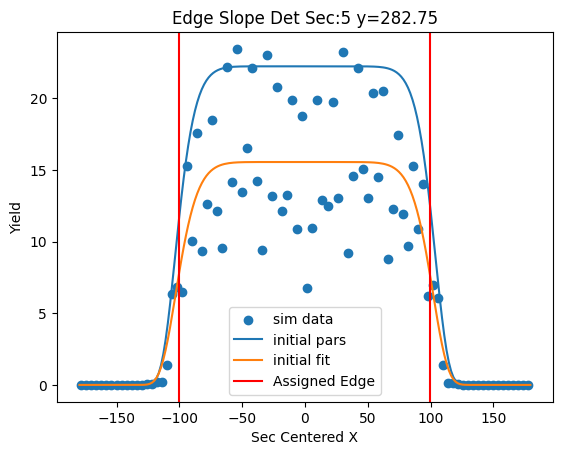

[14.96625909 -0.2008315  74.03109134  9.71420246]


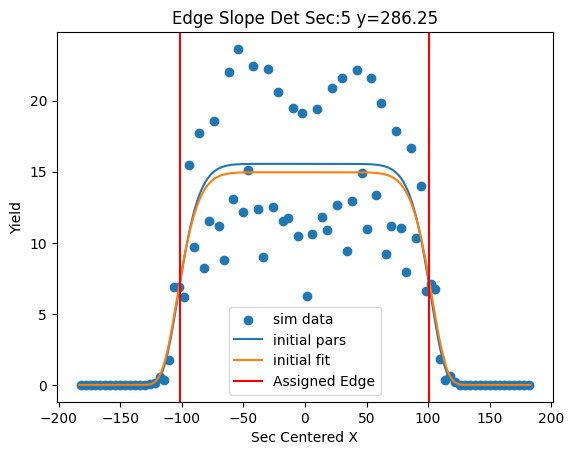

[16.79960469  0.58374676 76.00043243  9.14546517]


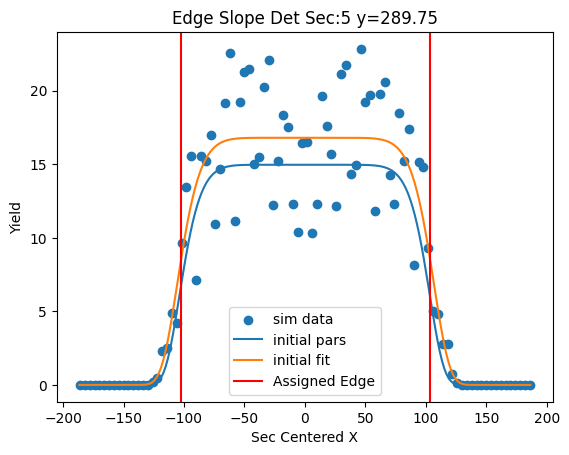

[14.35112571 -1.08930042 78.18477835  6.69688207]


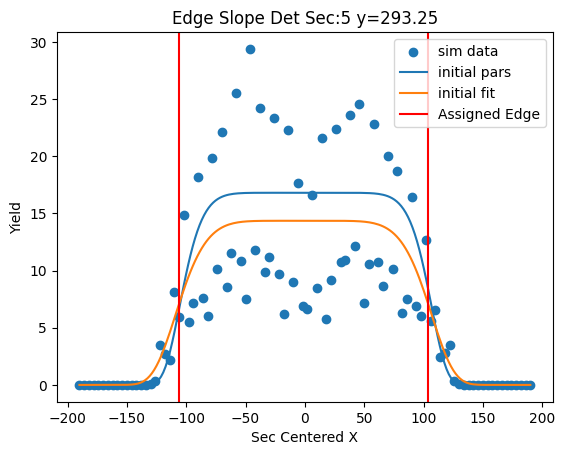

[13.11523413 -0.11174382 80.43280281  7.44520181]


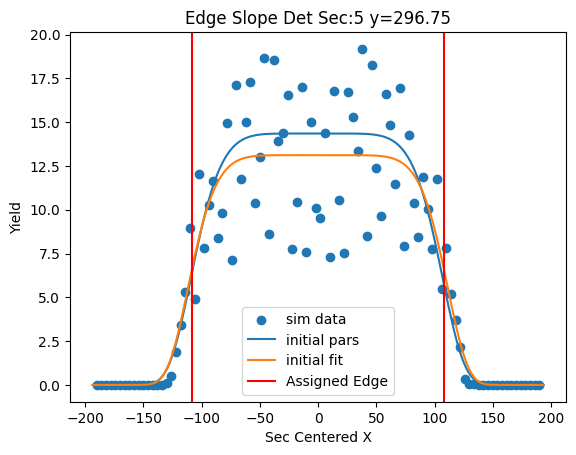

[13.54324363 -0.22970433 79.94084895  7.81291986]


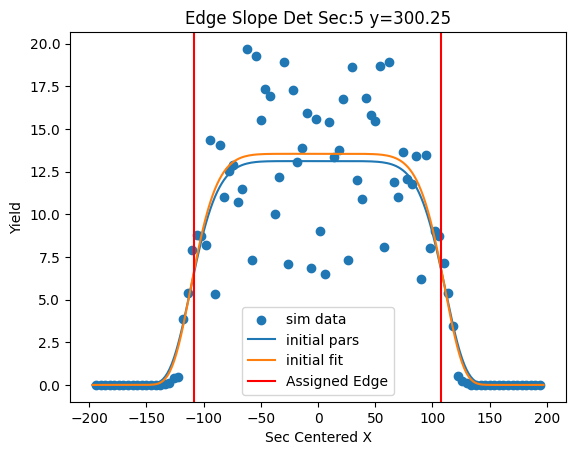

[10.17899587 -1.23533552 77.36031836  7.92242402]


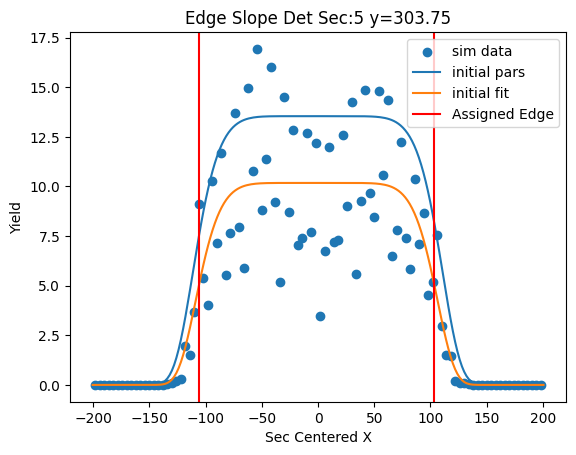

[14.36211026 -0.42987645 80.20460485  7.73536685]


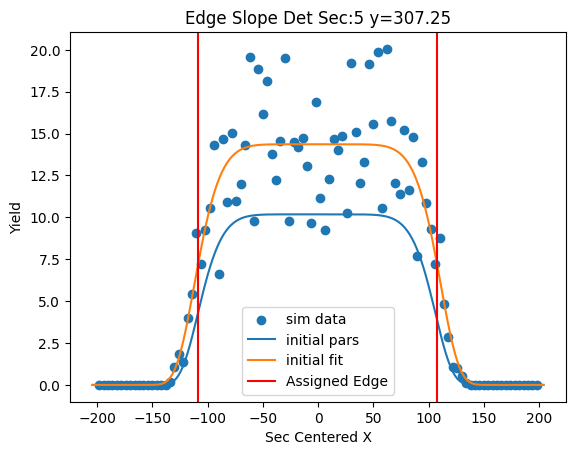

[ 9.3702135  -1.70411016 83.22654978  6.59942509]


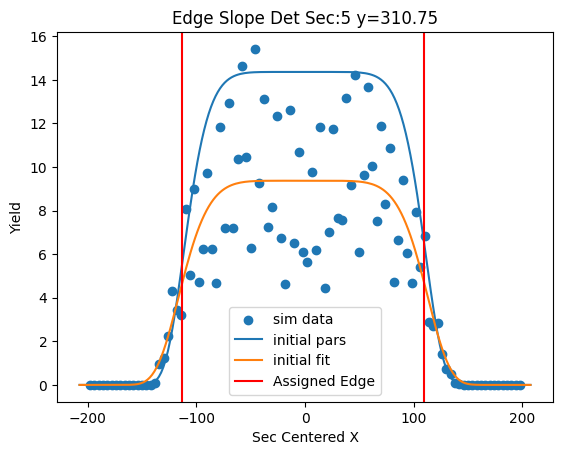

[ 9.35296204 -2.54195088 85.08721245  6.0524862 ]


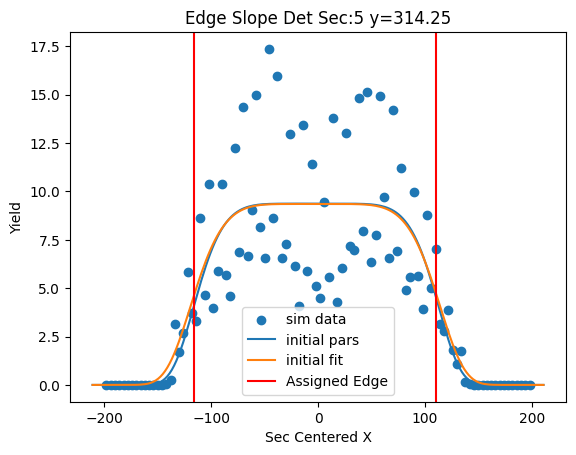

[10.14333281 -0.1640689  87.07512587  6.63869753]


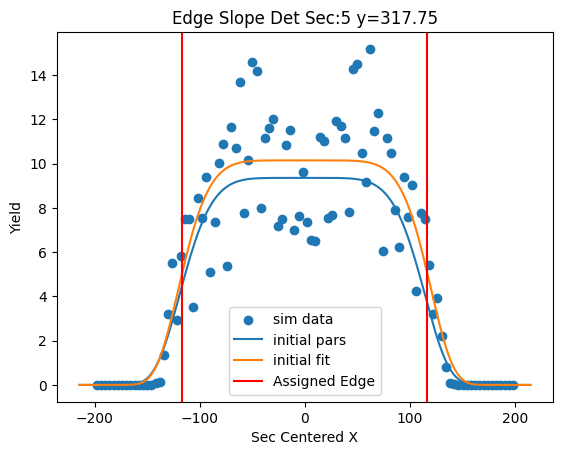

[ 9.20403433 -2.23421477 84.9010315   6.20584279]


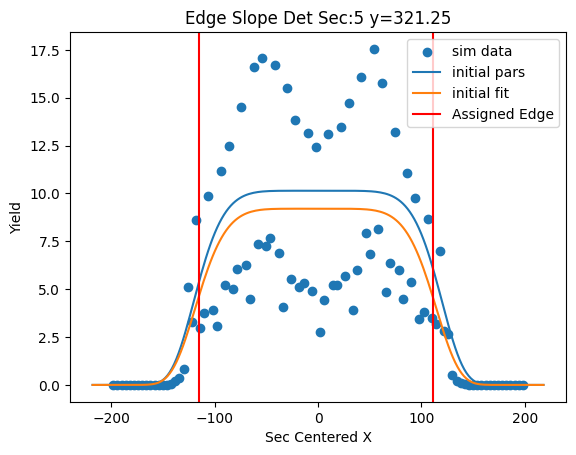

[ 7.54960655 -0.16240196 85.73411216  7.68648787]


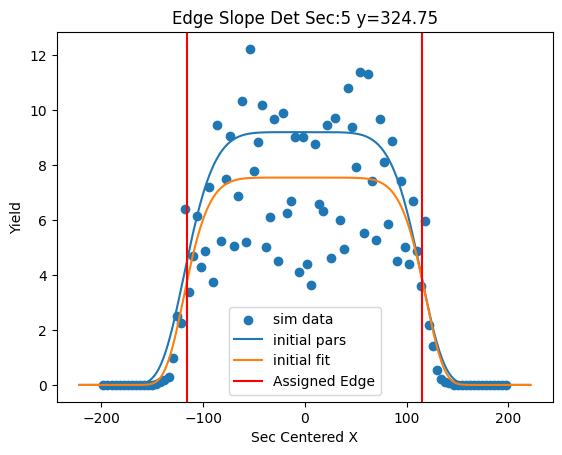

[ 8.66500894 -0.5003191  87.17176888  7.04651462]


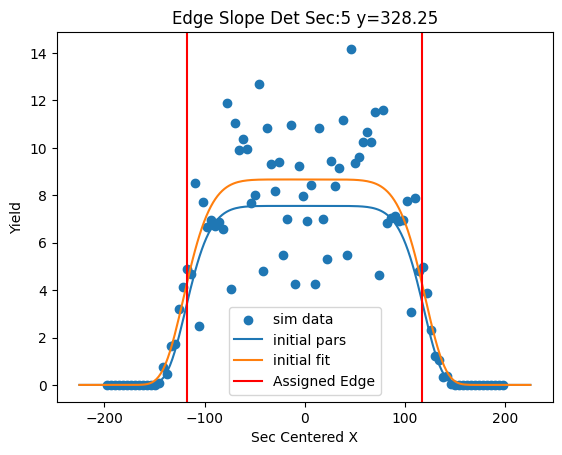

[ 5.90210353 -2.24567788 89.98406953  6.05982943]


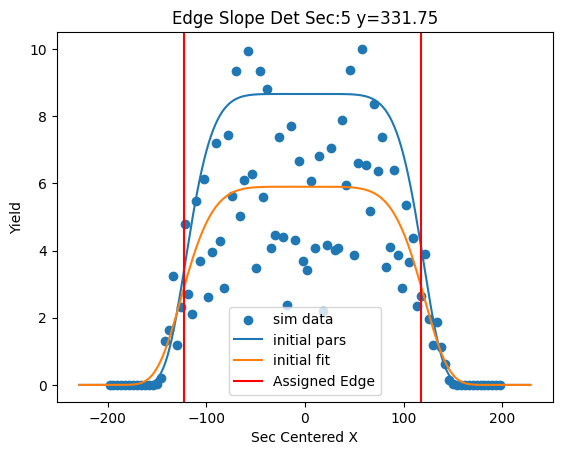

[ 8.2836235  -0.35090398 92.64647363  6.02160436]


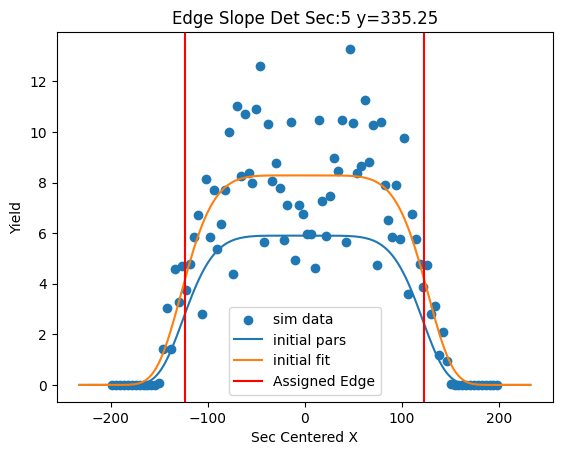

[ 5.42821779 -1.39987169 92.14920786  5.63479123]


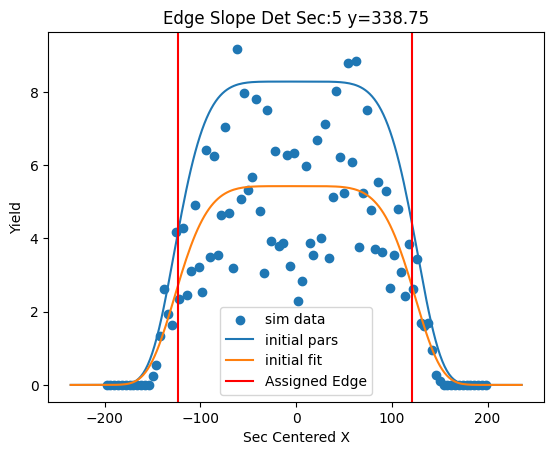

[ 5.63058737 -1.33752513 92.34418007  5.92288888]


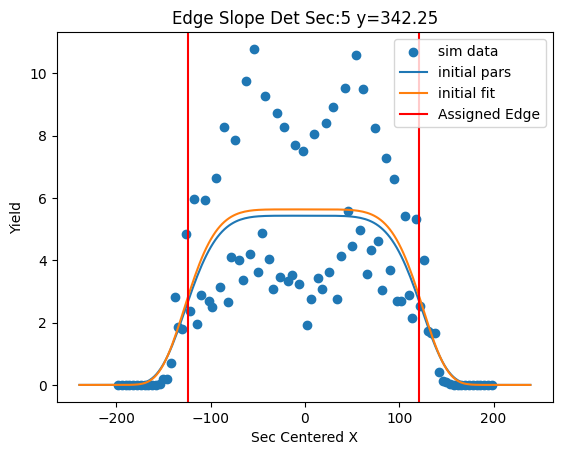

[ 5.09436932  0.16361636 95.1087552   8.83561682]


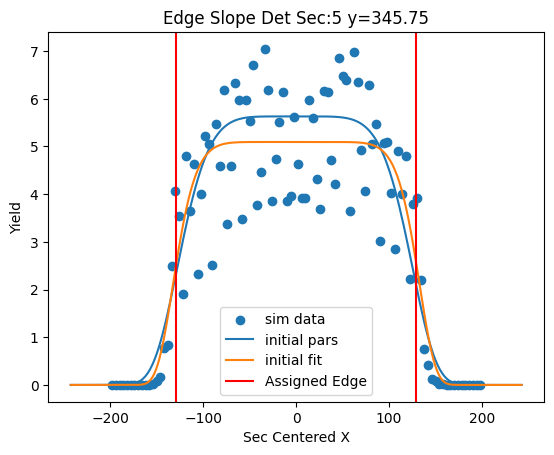

[ 4.48666168 -2.31105497 95.47383774  6.62422231]


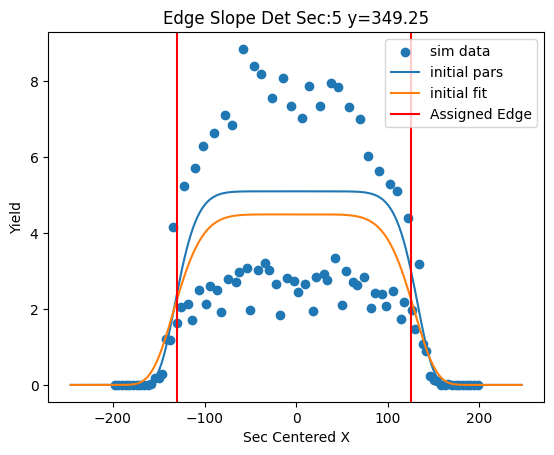

[  3.49017878  -0.91772607 100.4891123    7.29619238]


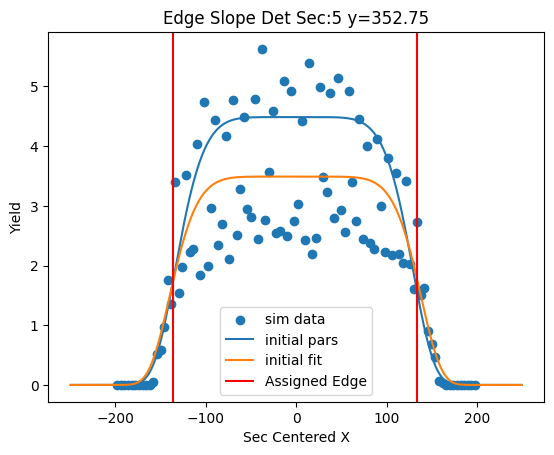

[  4.62574414  -0.3864993  101.34843861   7.28489038]


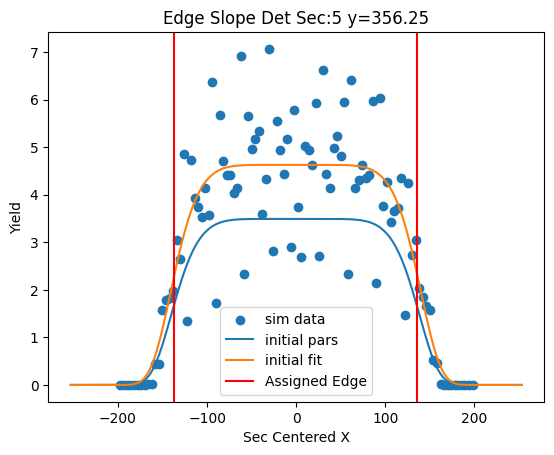

[  2.84786412  -1.93067855 102.410177     6.61041121]


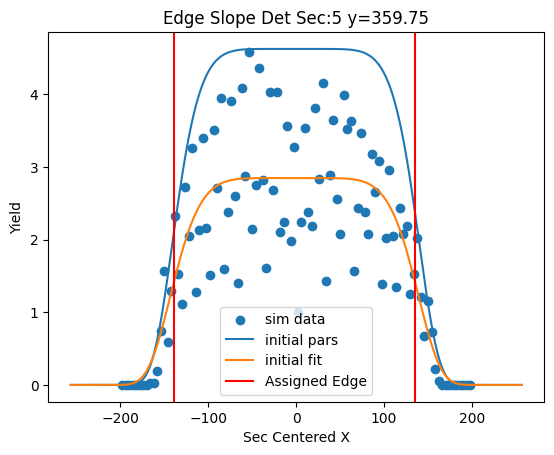

[66.07723761  0.72460898 29.77905117  5.20138915]


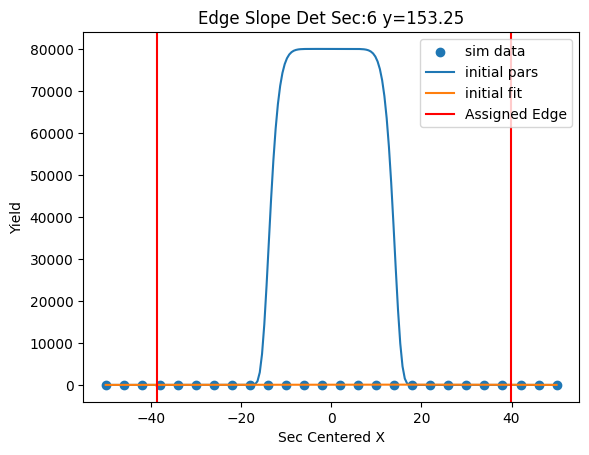

[76.4813534   0.85603226 39.30211195  4.2749651 ]


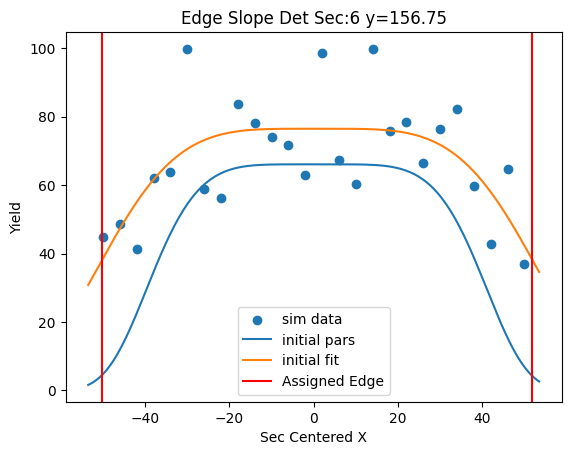

[56.17516067  0.34829225 35.30807785 12.11048441]


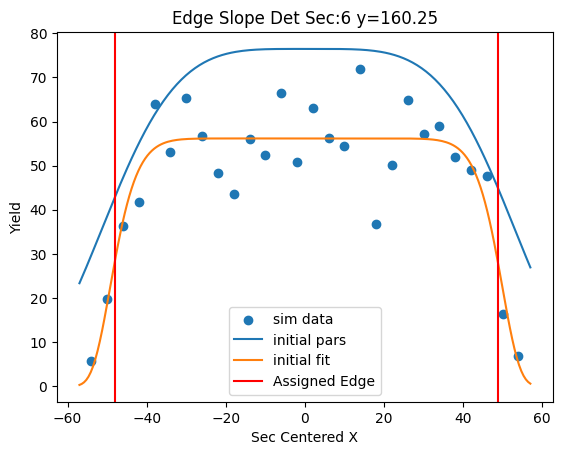

[56.48673319  0.21708305 34.50834121 13.66986421]


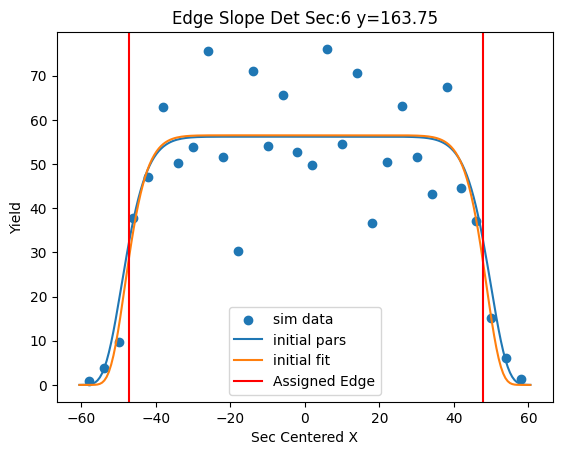

[57.87467195  0.34651029 34.8347544   8.15301982]


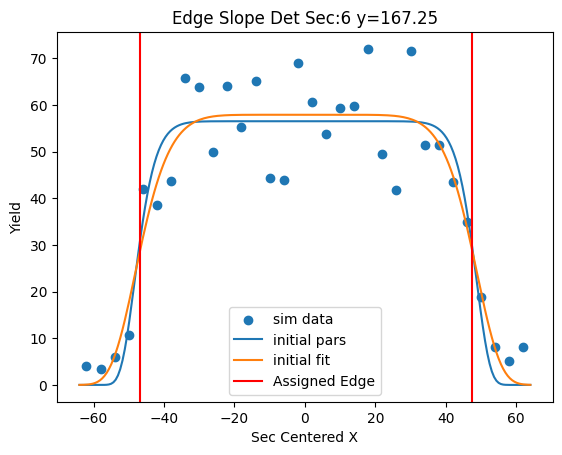

[50.08644842  0.68745521 40.1028888   5.36779048]


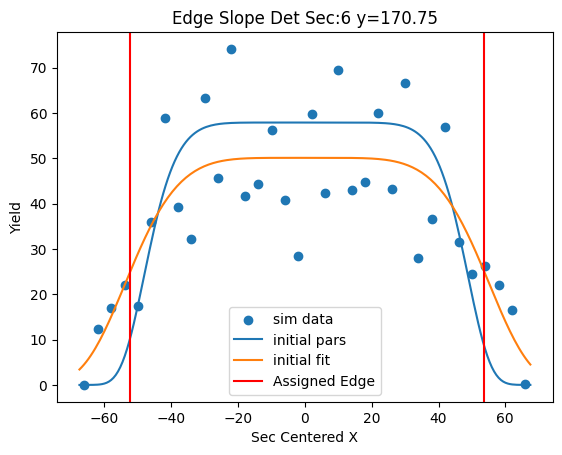

[45.67619322  0.9078045  41.22034684 10.8287473 ]


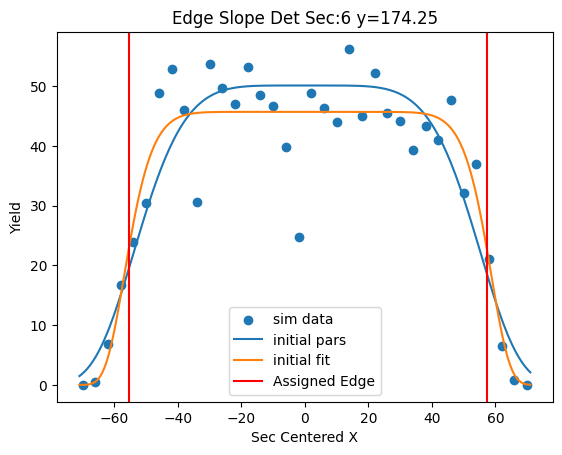

[52.97202635  0.83448455 40.42061906 10.39006388]


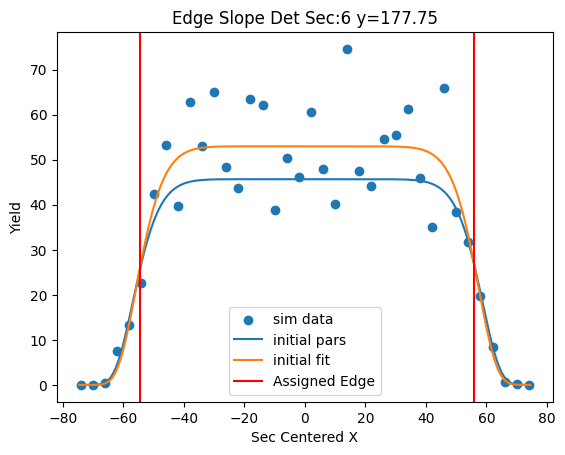

[41.49919492  0.38292892 39.65988979  8.91125449]


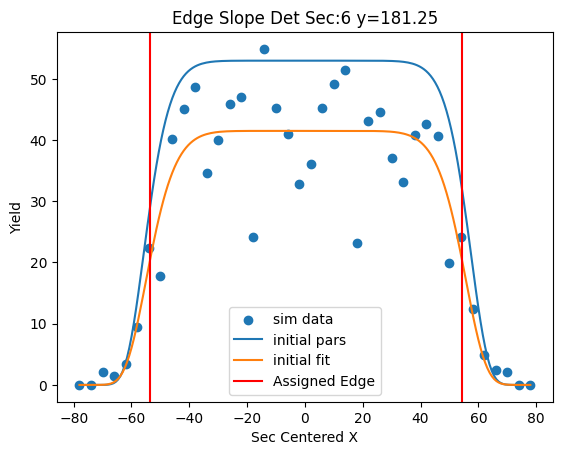

[49.4899985   1.25278851 44.20664303  5.32373433]


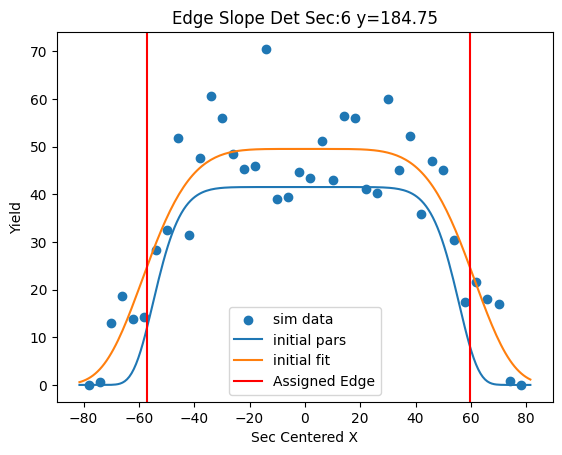

[37.44307474  1.04025993 47.12813751  7.34498451]


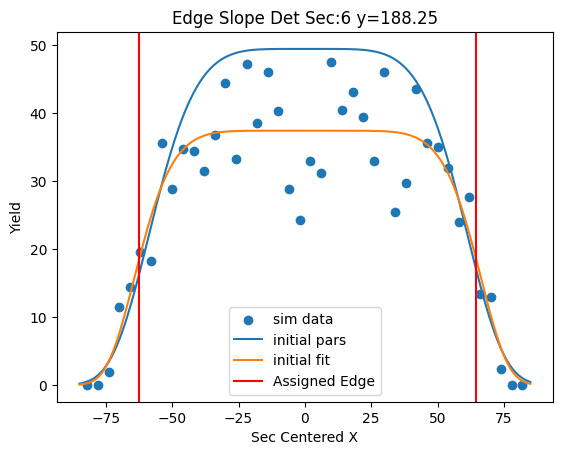

[38.46389486  0.68983458 45.03983786 13.00807204]


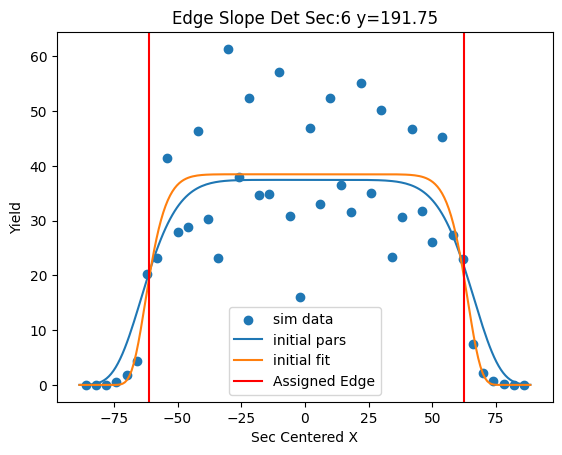

[42.35840258  1.16260703 44.54784411  9.78252721]


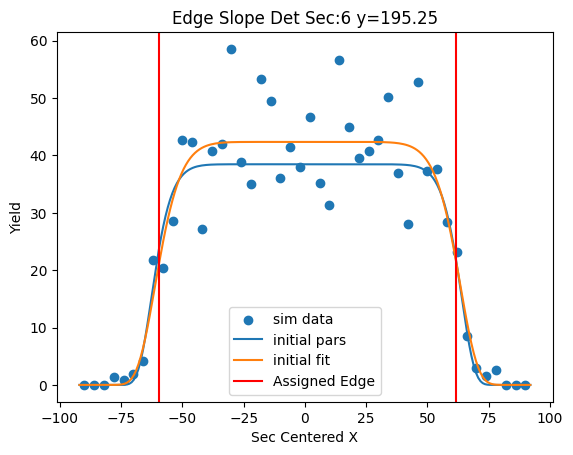

[35.48293144  1.51373699 47.93162537  6.86104856]


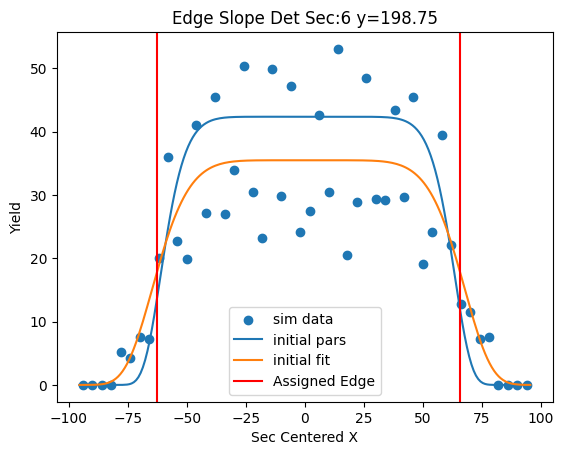

[31.07379368  1.8293092  53.74713307  7.08179336]


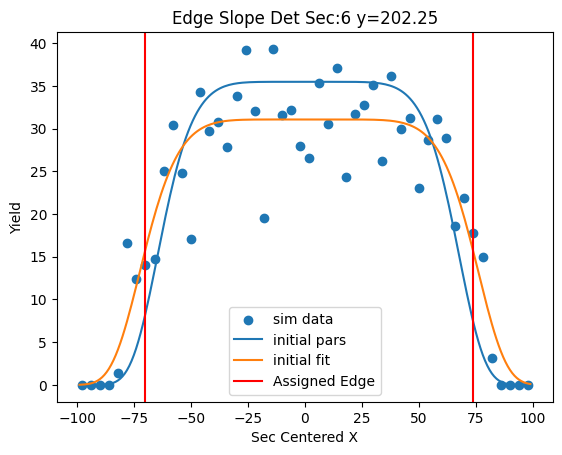

[39.21916227  1.38835063 54.96108309 10.4253356 ]


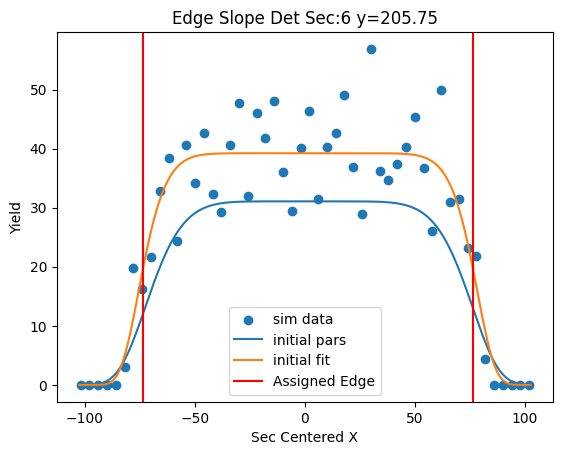

[27.31607177  1.01339656 51.78149517 11.30472697]


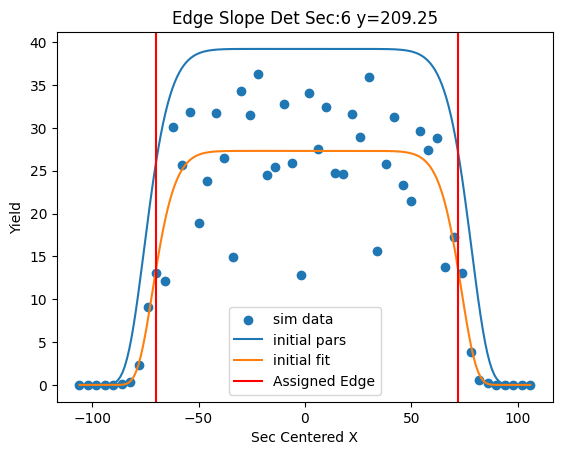

[33.12256144  1.37118431 54.30109558 10.45186952]


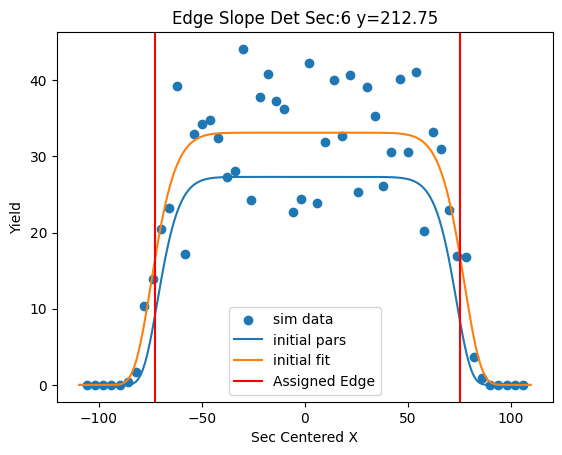

[26.78675478  1.32973391 55.22975818 13.9278329 ]


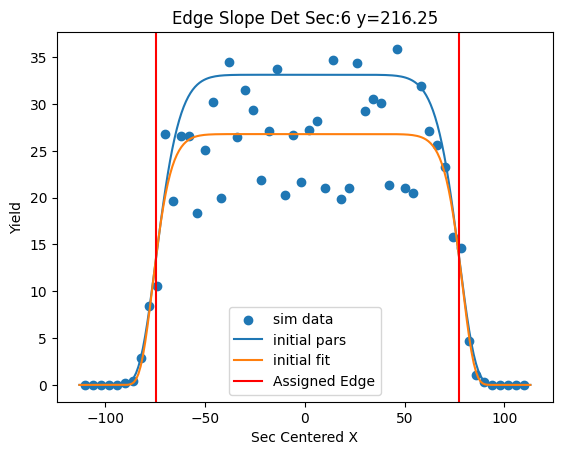

[27.80869536  1.31318109 55.69044403 14.10636992]


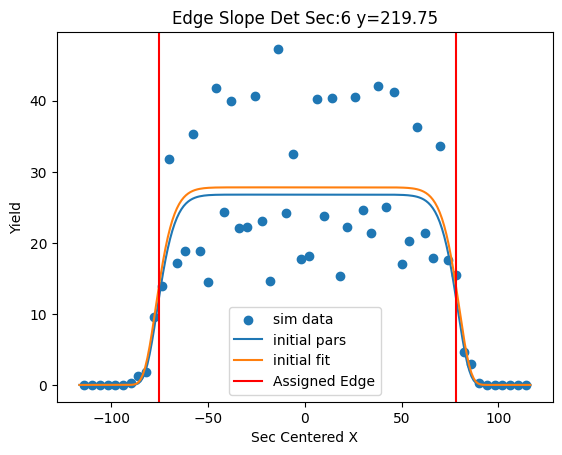

[31.10630747  2.26194341 56.74683104 11.05577529]


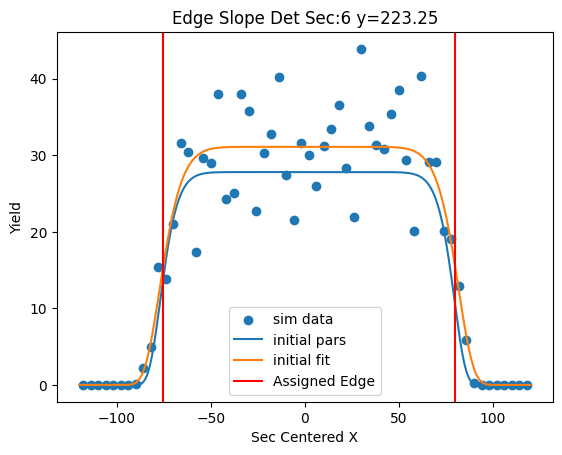

[25.54638979  0.59841214 54.28939419 11.23219444]


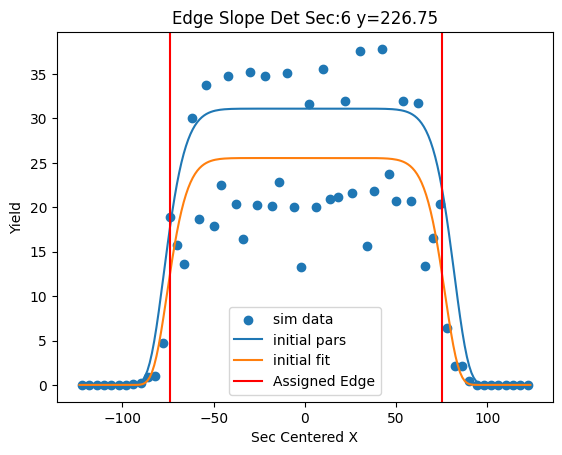

[23.1493147  -0.06596483 55.077469   12.72816312]


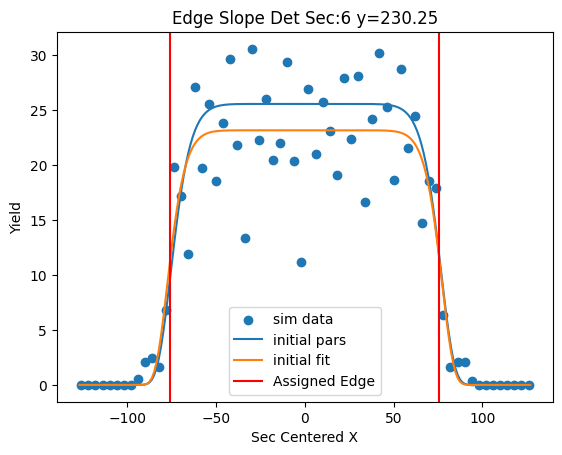

[30.69895928  0.19986339 59.61596159  8.10031398]


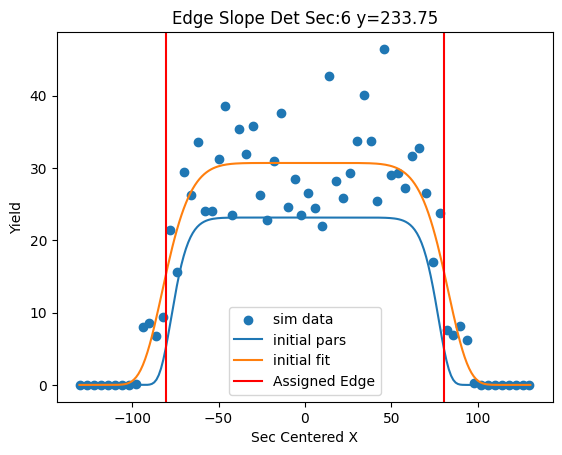

[19.89042398 -0.75646653 63.59107421  9.12115274]


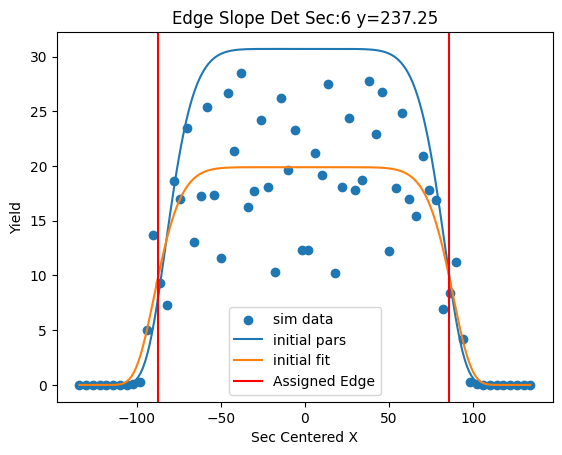

[2.39391615e+01 1.70799383e-04 6.27530211e+01 1.21335515e+01]


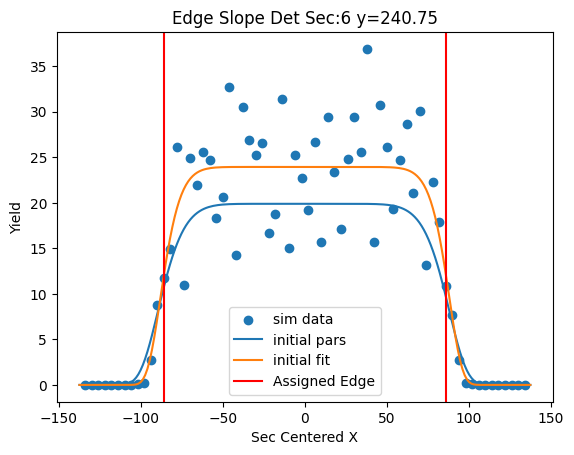

[21.96678094 -0.08423601 61.81629892 14.93374692]


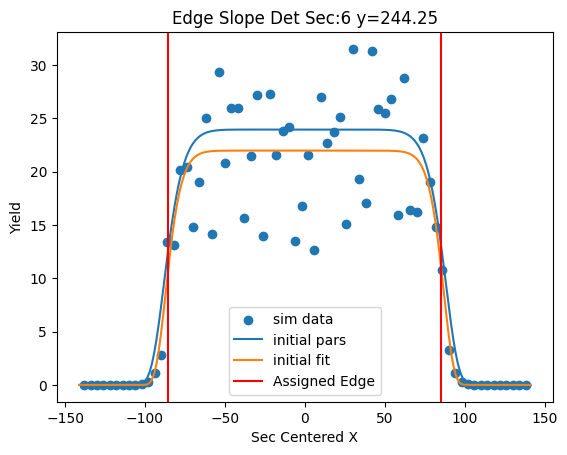

[21.89733147 -0.39552001 64.63713686 10.1181726 ]


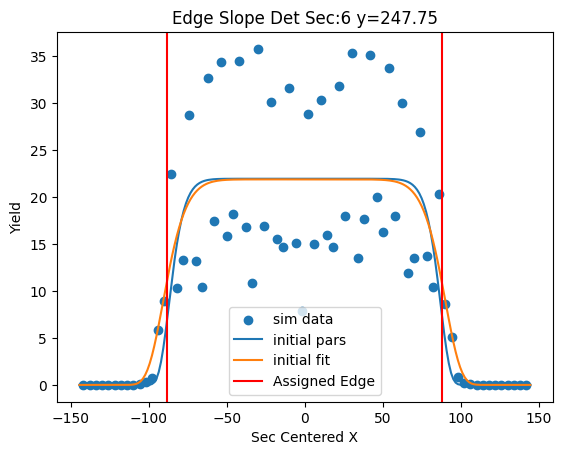

[22.76814119  0.39737191 66.38238722 12.76245032]


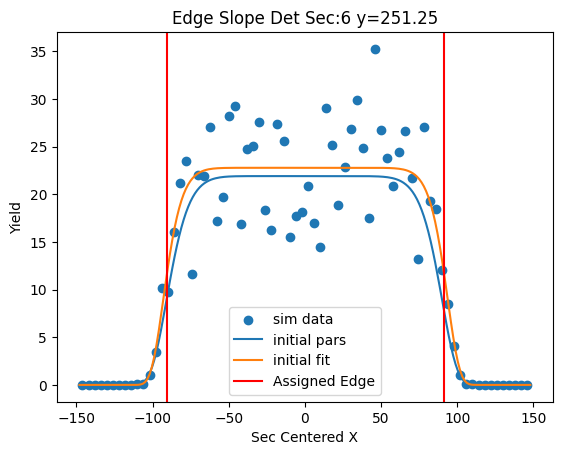

[17.81925759 -0.42865123 66.89839769 10.00039438]


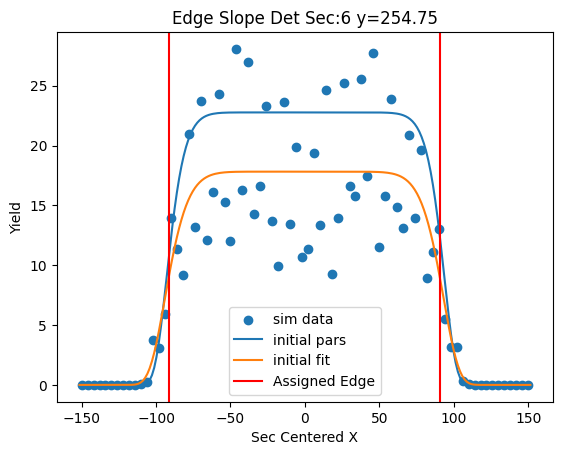

[16.94117318 -0.54235887 67.50551318 11.40639878]


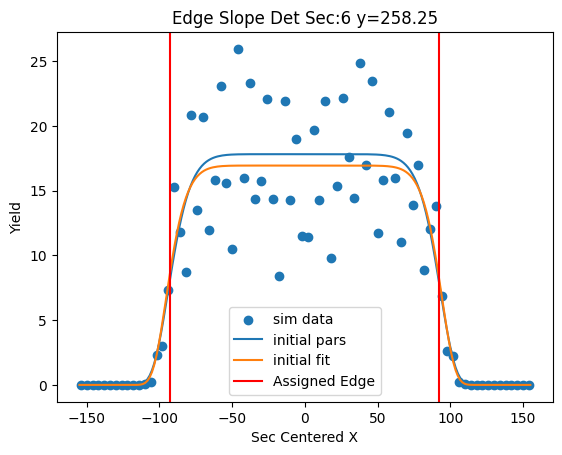

[23.17318363  0.23766111 65.48385815 14.43015028]


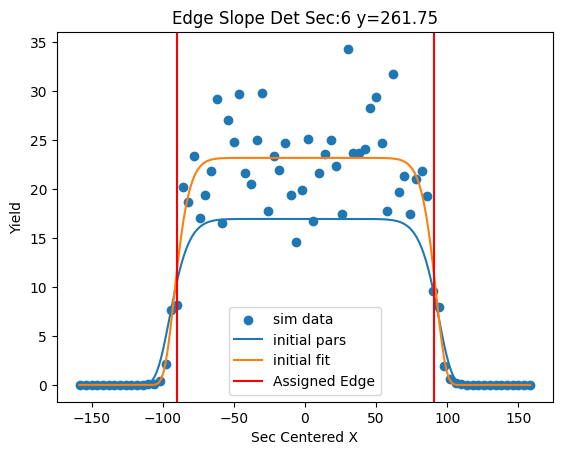

[14.72255207 -0.4558834  64.74905958 13.74917522]


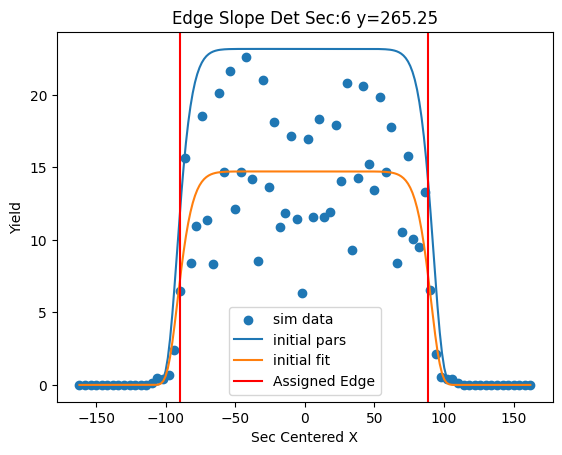

[17.14850283  0.08072229 67.84927215 10.7149693 ]


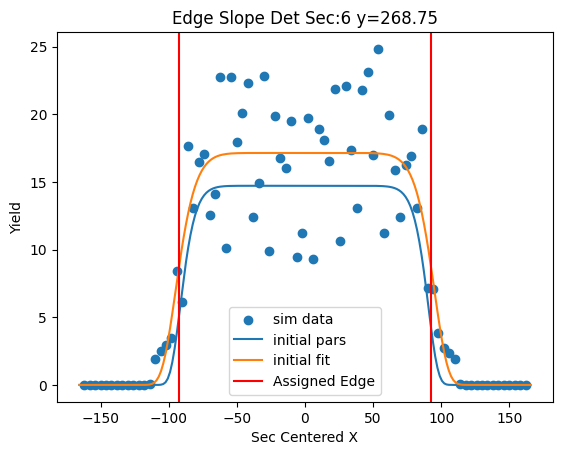

[16.60094134  0.08662744 71.99499904  7.86958452]


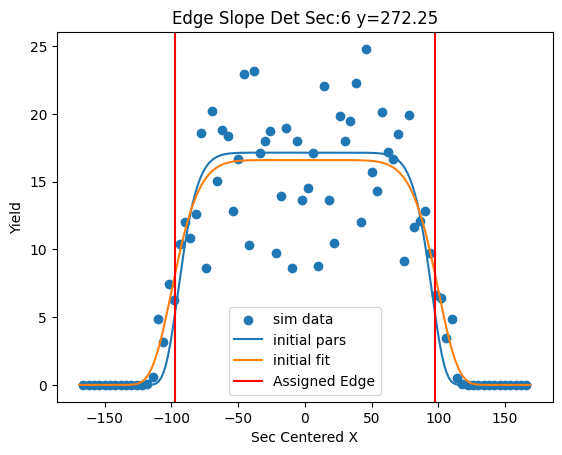

[13.14624506 -1.14194294 74.18930314  7.82189602]


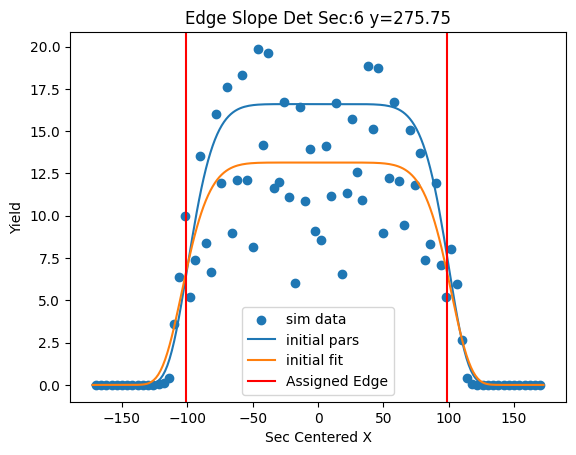

[18.39723361  0.45549114 74.57025506 11.13682289]


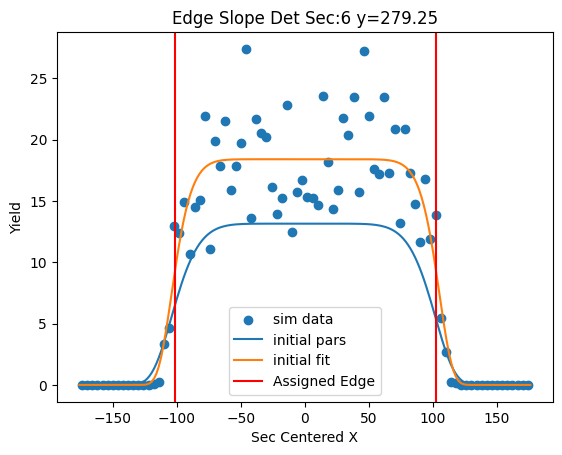

[13.20914193 -0.56672903 73.58856663  9.17635022]


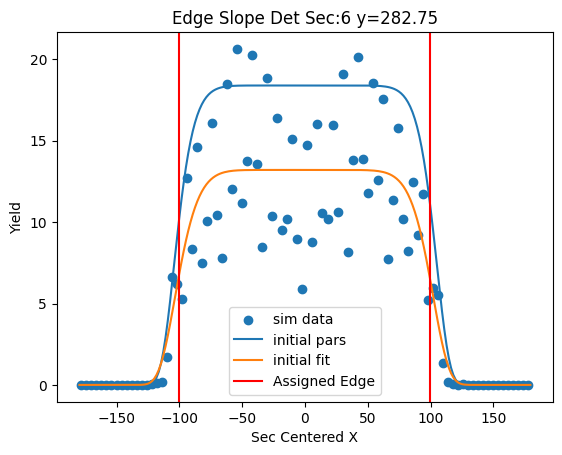

[12.913806   -0.68935936 74.43408044  9.00118868]


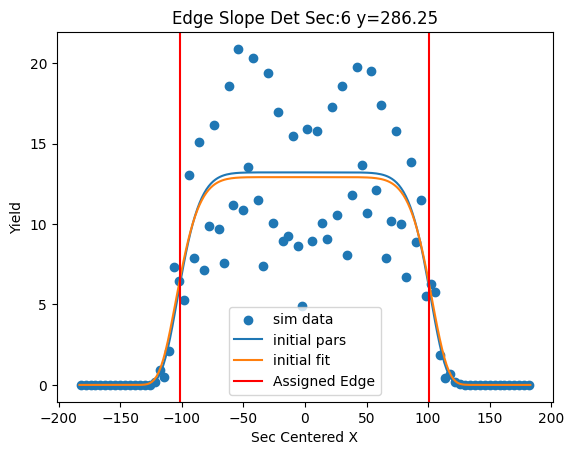

[14.76387079  0.70295107 76.81574358  8.2531754 ]


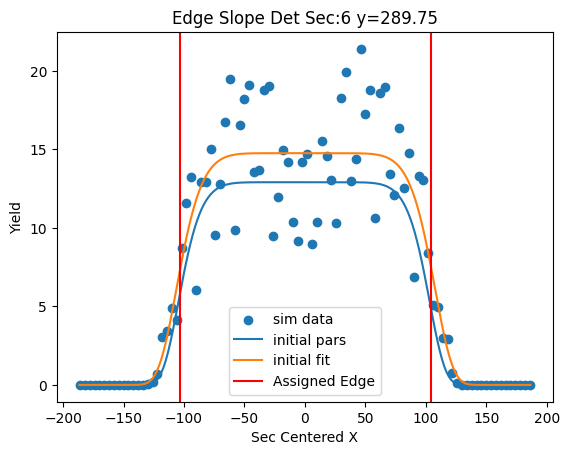

[12.69719235 -1.32106732 78.92410316  6.49996295]


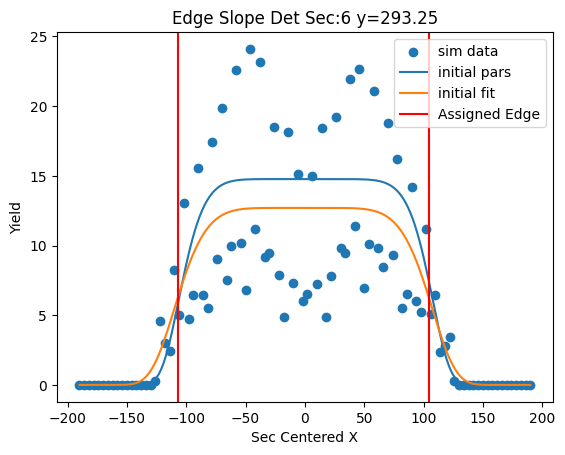

[11.8154096   0.56485753 80.89072646  7.09029151]


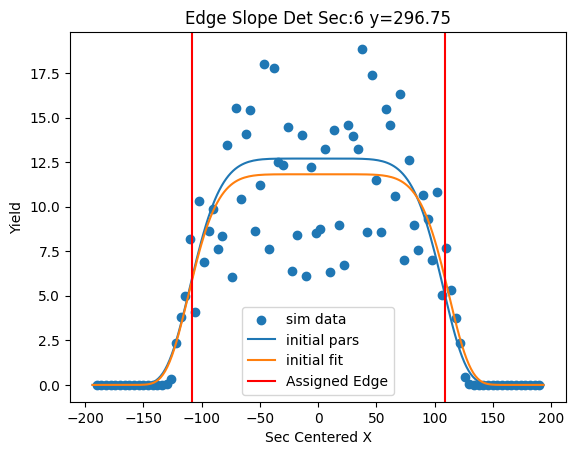

[12.27875256  0.19709037 80.39472562  7.69844398]


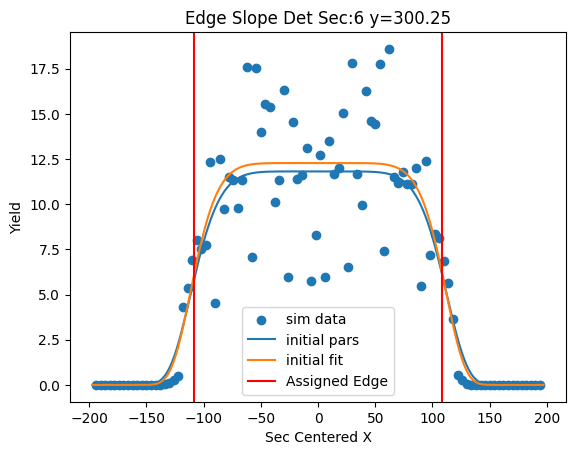

[ 9.08269667 -0.95588453 77.83973407  7.94943172]


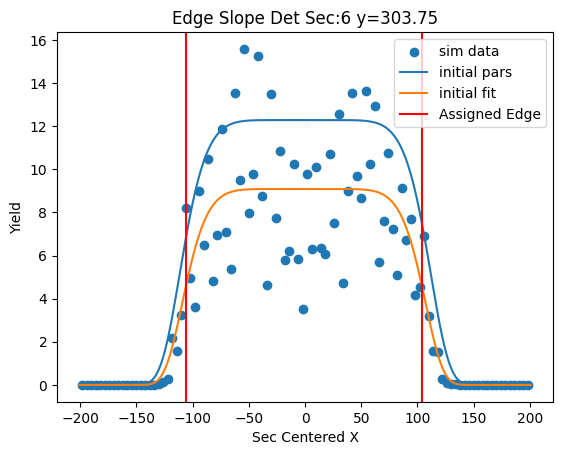

[13.13277169  1.05727942 80.01413886  7.88762399]


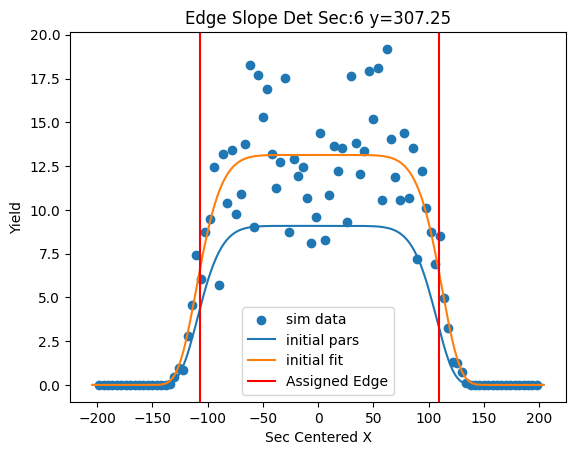

[ 8.66050605  0.26203616 82.91793764  6.76542262]


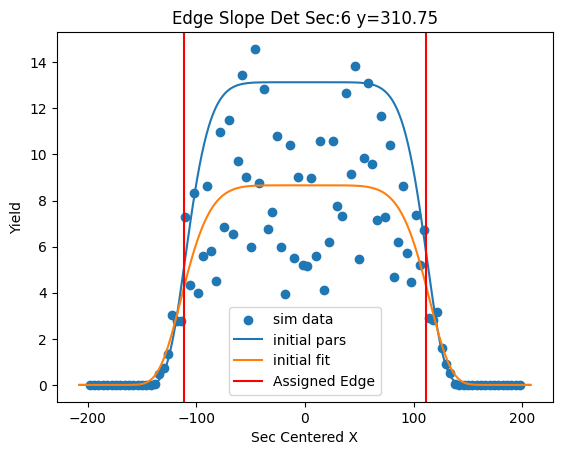

[ 8.81031323 -0.77107979 84.64239148  5.909187  ]


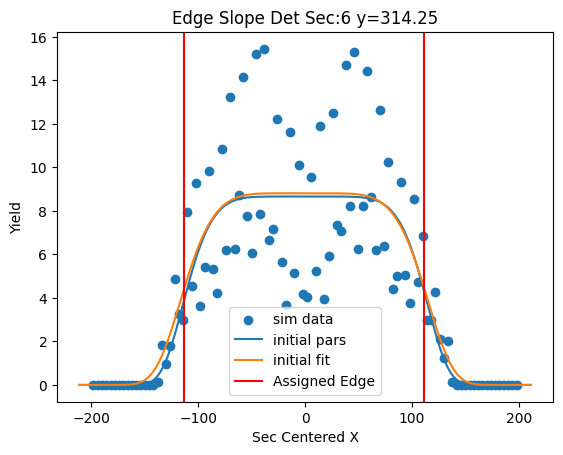

[ 9.32130546  1.34323647 87.12573002  6.63110928]


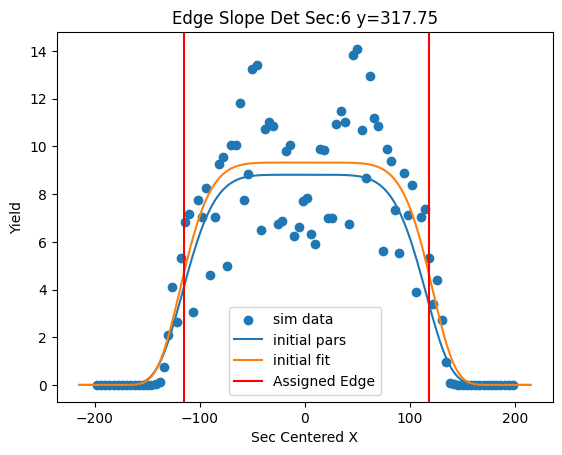

[ 8.49668065 -0.90570281 85.25810677  6.17133568]


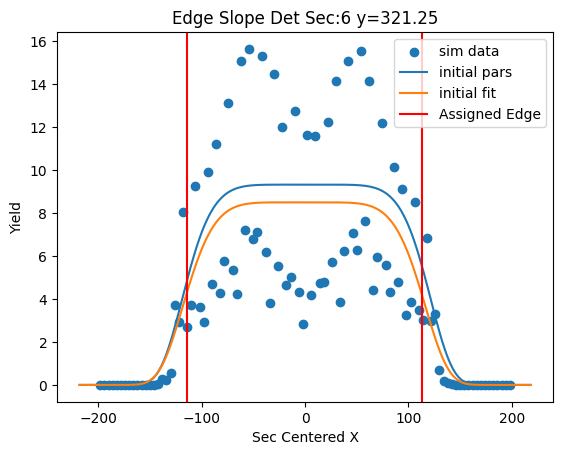

[ 6.89496075  0.25061327 86.06617551  7.94906917]


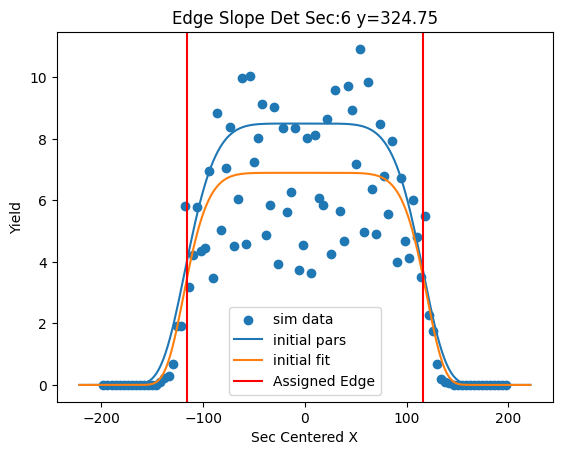

[8.03191787e+00 5.13697324e-03 8.80305361e+01 6.79247776e+00]


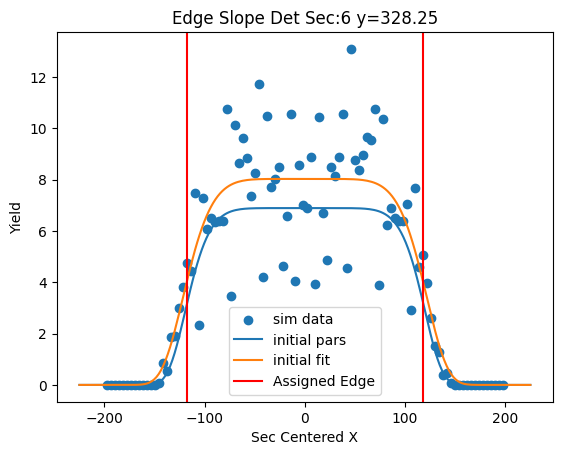

[ 5.34643808 -2.0388593  92.19391347  6.38928141]


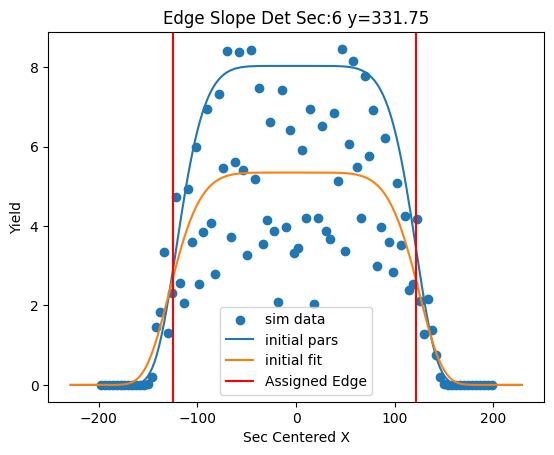

[ 7.65152332 -0.35532375 94.37370812  6.16971403]


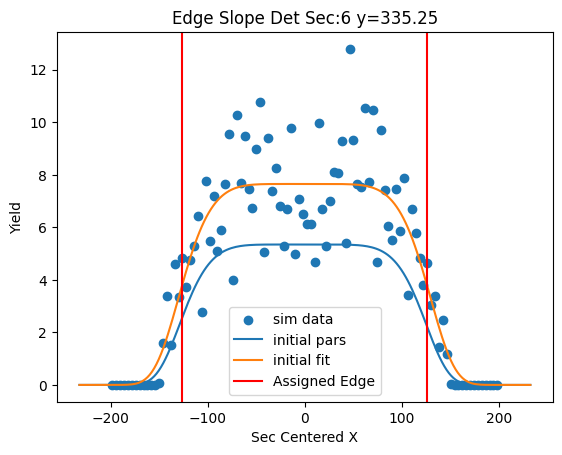

[ 4.92319279 -1.07208821 94.30634494  6.05041512]


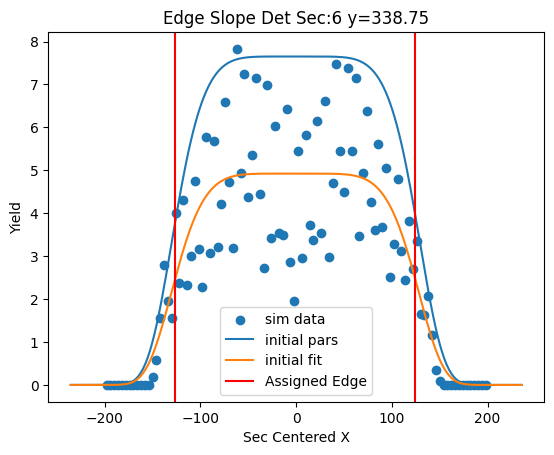

[ 5.20616381 -1.76939035 93.30618314  5.94233372]


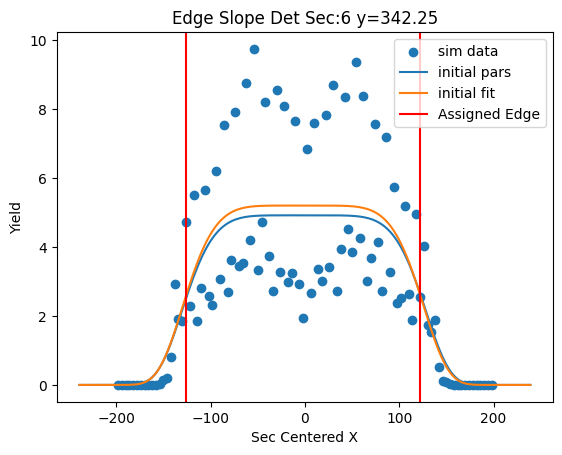

[ 4.8151507   0.26894652 95.71599863  8.97689516]


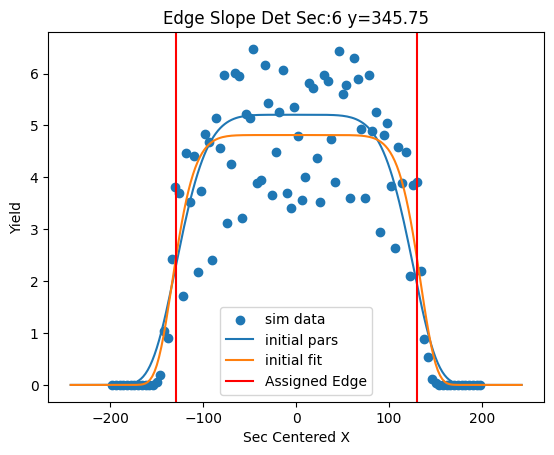

[ 4.25164474 -1.6869317  95.44708663  6.95556245]


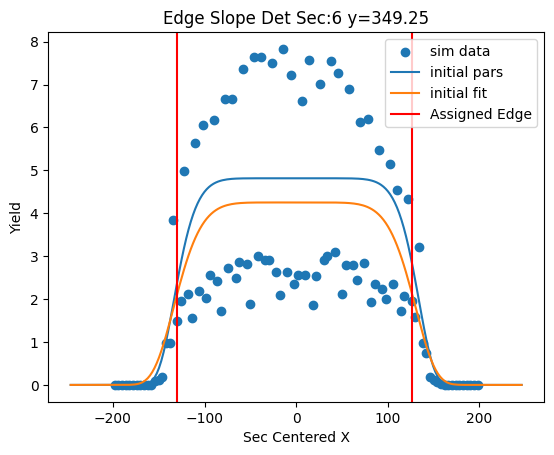

[ 3.3553352   0.41076021 99.9637337   7.67119773]


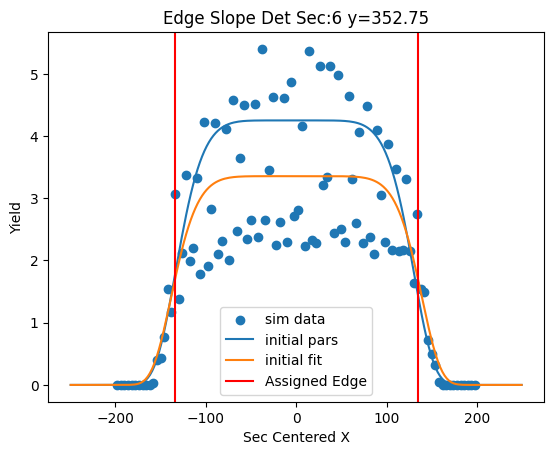

[  4.39537624   0.43427151 100.49200358   7.76618437]


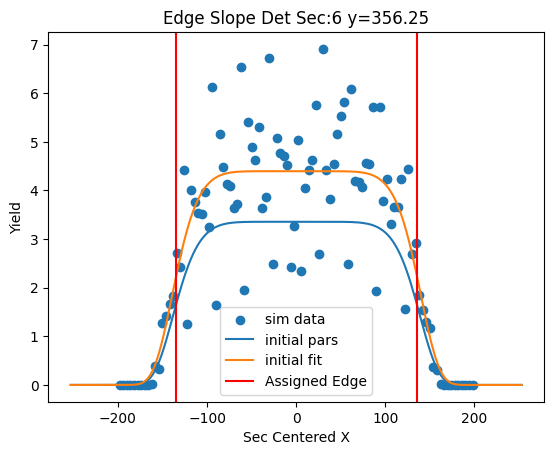

[  2.63473232  -1.77682035 101.35592625   7.09994526]


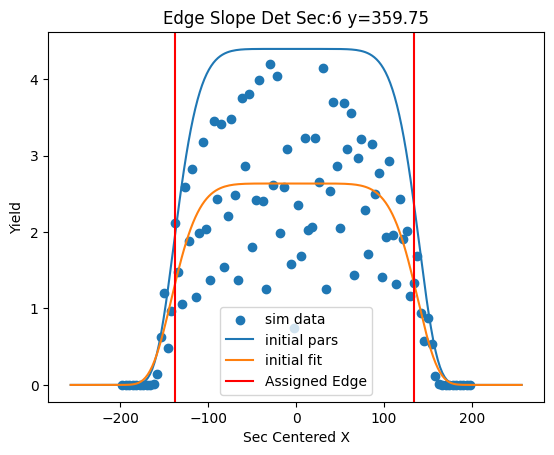

In [40]:

ini_pars = [80000,0.1,10,10.0]

test_pars = np.zeros(4)

x_points = np.zeros((6,2,fit_len))
y_points = [yvals[idx1 + i] for i in range(fit_len)]

for sec in range(6):
    for j in range(4):
        test_pars[j] = ini_pars[j]
    for b in range(fit_len):
        mod_xvals = Bounds_on_Y(xvals,xrange[b][0],xrange[b][1])
        mod_zvals = Bounds_on_X_From_Y(zvals_yx[sec][0][yidx[b]],xvals,xrange[b][0],xrange[b][1])
        plt.scatter(mod_xvals,mod_zvals,label="sim data")
        
        cont_x = np.linspace(xrange[b][0],xrange[b][1],200)
        plt.plot(cont_x,Super_Gaus(cont_x,*test_pars),label="initial pars")
        try:
            pars, pars_cov = op.curve_fit(Super_Gaus,mod_xvals,mod_zvals,p0=test_pars,maxfev=5000)
            print(pars)
            plt.plot(cont_x,Super_Gaus(cont_x,*pars),label="initial fit")
            x_points[sec][1][b] = super_gaus_cut_bound(0.5,0,*pars)
            x_points[sec][0][b] = super_gaus_cut_bound(0.5,1,*pars)
            plt.axvline(x=x_points[sec][1][b],color='r',label="Assigned Edge")
            plt.axvline(x=x_points[sec][0][b],color='r')
            for i in range(4):
                test_pars[i] = pars[i]
        except RuntimeError:
            print("Runtime Error")
        except ValueError:
            print("Value Error") 
        
        plt.title("Edge Slope Det Sec:{} y={}".format(sec+1,yvals[yidx[b]]))
        plt.xlabel("Sec Centered X")
        plt.ylabel("Yield")
        plt.legend()
        plt.show()
    #right_rot[sec] =  (yvals[yidx[1]]-yvals[yidx[0]])/(x_points[sec][1][1]-x_points[sec][0][1])
    #left_rot[sec] = (yvals[yidx[1]]-yvals[yidx[0]])/(x_points[sec][1][0]-x_points[sec][0][0])
    #print("Right Slope = ",right_rot[sec])
    #print("Left Slope = ",left_rot[sec])

[52.073804    2.30688553]
[51.97259514 -2.2945772 ]


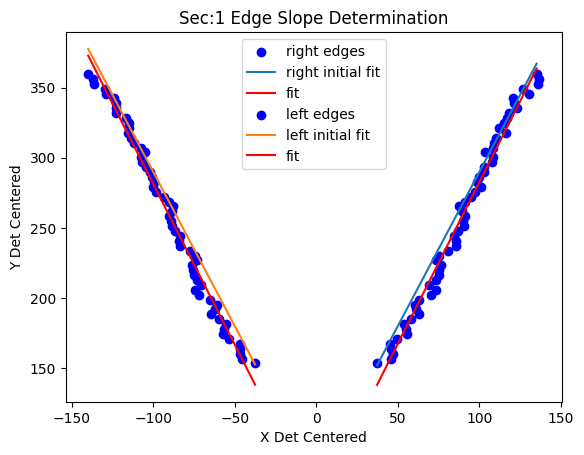

[47.21781864  2.34541802]
[56.90496466 -2.2183583 ]


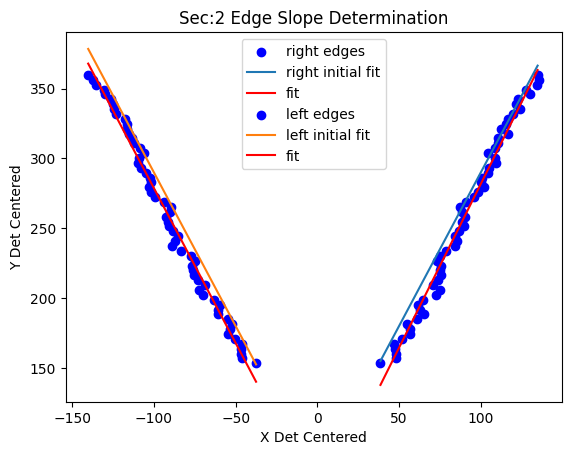

[45.93951828  2.33645522]
[44.6871698  -2.34831553]


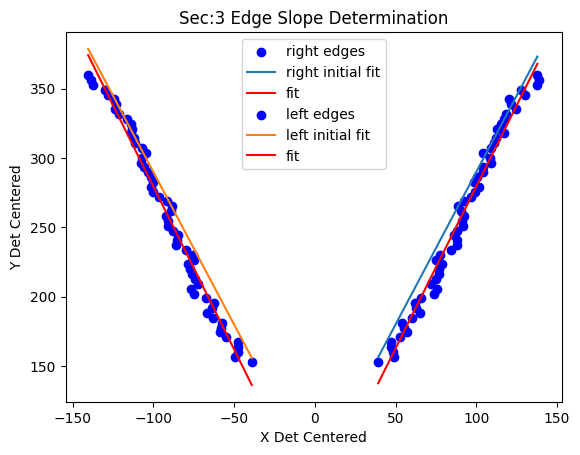

[48.94870722  2.29163832]
[51.21838572 -2.30755266]


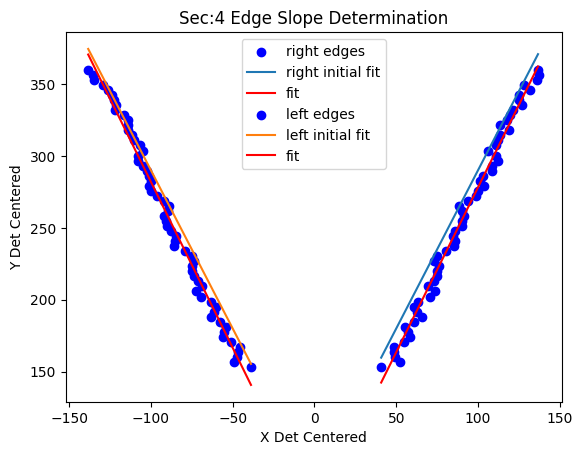

[53.87302775  2.28999427]
[50.68674436 -2.295003  ]


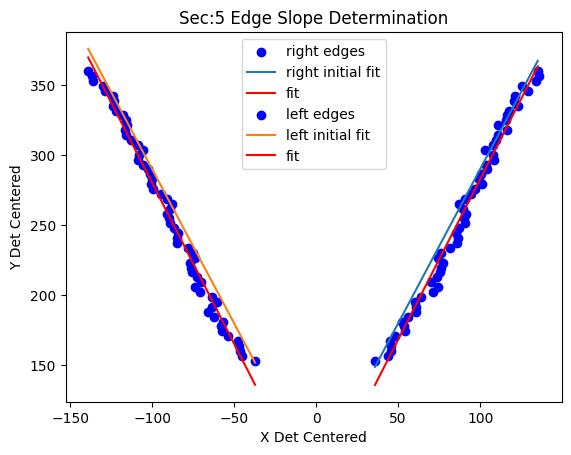

[44.20734254  2.354998  ]
[52.88793189 -2.26813367]


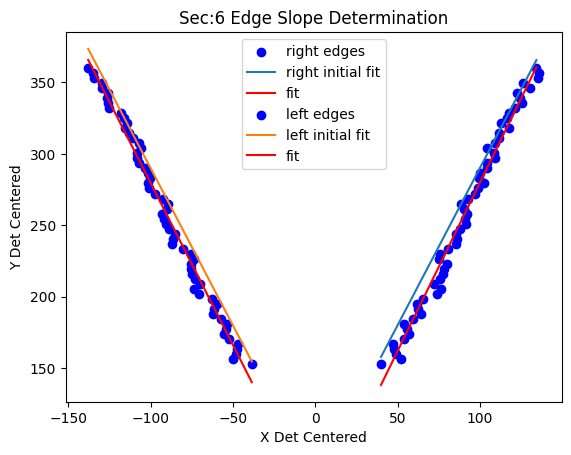

In [54]:
ini_pars = [[70,2.2,],[70,-2.2]]

test_pars = np.zeros((2,2))

slope_sides=["right","left"]

for sec in range(6):
    for i in range(2):
        test_pars[0][i] = ini_pars[0][i]
        test_pars[1][i] = ini_pars[1][i]
    for side in range(2):
        plt.scatter(x_points[sec][side],y_points,label="{} edges".format(slope_sides[side]),color='b')
        cont_x = np.linspace(x_points[sec][side][0],x_points[sec][side][fit_len-1],200)
        plt.plot(cont_x,Poly(cont_x,test_pars[side]),label="{} initial fit".format(slope_sides[side]))
        #if sec==1 and side==0:
        #    mod_x = Bounds_on_Y(x_points[sec][side],35.0,70.0)
          #  mod_y = Bounds_on_X_From_Y(y_points,x_points[sec][side],35.0,70.0)
          #  plt.scatter(mod_x,mod_y,label="{} edges".format(slope_sides[side]),color='orange')
        try:
            #if sec==1 and side==0:
            #    pars, pars_cov = op.curve_fit(Linear,mod_x,mod_y,p0=test_pars[side],maxfev=5000)
            #else:
            pars, pars_cov = op.curve_fit(Linear,x_points[sec][side],y_points,p0=test_pars[side],maxfev=5000)
            print(pars)
            plt.plot(cont_x,Poly(cont_x,pars),label="fit",color='r')
            if side == 0:
                right_rot[sec] = pars[1]
            elif side == 1:
                left_rot[sec] = pars[1]
        except RuntimeError:
            print("Runtime Error")
        except ValueError:
            print("Value Error")
    plt.title("Sec:{} Edge Slope Determination".format(sec+1))
    plt.xlabel("X Det Centered")
    plt.ylabel("Y Det Centered")
    plt.legend()
    plt.show()

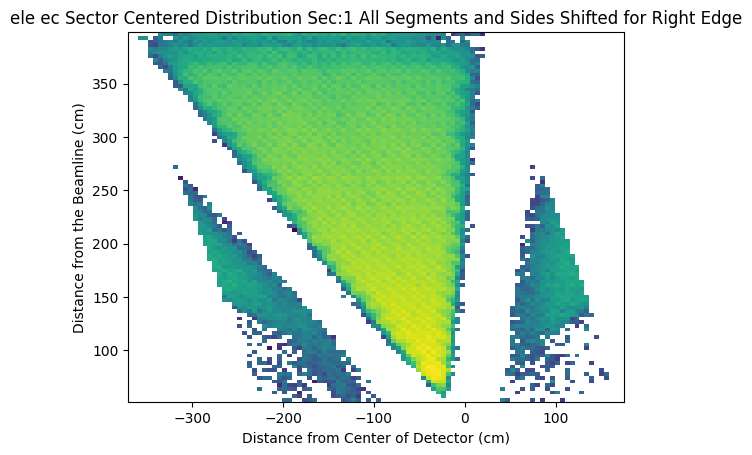

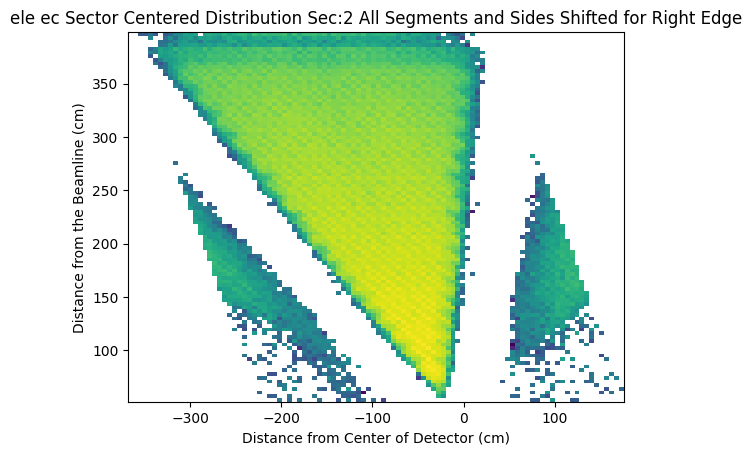

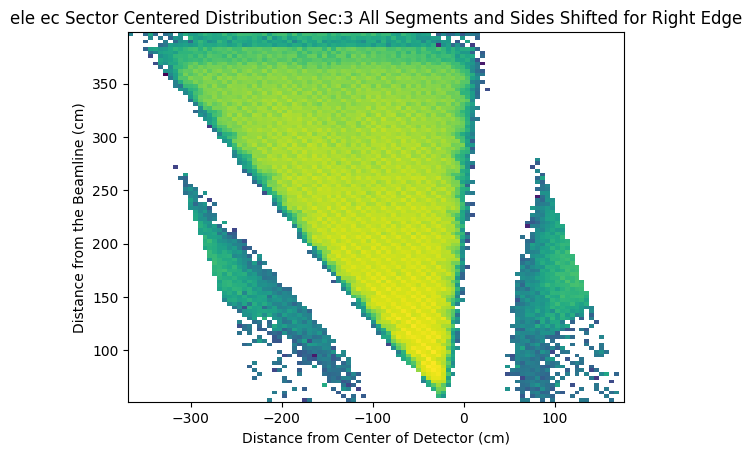

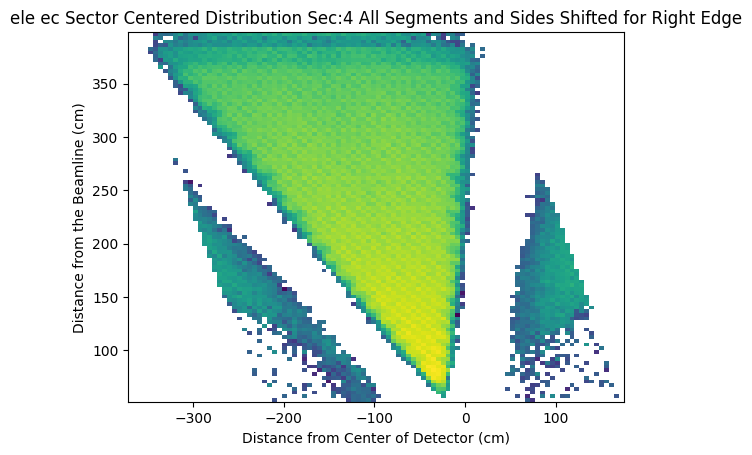

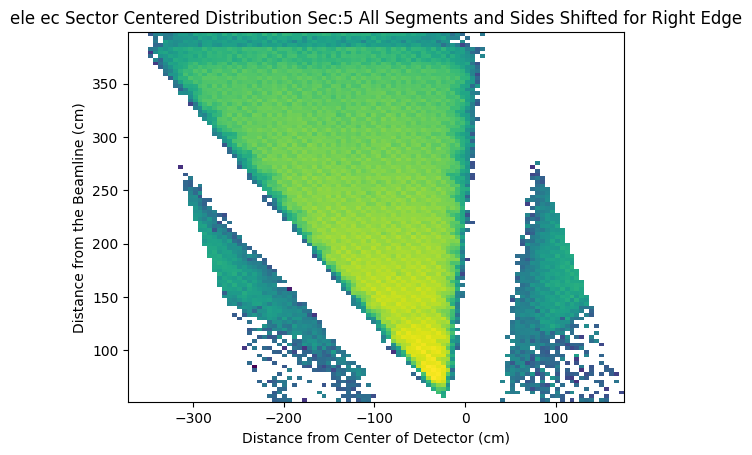

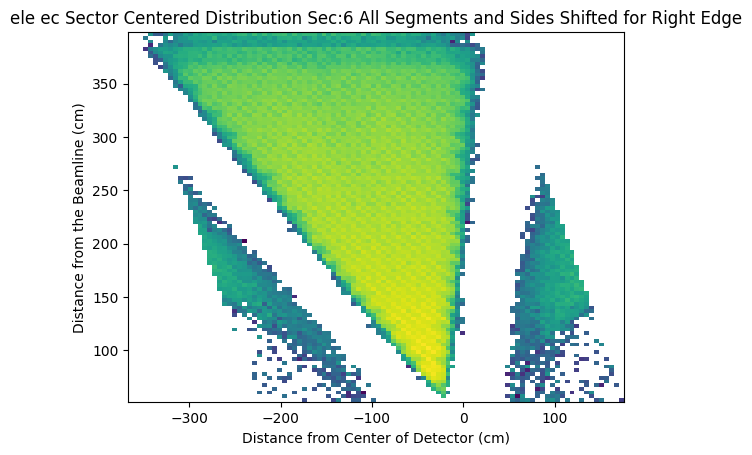

In [55]:
#Shifting for Right Edge
dumb1_x_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dense1_sr = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dense2_sr = np.zeros((7,cut_hist_len,xdim*ydim))
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for hist_idx in range(cut_hist_len):
                dumb1_x_sr[sec][hist_idx][i+j*xdim]+=xvals[i]-yvals[j]/(right_rot[sec])
                dumb1_y_sr[sec][hist_idx][i+j*xdim]+=yvals[j]
                dense1_sr[sec][hist_idx][i+j*xdim]+=zvals_xy[sec][hist_idx][i][j]
                dumb2_x_sr[sec][hist_idx][j+i*ydim]+=yvals[j]
                dumb2_y_sr[sec][hist_idx][j+i*ydim]+=xvals[i]-yvals[j]/(right_rot[sec])
                dense2_sr[sec][hist_idx][j+i*ydim]+=zvals_yx[sec][hist_idx][j][i]
for sec in range(6):
    plt.hist2d(dumb1_x_sr[sec][cut_hist_len-1], dumb1_y_sr[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1_sr[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    plt.title(species+" "+detector+" Sector Centered Distribution Sec:{} All Segments and Sides Shifted for Right Edge".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

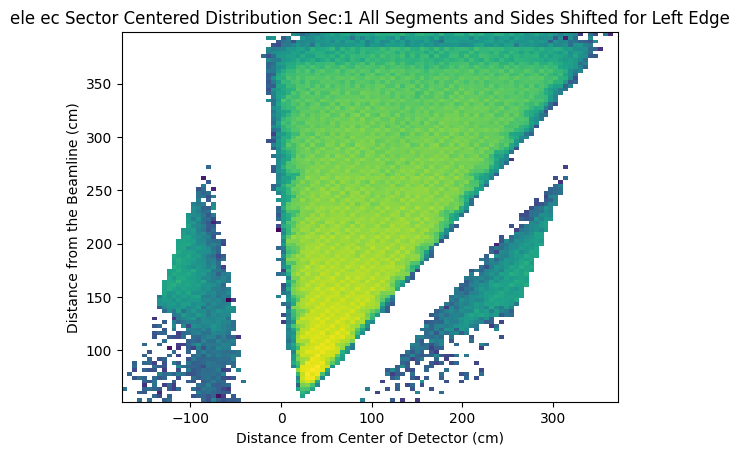

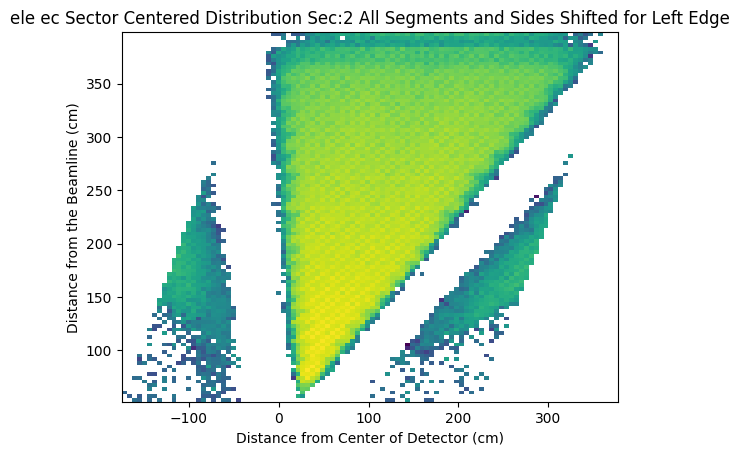

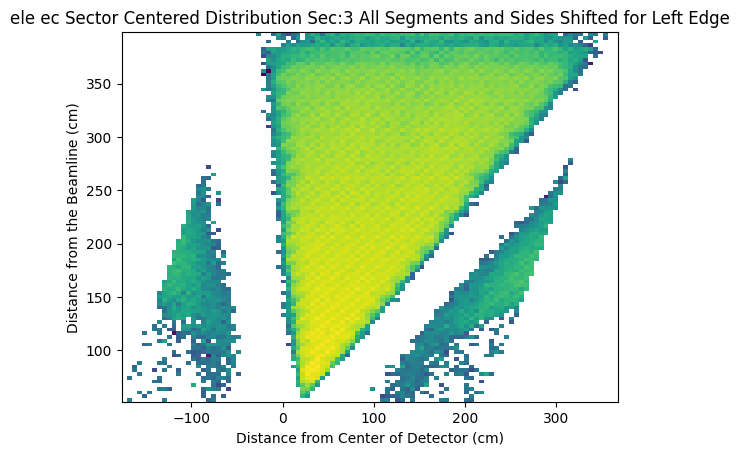

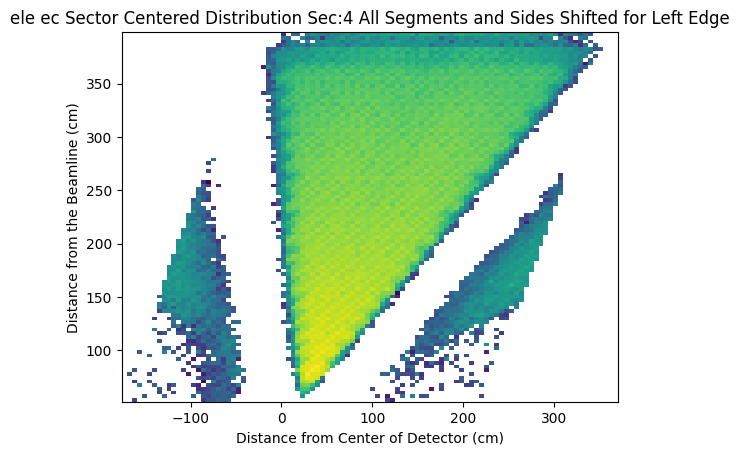

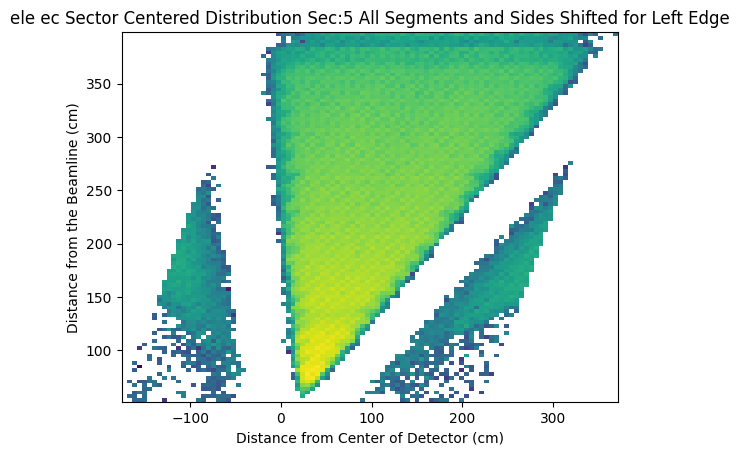

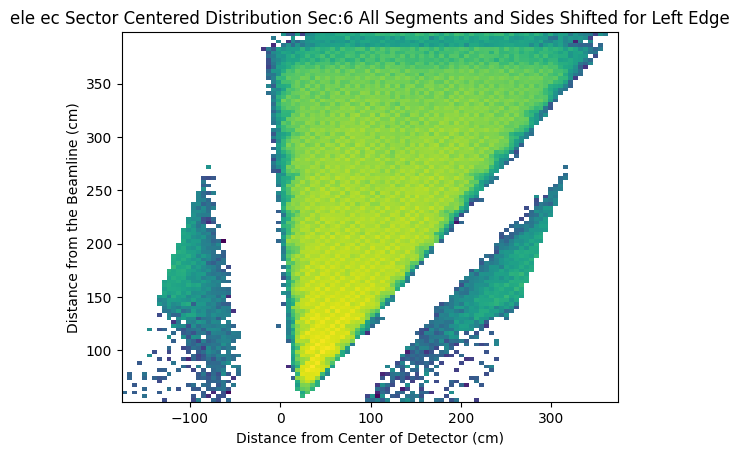

In [56]:
#Shifting for Left Edge
dumb1_x_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dense1_sl = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dense2_sl = np.zeros((7,cut_hist_len,xdim*ydim))
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for hist_idx in range(cut_hist_len):
                dumb1_x_sl[sec][hist_idx][i+j*xdim]+=xvals[i]-yvals[j]/(left_rot[sec])
                dumb1_y_sl[sec][hist_idx][i+j*xdim]+=yvals[j]
                dense1_sl[sec][hist_idx][i+j*xdim]+=zvals_xy[sec][hist_idx][i][j]
                dumb2_x_sl[sec][hist_idx][j+i*ydim]+=yvals[j]
                dumb2_y_sl[sec][hist_idx][j+i*ydim]+=xvals[i]-yvals[j]/(left_rot[sec])
                dense2_sl[sec][hist_idx][j+i*ydim]+=zvals_yx[sec][hist_idx][j][i]
for sec in range(6):
    plt.hist2d(dumb1_x_sl[sec][cut_hist_len-1], dumb1_y_sl[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1_sl[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    plt.title(species+" "+detector+" Sector Centered Distribution Sec:{} All Segments and Sides Shifted for Left Edge".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

In [57]:
proj_y = np.zeros((7,cut_hist_len,ydim))
proj_xr = np.zeros((7,cut_hist_len,xdim))
proj_xl = np.zeros((7,cut_hist_len,xdim))
for sec in range(7):
    for i in range(ydim):
        for j in range(xdim):
            for hist_idx in range(cut_hist_len):
                proj_y[sec][hist_idx][i] += zvals_xy[sec][hist_idx][j][i]
                if j-shift_idx(yvals[i]/right_rot[sec]) > 0:
                    proj_xr[sec][hist_idx][j-shift_idx(yvals[i]/right_rot[sec])] += zvals_xy[sec][hist_idx][j][i]
                if j-shift_idx(yvals[i]/left_rot[sec]) < xdim-1:
                    proj_xl[sec][hist_idx][j-shift_idx(yvals[i]/left_rot[sec])] += zvals_xy[sec][hist_idx][j][i]

In [70]:
# fit_adjust = [0,0.8,1.6] #good for no merging of cells
fit_adjust = [-0.5,0,0.5]


[-9.69561917e+00 -2.38105692e+01  4.12308452e+01  6.00180654e+05]


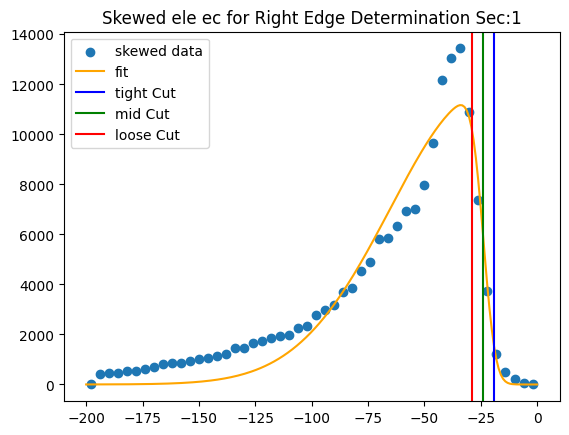

[-1.00592008e+01 -2.29836295e+01  6.40171064e+01  3.80909825e+05]


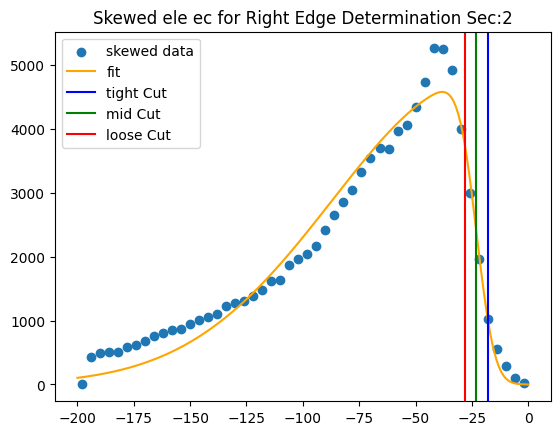

[-1.23897087e+01 -2.13668319e+01  7.38868861e+01  2.43421162e+05]


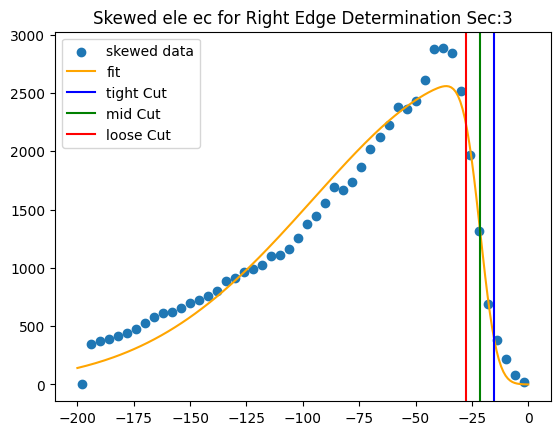

[-1.22031036e+01 -2.26072666e+01  5.03544006e+01  4.40735338e+05]


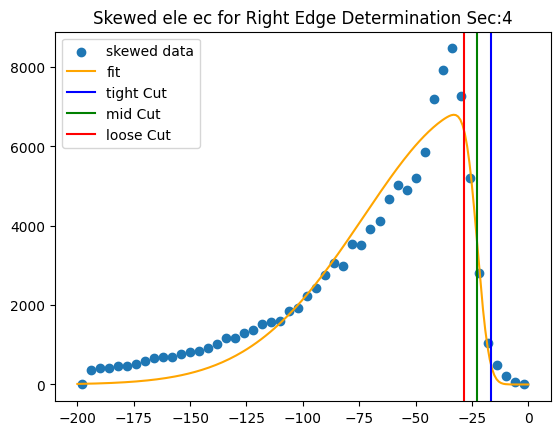

[-7.38225078e+00 -2.46995360e+01  3.26672159e+01  1.00741946e+06]


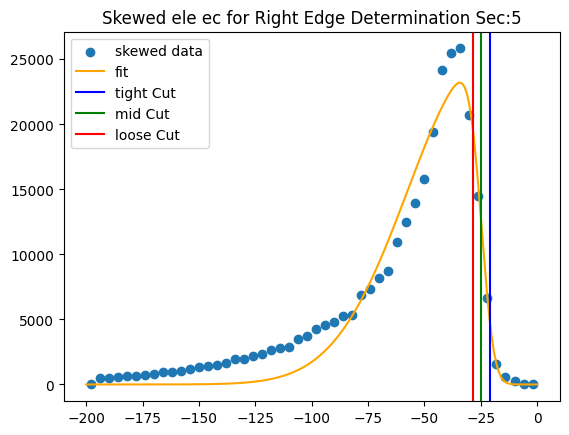

[-1.08451663e+01 -2.18590615e+01  6.08125472e+01  3.07966960e+05]


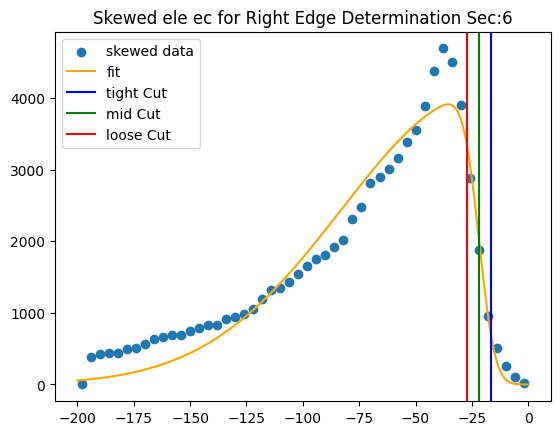

[-1.28717787e+01 -3.80904707e+01  5.52553086e+01  2.98996713e+06]


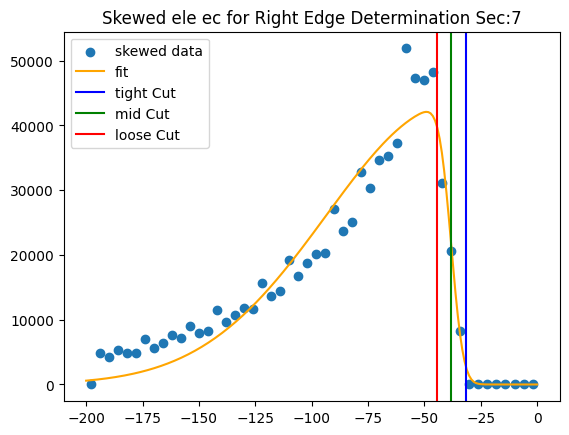

In [71]:
right_edge = np.zeros((7,3))

ini_par = [-6.23,-41,72,120000000]


color_order = ['b','g','r']
rv_color_order = ['r','g','b']
cut_name = ['tight','mid','loose']
rv_cut_name = ['loose','mid','tight']

#Bounds_on_Y(yarray_,low_,high_) removes all values not between or equal to bounds
#Bounds_on_X_From_Y(xarray_,yarray_,low_,high_) 

#skew_norm(x_,skew_,loc_,scale_,norm_)
for sec in range(7):
    mod_xvals = Bounds_on_Y(xvals,-198,0.0)
    mod_zvals = Bounds_on_X_From_Y(proj_xr[sec][0],xvals,-198,0.0)
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(-200,0,200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(skew_norm,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,skew_norm(cont_x,*pars),label="fit",color='orange')
        print(pars)
        for i in range(3):
            right_edge[sec][i] = pars[1]+fit_adjust[i]*pars[0]
        #right_edge[sec][2] = pars[1]
        #right_edge[sec][1] = pars[1]+0.8*pars[0]
        #right_edge[sec][0] = pars[1]+1.6*pars[0]
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    for cut in range(3):
        plt.axvline(x=right_edge[sec][cut],label="{} Cut".format(cut_name[cut]),color=color_order[cut])
    plt.title("Skewed "+species+" "+detector+" for Right Edge Determination Sec:{}".format(sec+1))
    plt.legend()
    plt.show()

[1.03976663e+01 2.45543627e+01 4.13803464e+01 6.02098223e+05]


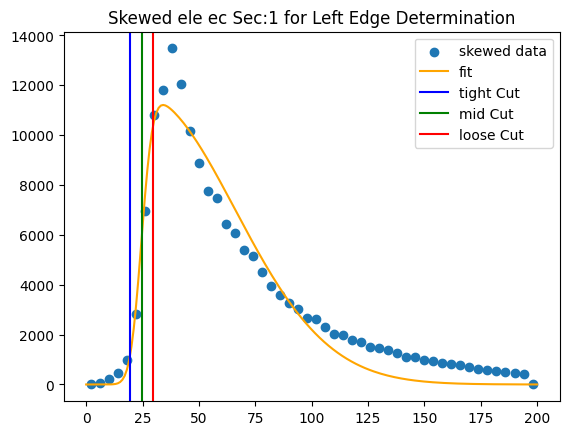

[1.28369253e+01 2.55985291e+01 6.67725254e+01 3.83068243e+05]


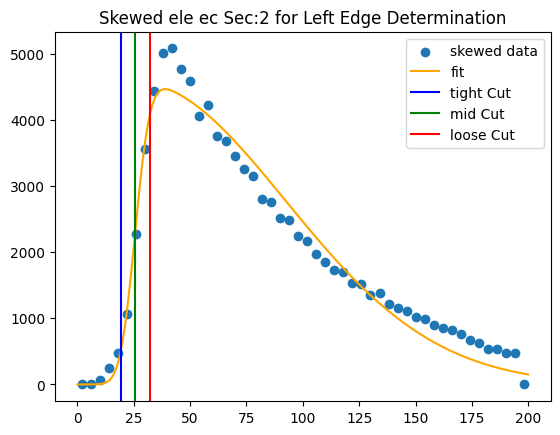

[1.16676424e+01 2.12313078e+01 7.29656315e+01 2.42497901e+05]


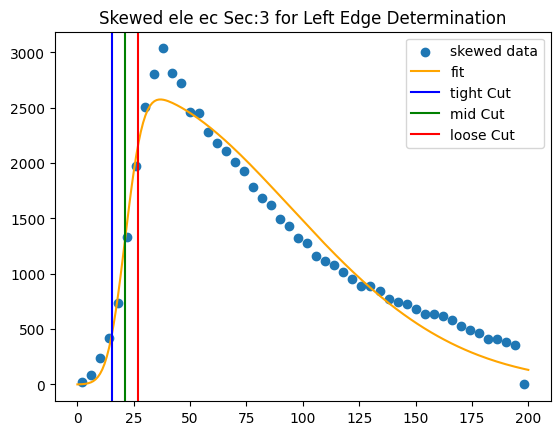

[1.04564623e+01 2.42691556e+01 4.79432672e+01 4.35955535e+05]


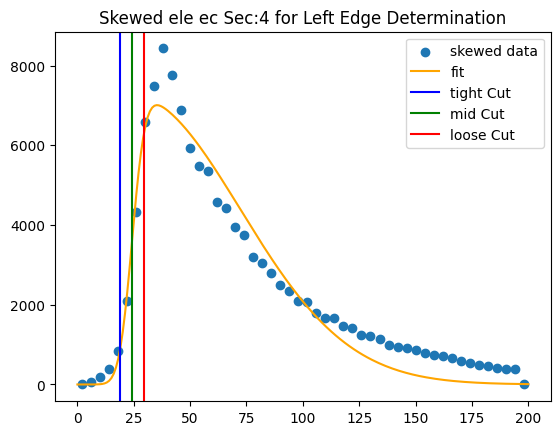

[8.22796294e+00 2.42536997e+01 3.19976586e+01 1.00511806e+06]


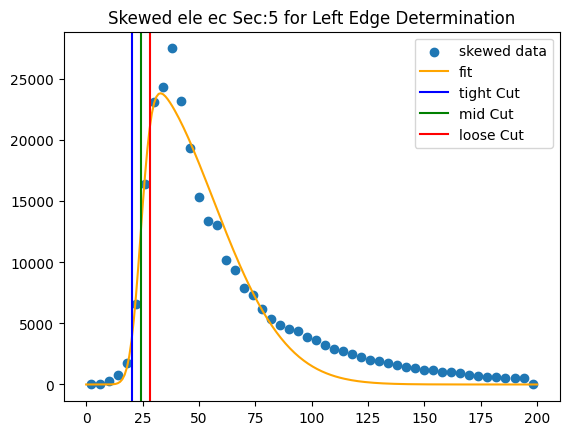

[1.17079301e+01 2.46134424e+01 6.30400904e+01 3.09250144e+05]


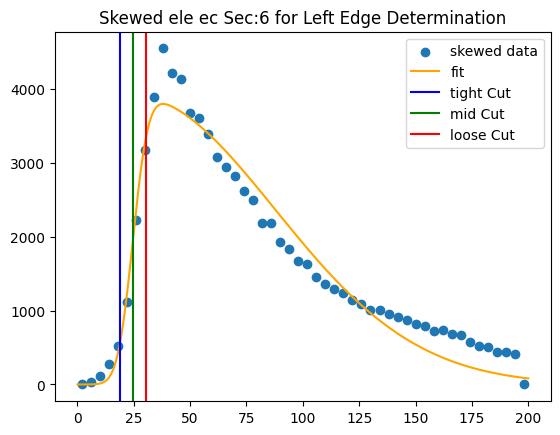

[1.13095654e+00 2.32729143e+02 1.07599075e+02 1.46688240e+06]


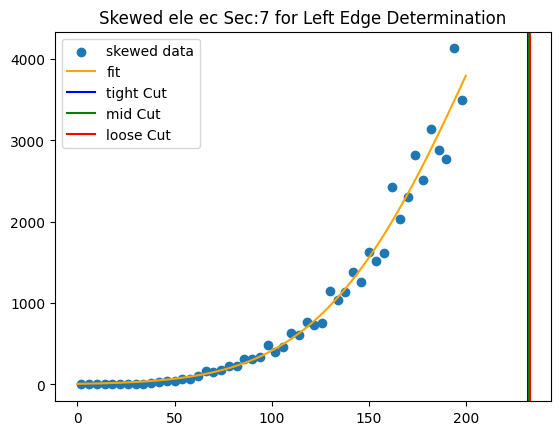

In [72]:
left_edge = np.zeros((7,3))

ini_par = [6.23,41,54,120000000]


for sec in range(7):
    mod_xvals = Bounds_on_Y(xvals,0.0,198)
    mod_zvals = Bounds_on_X_From_Y(proj_xl[sec][0],xvals,0.0,198)
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(0.0,200,200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(skew_norm,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,skew_norm(cont_x,*pars),label="fit",color='orange')
        print(pars)
        for i in range(3):
            left_edge[sec][i] = pars[1]+fit_adjust[i]*pars[0]
        #left_edge[sec][2] = pars[1]-
        #left_edge[sec][1] = pars[1]+0.8*pars[0]
        #left_edge[sec][0] = pars[1]+1.6*pars[0]
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    for cut in range(3):
        plt.axvline(x=left_edge[sec][cut],label="{} Cut".format(cut_name[cut]),color=color_order[cut])
    plt.title("Skewed "+species+" "+detector+" Sec:{} for Left Edge Determination".format(sec+1))
    plt.legend()
    plt.show()

In [73]:
def exp_off(x_, a_, mu_,d_):
    return a_*np.exp(-(x_-mu_)/d_)

def exp_off_edge(comp_,frac_, a_, mu_, d_):
    return -d_*(math.log(frac_)-((comp_-mu_)/d_)-(mu_/d_))

[4082.81679779  340.92053499    7.3622225 ]


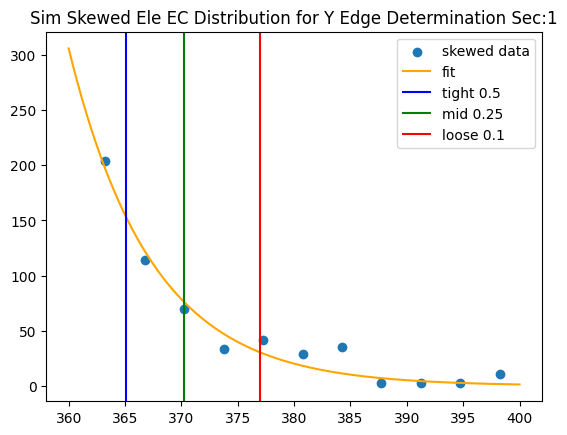

[9.27955133e+03 3.34898976e+02 7.33812723e+00]


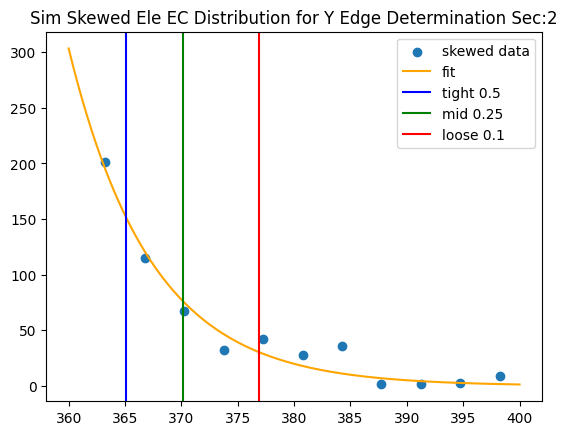

[8.29974722e+03 3.34516923e+02 7.69778049e+00]


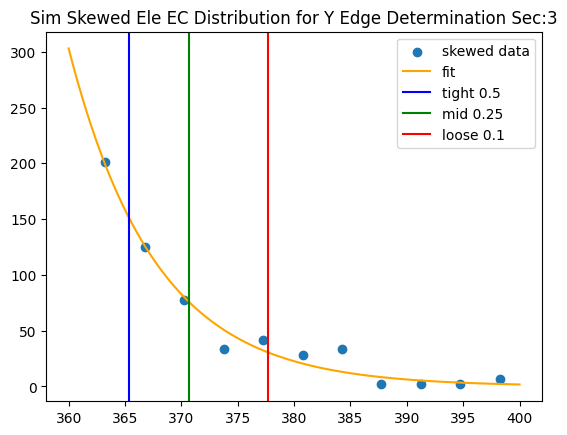

[6220.1233814   336.82830454    7.39634983]


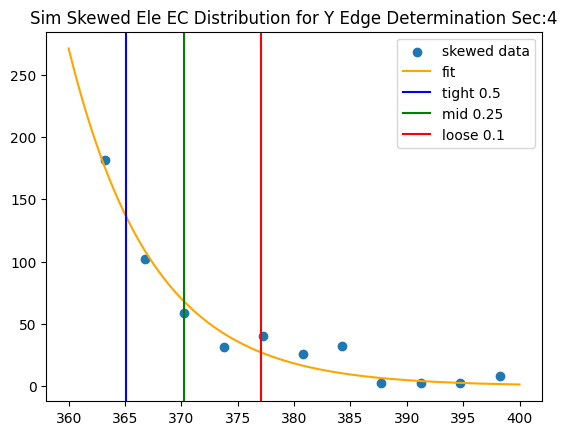

[4428.38645354  339.27798232    7.97093636]


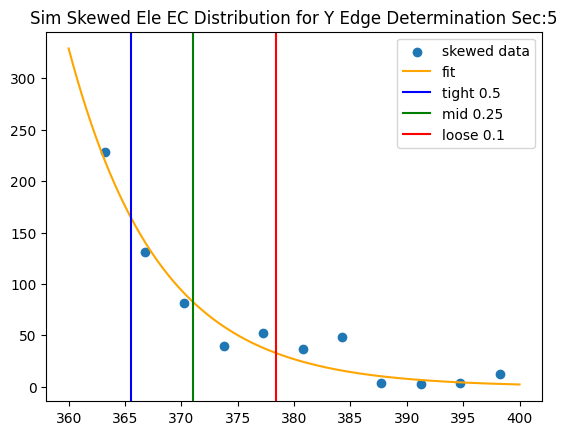

[8.73514746e+03 3.34679564e+02 7.47623544e+00]


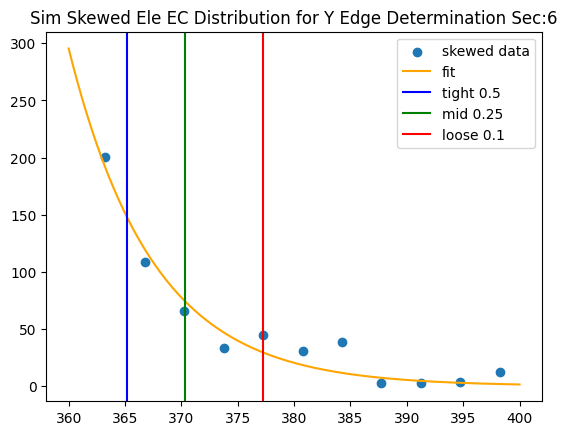

[1.41153199e+04 3.44471574e+02 7.55305107e+00]


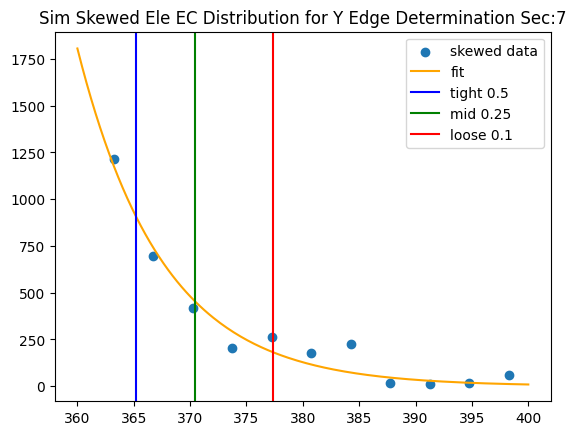

In [74]:
y_edge = np.zeros((7,3))

ini_par = [1359.29693959,  184.29431595,   43.19563841]

bou_y = [360.0,400.0]

comp_x = 360.0

frac_y = [0.5,0.25,0.1]

for sec in range(7):
    mod_xvals = Bounds_on_Y(yvals,bou_y[0],bou_y[1])
    mod_zvals = Bounds_on_X_From_Y(proj_y[sec][0],yvals,bou_y[0],bou_y[1])
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(bou_y[0],bou_y[1],200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(exp_off,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,exp_off(cont_x,*pars),label="fit",color='orange')
        print(pars)
        for cut in range(3):
            y_edge[sec][cut] = exp_off_edge(comp_x,frac_y[cut],*pars)
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    for cut in range(3):
        plt.axvline(x=y_edge[sec][cut],label="{} {}".format(cut_name[cut],frac_y[cut]),color=color_order[cut])
    plt.title("Sim Skewed Ele EC Distribution for Y Edge Determination Sec:{}".format(sec+1))
    plt.legend()
    plt.show()

In [75]:
sec5_cut = False
#Additional Cut on Sector 5 Needed
#manually adjusted
if sec5_cut:
    vert_cuts = [[105,127],[107,125],[109,123]]
    sec = 4
    bou = [100,140]
    mod_xvals = Bounds_on_Y(xvals,bou[0],bou[1])
    mod_zvals = Bounds_on_X_From_Y(proj_xl[sec][0],xvals,bou[0],bou[1])
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    for cut in range(3):
        plt.axvline(x=vert_cuts[cut][0],color=color_order[cut],label="{} Cut".format(cut_name[cut]))
        plt.axvline(x=vert_cuts[cut][1],color=color_order[cut])
    plt.title(species+" "+detector+" Sec:{} Additional Geometric Cut".format(sec+1))
    plt.xlabel("Skewed Left X Position (sector centered)")
    plt.ylabel("Y Position (sector centered)")
    plt.legend()
    plt.show()


    print(right_rot[sec],(3**(1/2)))
    sec_5_cuts = [[[vert_cuts[cut][0]*(-left_rot[sec]),left_rot[sec]],[vert_cuts[cut][1]*(-left_rot[sec]),left_rot[sec]]] for cut in range(3)]




[[[43.7449158385386, 2.3068855314948458], [54.9282576353611, 2.3068855314948458], [66.1115994321836, 2.3068855314948458]], [[42.10970339772787, 2.3454180202135144], [53.90621884496965, 2.3454180202135144], [65.70273429221143, 2.3454180202135144]], [[35.44864597509572, 2.336455215423526], [49.92264573828572, 2.336455215423526], [64.39664550147572, 2.336455215423526]], [[37.82512850927521, 2.2916383170555052], [51.80767842399088, 2.2916383170555052], [65.79022833870656, 2.2916383170555052]], [[48.109140062592786, 2.2899942744870514], [56.56179607576695, 2.2899942744870514], [65.01445208894111, 2.2899942744870514]], [[38.70787367698907, 2.3549979951670763], [51.478046094160995, 2.3549979951670763], [64.24821851133292, 2.3549979951670763]], [[54.827343256237455, 1.7320508075688772], [65.97463056177473, 1.7320508075688772], [77.121917867312, 1.7320508075688772]]]
[[43.7449158385386, 2.3068855314948458], [54.9282576353611, 2.3068855314948458], [66.1115994321836, 2.3068855314948458]]


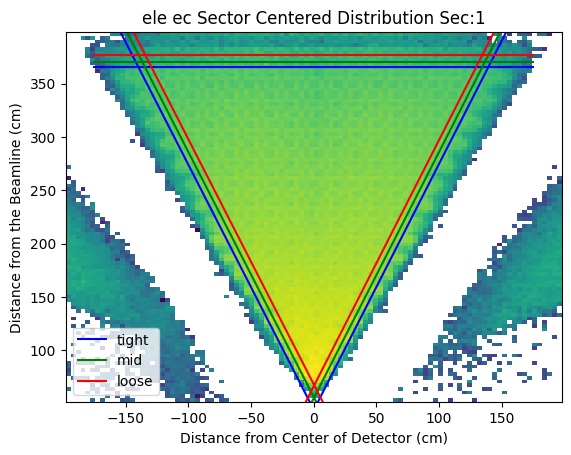

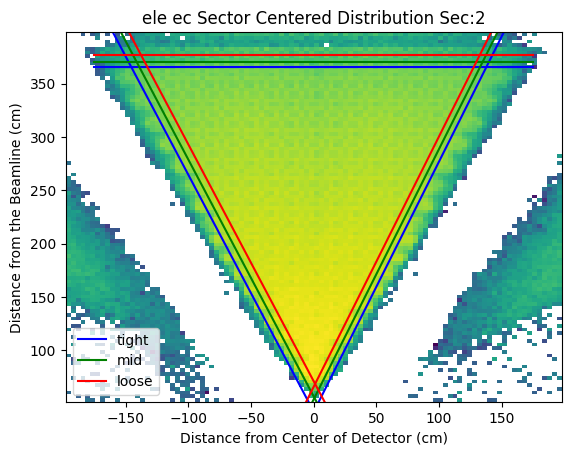

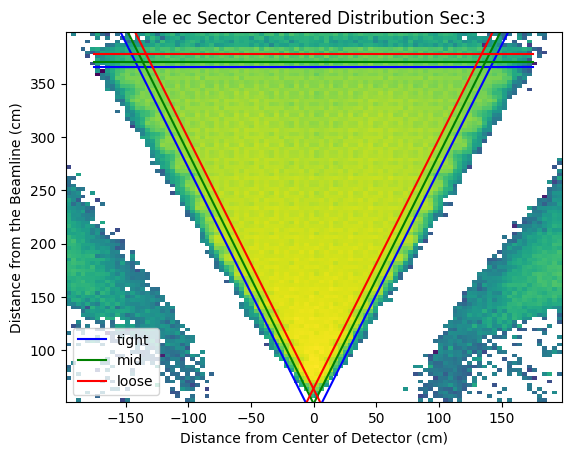

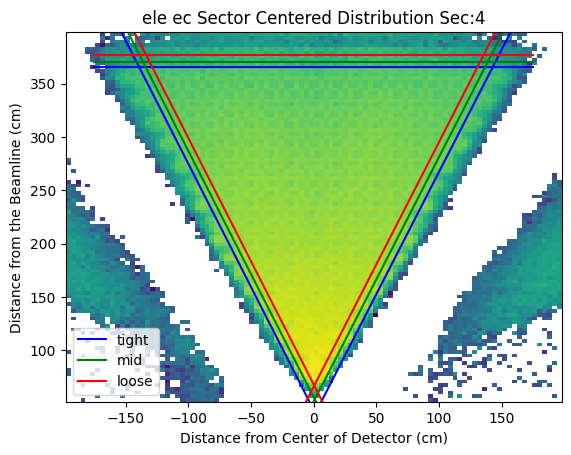

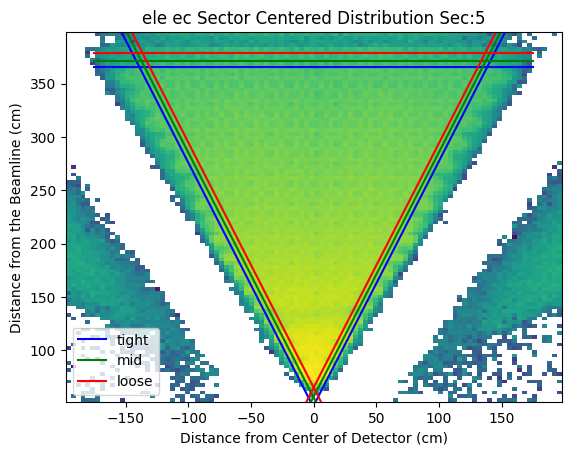

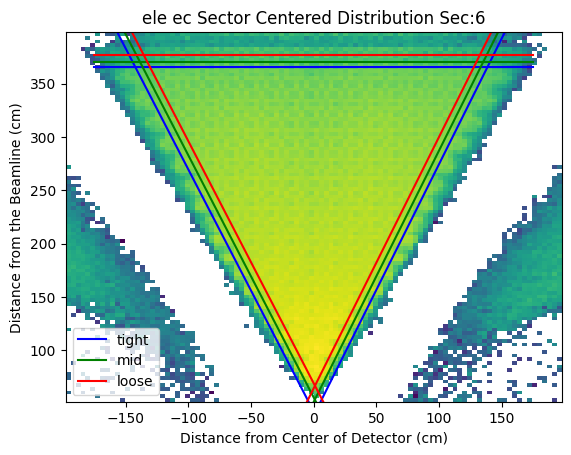

In [76]:
right_cut_pars = [[[-right_edge[i][cut]*right_rot[i],right_rot[i]] for cut in range(3)] for i in range(7)]
left_cut_pars = [[[left_edge[i][cut]*(-1*left_rot[i]),left_rot[i]] for cut in range(3)] for i in range(7)]

print(right_cut_pars)
print(right_cut_pars[0])

cont_x_r = np.linspace(-20.0,175.,200)
cont_x_l = np.linspace(-175.0,20.,200)
cont_x_l2 = np.linspace(-100.0,50.,200)

for sec in range(6):
    plt.hist2d(dumb1_x[sec][cut_hist_len-1], dumb1_y[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    for cut in range(3):
        plt.plot(cont_x_r,Poly(cont_x_r,right_cut_pars[sec][cut]),label=cut_name[cut],color=color_order[cut])
        plt.plot(cont_x_l,Poly(cont_x_l,left_cut_pars[sec][cut]),color=color_order[cut])
        plt.plot([-175,175],[y_edge[sec][cut],y_edge[sec][cut]],color=color_order[cut])
        if sec5_cut:
            if sec == 4:
                plt.plot(cont_x_l2,Poly(cont_x_l2,sec_5_cuts[cut][0]),color=color_order[cut])
                plt.plot(cont_x_l2,Poly(cont_x_l2,sec_5_cuts[cut][1]),color=color_order[cut])
    plt.title(species+" "+detector+" Sector Centered Distribution Sec:{}".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.legend()
    plt.show()

In [77]:
one_line = True
print("Cut Parameters for "+species+" "+detector+" Geometric Cut")
print("side_cut_par[sec][{tight,mid,loose}][right,left][intercept,slope]")

for sec in range(6):
    for cut in range(3):
        if cut == 0:
            if sec ==0:
                if one_line:
                    print("{{{{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],end="}},")
                else:
                    print("{\t{\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")
            else:
                if one_line:
                    print("{{{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],end="}},")
                else:
                    print("\t{\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")
        elif cut==2:
            if sec == 5:
                if one_line:
                    print("{{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],end="}}}}")
                else:
                    print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}}}}")
            else:
                if one_line:
                    print("{{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],end="}}},")
                else:
                    print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}}},")
        else:
            if one_line:
                print("{{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],end="}},")
            else:
                print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")

        
        

Cut Parameters for ele ec Geometric Cut
side_cut_par[sec][{tight,mid,loose}][right,left][intercept,slope]
{{{{ 43.7449158385386 , 2.3068855314948458 },{ 44.412756837910116 , -2.2945772045191966}},{{ 54.9282576353611 , 2.3068855314948458 },{ 56.341880844043665 , -2.2945772045191966}},{{ 66.1115994321836 , 2.3068855314948458 },{ 68.27100485017722 , -2.2945772045191966}}},{{{ 42.10970339772787 , 2.3454180202135144 },{ 42.54825961458215 , -2.2183582974022116}},{{ 53.90621884496965 , 2.3454180202135144 },{ 56.786709526216505 , -2.2183582974022116}},{{ 65.70273429221143 , 2.3454180202135144 },{ 71.02515943785086 , -2.2183582974022116}}},{{{ 35.44864597509572 , 2.336455215423526 },{ 36.158156906895506 , -2.348315530326925}},{{ 49.92264573828572 , 2.336455215423526 },{ 49.85780982223981 , -2.348315530326925}},{{ 64.39664550147572 , 2.336455215423526 },{ 63.55746273758412 , -2.348315530326925}}},{{{ 37.82512850927521 , 2.2916383170555052 },{ 43.93793582579728 , -2.3075526609690034}},{{ 51.80767

In [78]:


for sec in range(6):
    for cut in range(3):
        if cut==0:
            if sec ==0:
                if one_line:
                    print("\t{{",y_edge[sec][cut],end=",")
                else:
                    print("\t{{",y_edge[sec][cut],end=",")
            else:
                if one_line:
                    print("{",y_edge[sec][cut],end=",")
                else:
                    print("\t\t{",y_edge[sec][cut],end=",")
        else:
            if cut==2:
                if sec ==5:
                    if one_line:
                        print(y_edge[sec][cut],end="}}")
                    else:
                        print(y_edge[sec][cut],"}}")
                else:
                    if one_line:
                        print(y_edge[sec][cut],end="},")
                    else:
                        print(y_edge[sec][cut],"},")
            else:
                if one_line:
                    print(y_edge[sec][cut],end=",")
                else:
                    print(y_edge[sec][cut],end=",")

	{{ 365.1031037694504,370.2062075389008,376.9521437828629},{ 365.0864022010628,370.1728044021257,376.89666237360746},{ 365.3356948442721,370.6713896885442,377.72479460893317},{ 365.1267590326597,370.2535180653195,377.03072486631},{ 365.52503206380936,371.0500641276187,378.35375923792185},{ 365.18213151637883,370.3642630327578,377.21466827566024}}

In [27]:
print("Sector 5 efficiency cut")
print("[tight,mid,loose][bot,top][intercept,slope]")
for cut in range(3):
    if cut==0:
        print("{\t{\t{",sec_5_cuts[cut][0][0],",",sec_5_cuts[cut][0][1],"},{",sec_5_cuts[cut][1][0],",",sec_5_cuts[cut][1][1],"}},")

    elif cut==2:
        print("\t{\t{",sec_5_cuts[cut][0][0],",",sec_5_cuts[cut][0][1],"},{",sec_5_cuts[cut][1][0],",",sec_5_cuts[cut][1][1],"}}}")
    else:
        print("\t{\t{",sec_5_cuts[cut][0][0],",",sec_5_cuts[cut][0][1],"},{",sec_5_cuts[cut][1][0],",",sec_5_cuts[cut][1][1],"}},")
    
    

Sector 5 efficiency cut
[tight,mid,loose][bot,top][intercept,slope]


NameError: name 'sec_5_cuts' is not defined